# ALTA-2025 shared task.


[Task page](https://www.alta.asn.au/events/sharedtask2025/)


[Codabench - team: NoviceTrio](https://www.codabench.org/competitions/9717/#/results-tab)



# one time process

## generate (batch) description of meddra (Spartan GPU)

In [ ]:
##### Use medgemma to generate (batch) description of meddra



import os, torch, pandas as pd
from tqdm import tqdm
from unsloth import FastModel  # Unsloth's high‑level wrappers





MODEL_NAME = "../medgemma-27b-text-it-unsloth-bnb-4bit"          # HF hub name
model, tokenizer = FastModel.from_pretrained(
    MODEL_NAME,
    load_in_4bit      = True,               # Q4_K_M quantisation
    device_map        = "auto",             # spread across GPUs if available
    trust_remote_code = True,               # Gemma uses custom generation config
    max_seq_length = 250,
    #use_fast=True
)
model.eval()




import gc
gc.collect()


def flush():
    gc.collect()
    torch.cuda.empty_cache()
    torch.cuda.reset_peak_memory_stats()

flush()







del_lst = ["<end_of_turn>", "<eos>", " <bos>"]


def del_trash(st):
    for t in del_lst:
        st = st.replace(t,"")
    return st.strip()

def get_batch_prediction(phrases):
    # Build the phrase list dynamically
    phrase_list = "\n".join([f"{i+1}. {p}" for i, p in enumerate(phrases)])

    # Few-shot examples
    examples = (
        "Example:\n"
        "1. Hypertension: Persistently high blood pressure.\n"
        "2. Migraine: Recurrent severe headache often with nausea or light sensitivity.\n"
        "3. Asthma: Chronic airway inflammation causing wheezing and breathlessness.\n\n"
    )

    # Prompt
    prompt = (
        "<start_of_turn>user\n"
        "You are a helpful medical assistant.\n"
        "For each of the following MedDRA phrases, provide a one-line short description.\n"
        "Keep each answer concise (max 12–15 words) and medically accurate.\n\n"
        f"{examples}"
        f"Now answer for these phrases:\n{phrase_list}\n\n"
        "Format strictly as:\n"
        "1. phrase: description\n"
        "2. phrase: description\n"
        "... and so on.\n"
        "<end_of_turn>\n"
        "<start_of_turn>model\n"
    )

    # Tokenize + generate
    inputs = tokenizer(prompt, return_tensors="pt").to("cuda")
    outputs = model.generate(
        **inputs,
        max_new_tokens=2000,  # allow space for 50 outputs
        temperature=0.7,
        top_k=50,
        top_p=0.9
    )

    decoded = tokenizer.decode(outputs[0], skip_special_tokens=False)

    # Extract only the model’s response after `<start_of_turn>model`
    if "<start_of_turn>model" in decoded:
        decoded = decoded.split("<start_of_turn>model", 1)[1]
    if "<end_of_turn>" in decoded:
        decoded = decoded.split("<end_of_turn>", 1)[0]

    return decoded.strip()



'''phrases = [
    "Haematochezia",
    "Insomnia",
    "Anxiety",
    "Diabetes mellitus",
    "Chronic kidney disease",
]

batch_descriptions = get_batch_prediction(phrases)
print(batch_descriptions)


exit()'''

import json

hm = eval(open("meddra.json", "r").read())
all_ph= []

for h in hm:
    all_ph.extend(hm[h])

import re

def run_all_batches(all_ph, batch_size=50, outfile="meddra_descriptions_1.txt"):
    results = []

    # process in chunks
    for i in range(0, len(all_ph), batch_size):
        batch = all_ph[i:i+batch_size]
        print(f"Running batch {i//batch_size + 1} with {len(batch)} phrases...")
        output = get_batch_prediction(batch)

        # Keep only lines starting with "number."
        clean_lines = []
        for line in output.splitlines():
            if re.match(r"^\s*\d+\.", line):  # matches "1.", "23.", etc.
                clean_lines.append(line.strip())

        results.extend(clean_lines)
        print(clean_lines)
        # Save progress incrementally
        with open(outfile, "a", encoding="utf-8") as f:
            f.write("\n".join(clean_lines) + "\n")

    return results


# Example usage:
# all_ph = ["Hypertension", "Asthma", "Diabetes", ...]  # your full phrase list
results = run_all_batches(all_ph, batch_size=50, outfile="meddra_descriptions_1.txt")



## generate description of medical condition phrase in context of the document

In [ ]:
##### Use medgemma to generate description of medical condition phrase in context of the document




import os, torch, pandas as pd
from tqdm import tqdm
from unsloth import FastModel  # Unsloth's high‑level wrappers





MODEL_NAME = "../medgemma-27b-text-it-unsloth-bnb-4bit"          # HF hub name
model, tokenizer = FastModel.from_pretrained(
    MODEL_NAME,
    load_in_4bit      = True,               # Q4_K_M quantisation
    device_map        = "auto",             # spread across GPUs if available
    trust_remote_code = True,               # Gemma uses custom generation config
    max_seq_length = 1024,
    #use_fast=True
)
model.eval()




import gc
gc.collect()


def flush():
    gc.collect()
    torch.cuda.empty_cache()
    torch.cuda.reset_peak_memory_stats()

flush()







del_lst = ["<end_of_turn>", "<eos>", " <bos>"]


def del_trash(st):
    for t in del_lst:
        st = st.replace(t,"")
    return st.strip()



def get_prediction1(phrase, document):
    # Prompt
    prompt = (
        "<start_of_turn>user\n"
        "You are a helpful medical assistant.\n"
        f"Read the following document and provide a short, medically accurate one-line description "
        f"for the phrase '{phrase}' in the context of this document.\n"
        f"Document: {document}\n"
        "Description:"
        "<end_of_turn>\n"
        "<start_of_turn>model\n"
    )

    # Tokenize + generate (stream to console)
    inputs = tokenizer(prompt, return_tensors="pt").to("cuda")

    outputs = model.generate(**inputs, max_new_tokens=128, temperature=1.0, top_k=64, top_p=0.95)
    decoded = tokenizer.decode(outputs[0], skip_special_tokens=True).replace(prompt,"")
    return decoded.split("\nmodel\n")[1]






import json

lst = open("output_test.json", "r").readlines()

lst = [eval(l) for l in lst]

out = open("output_test_out1.json", "w")

for t in lst:
  pr = get_prediction1(t["text"].replace("\n"," "), t["document"].replace("\n"," "))
  t["description2"] = pr
  out.write(json.dumps(t) + '\n')

out.close()





## Train the medgemma model to predict the meddra phrase (Spartan gpu)

In [ ]:
#### Train the medgemma model to predict the meddra phrase

import argparse, json
import pandas as pd
from datasets import Dataset
from unsloth import FastModel
from trl import SFTTrainer, SFTConfig


# Prompt construction
def build_dataset(json_path):
    records = []
    with open(json_path, "r", encoding="utf-8") as f:
        first = f.read(1); f.seek(0)
        if first == "[":
            data = json.load(f)
        else:
            data = [json.loads(line) for line in f if line.strip()]

    for rec in data:
        doc = rec.get("document", "").replace("\n"," ")
        phrase = rec.get("text", "")
        target = next(iter(rec.get("target", "").values()))
        #print(target, end="\r")
        prompt = (
            "<start_of_turn>user\n"
            "You are a helpful medical assistant.\n"
            f"Which top 10 meddra phrase best match with, '{phrase}' \n"
            f"In the context of the following document, \n{doc} \n"
            "Only return those meddra phrases."
            "<end_of_turn>\n"
            "<start_of_turn>model\n"
        )

        if isinstance(target, list):
            response = "\n".join(target)
        else:
            response = str(target)

        # Add <end_of_turn> marker
        response += "\n<end_of_turn>\n"

        full_text = prompt + response
        records.append({"id": rec.get("id", None), "text": full_text })

    df = pd.DataFrame(records)
    return Dataset.from_pandas(df)


# Main training function
def main(args):
    max_seq_length = 1024
    load_in_4bit = True

    print("Loading dataset...")
    dataset = build_dataset(args.data)
    print(f"Loaded {len(dataset)} training samples.")
    print(dataset)
    print("Loading model...")
    model, tokenizer = FastModel.from_pretrained(
        model_name=args.base_model,   # base or checkpoint
        max_seq_length=max_seq_length,
        load_in_4bit=load_in_4bit,
        load_in_8bit=False,
        full_finetuning=False,
        # token="hf_..."   # use if gated model
    )

    print("Attaching LoRA adapters...")
    model = FastModel.get_peft_model(
        model,
        finetune_vision_layers=False,
        finetune_language_layers=True,
        finetune_attention_modules=True,
        finetune_mlp_modules=True,
        r=8,
        lora_alpha=8,
        lora_dropout=0,
        bias="none",
        random_state=3407,
    )


    print("Starting training...")
    trainer = SFTTrainer(
        model=model,
        tokenizer=tokenizer,
        train_dataset=dataset,
        max_seq_length=max_seq_length,
        args=SFTConfig(
            dataset_text_field="text",
            per_device_train_batch_size=2,
            gradient_accumulation_steps=4,
            warmup_steps=5,
            num_train_epochs=args.epochs,
            learning_rate=2e-4,
            logging_steps=100,
            save_strategy="steps",
            save_steps=1000,
            save_total_limit=1,
            optim="adamw_8bit",
            weight_decay=0.01,
            lr_scheduler_type="linear",
            seed=3407,
            report_to="none",
            output_dir=args.output,
            dataset_num_proc=2,
        ),
    )

    trainer_stats = trainer.train()

    print("Saving model...")
    model.save_pretrained(args.output)
    tokenizer.save_pretrained(args.output)
    print(f"Model saved to {args.output}")



import json

# Input files
file1 = "output_train_out1.json"
file2 = "output_dev_out1.json"
outfile = "merged_out.json"

# Read both files
with open(file1, "r", encoding="utf-8") as f1, open(file2, "r", encoding="utf-8") as f2:
    text1 = f1.read()
    text2 = f2.read()

# Combine (with a newline in between)
combined = text1.strip() + "\n" + text2.strip()
combined = combined.replace("\n\n","\n")

# Save to new file
with open(outfile, "w", encoding="utf-8") as f:
    f.write(combined)

print(f"Files merged into {outfile}")



if __name__ == "__main__":
    parser = argparse.ArgumentParser()
    parser.add_argument("--data", type=str, default="merged_out.json", help="Path to training JSON")
    parser.add_argument("--base_model", type=str, default="../medgemma-27b-text-it-unsloth-bnb-4bit", help="Hugging Face model id or local path")
    parser.add_argument("--output", type=str, default="./out_lora", help="Where to save LoRA adapters")
    parser.add_argument("--epochs", type=int, default=5)
    args = parser.parse_args()
    main(args)




"""
run_inference.py
Usage:
  python run_inference.py --data ./data/test.json --model_dir ./out_lora --output ./predictions.json
"""




# test data conversion

In [ ]:
### data provided in json file need to convert in half output format which has, id, document, text

import json


################## Put input file here
input_file = "/content/hidden_test_no_label.json"   # your input file (one JSON per line)
#######################################


output_file = "output_test.json" # new file with flattened mentions

results = []

with open(input_file, "r", encoding="utf-8") as f:
    for line in f:
        line = line.strip()
        if not line:
            continue
        data = json.loads(line)
        doc_id = data["doc_id"]
        text = data["text"]
        mentions = data.get("mentions", [])

        for i, mention in enumerate(mentions):
            new_obj = {
                "id": f"{doc_id}-{i}",
                "document": text,
                "text": mention["text"]
            }
            results.append(new_obj)

# Save results back to file
with open(output_file, "w", encoding="utf-8") as f:
    for obj in results:
        f.write(json.dumps(obj, ensure_ascii=False) + "\n")

print(f"Processed {len(results)} mentions into {output_file}")






Processed 4200 mentions into output_train.json


# Run description generation using medgemma on test set (description2) (spartan)

In [ ]:
### python medgemma.py &



import os, torch, pandas as pd
from tqdm import tqdm
from unsloth import FastModel  # Unsloth's high‑level wrappers





MODEL_NAME = "../medgemma-27b-text-it-unsloth-bnb-4bit"          # HF hub name
model, tokenizer = FastModel.from_pretrained(
    MODEL_NAME,
    load_in_4bit      = True,               # Q4_K_M quantisation
    device_map        = "auto",             # spread across GPUs if available
    trust_remote_code = True,               # Gemma uses custom generation config
    max_seq_length = 1024,
    #use_fast=True
)
model.eval()




import gc
gc.collect()


def flush():
    gc.collect()
    torch.cuda.empty_cache()
    torch.cuda.reset_peak_memory_stats()

flush()







del_lst = ["<end_of_turn>", "<eos>", " <bos>"]


def del_trash(st):
    for t in del_lst:
        st = st.replace(t,"")
    return st.strip()



def get_prediction1(phrase, document):
    # Prompt
    prompt = (
        "<start_of_turn>user\n"
        "You are a helpful medical assistant.\n"
        f"Read the following document and provide a short, medically accurate one-line description "
        f"for the phrase '{phrase}' in the context of this document.\n"
        f"Document: {document}\n"
        "Description:"
        "<end_of_turn>\n"
        "<start_of_turn>model\n"
    )

    # Tokenize + generate (stream to console)
    inputs = tokenizer(prompt, return_tensors="pt").to("cuda")

    outputs = model.generate(**inputs, max_new_tokens=128, temperature=1.0, top_k=64, top_p=0.95)
    decoded = tokenizer.decode(outputs[0], skip_special_tokens=True).replace(prompt,"")
    return decoded.split("\nmodel\n")[1]




import json

lst = open("output_test.json", "r").readlines()

lst = [eval(l) for l in lst]

out = open("output_test_out2.json", "w")

for t in lst:
  pr = get_prediction1(t["text"].replace("\n"," "), t["document"].replace("\n"," "))
  t["description2"] = pr#.split("\nmodel\n")[1]
  out.write(json.dumps(t) + '\n')

out.close()





In [ ]:
#### Description match (run with gpu in local)




file1 = "meddra_descriptions.txt"
file2 = "meddra_descriptions_1.txt"
outfile = "meddra_descriptions_.txt"

with open(file1, "r", encoding="utf-8") as f1, \
     open(file2, "r", encoding="utf-8") as f2, \
     open(outfile, "w", encoding="utf-8") as out:

    # Read and write file1
    out.write(f1.read().strip() + "\n")
    # Read and write file2
    out.write(f2.read().strip() + "\n")



import re
import json


phrases_dict = {}

# File paths (can be passed as args or hardcoded)
import json
# Load MedDRA dictionary
with open('meddra.json', 'r') as f:
    meddra = json.load(f)

print(len(meddra))

meddra_={}
for h in meddra:
    for t in meddra[h]:
        meddra_[t]=h

print(len(meddra_))


lst = []

for h in meddra_:
    lst.append(h)

import difflib

def closest_phrase(query, phrase_list):
    matches = difflib.get_close_matches(query, phrase_list, n=1, cutoff=0.0)
    return matches[0] if matches else None


with open(outfile, "r", encoding="utf-8") as f:
    for line in f:
        line = line.strip()
        if not line:
            continue
        # Match pattern like "40. Scorpion sting: description"
        match = re.match(r"^\s*\d+\.\s*(.+?):\s*(.+)$", line)
        if match:
            key = match.group(1).strip()
            value = match.group(2).strip()
            if key in meddra_:
                phrases_dict[key] = value
            elif key+"." in meddra_:
                phrases_dict[key+"."] = value
            elif line[line.index(". ")+2:].strip()[:line[line.index(". ")+2:].strip().rindex(":")] in meddra_:
                phrases_dict[line[line.index(". ")+2:].strip()[:line[line.index(". ")+2:].strip().rindex(":")]] = line[line.index(". ")+2:].strip()[line[line.index(". ")+2:].strip().rindex(":")+1:]
            else:
                print(line,"*")
                mt = closest_phrase(key, lst)
                if mt not in phrases_dict:
                    phrases_dict[mt] = line

print(len(phrases_dict))

import json
from sentence_transformers import SentenceTransformer, util


# Load biomedical sentence transformer
model = SentenceTransformer("./all-MiniLM-L6-v2")


# Main Function
def add_semantic_matches(lins, phrases_dict, meddra_dict, top_n=30, out_file="output_test_out3.json"):
    # Precompute embeddings for dictionary descriptions
    dict_phrases = list(phrases_dict.keys())
    dict_descriptions = list(phrases_dict.values())
    dict_embeddings = model.encode(dict_descriptions, convert_to_tensor=True)

    updated = []
    ct = 0
    for entry in lins:
        #print(ct)
        ct+=1
        desc = entry.get("description2", "").strip()
        tx = entry.get("text", "")
        if not desc:
            print("NO DESCRIPTION")
            entry["meddra_id_DES"] = []
            entry["method_DES"] = "DESCRIPTION_SIMILARITY"
            updated.append(entry)
            continue

        # Encode description2
        query_emb = model.encode(desc, convert_to_tensor=True)

        # Compute cosine similarity with all dictionary embeddings
        cosine_scores = util.cos_sim(query_emb, dict_embeddings)[0]

        # Get top N matches
        top_results = cosine_scores.topk(k=top_n)

        matches = []
        for idx, score in zip(top_results.indices, top_results.values):
            phrase = dict_phrases[idx]
            print(tx, "=====",phrase)
            phrase_id = meddra_dict[phrase]  # get MedDRA id
            matches.append(phrase_id)
            #matches.append({
            #    "id": phrase_id,
            #    "score": float(score)
            #})

        entry["meddra_id_DES"] = matches
        entry["method_DES"] = "DESCRIPTION_SIMILARITY"
        updated.append(entry)

    # Write to new JSON file
    with open(out_file, "w", encoding="utf-8") as f:
        for row in updated:
            f.write(json.dumps(row) + "\n")

    return updated






# Example usage
if __name__ == "__main__":
    # Load your data
    lins = open("output_test_out2.json", "r").readlines()
    lins = [eval(l) for l in lins]   # careful: safer to use json.loads if valid JSON

    output = add_semantic_matches(lins, phrases_dict, meddra_, top_n=30, out_file="output_test_out3.json")
    print("✅ New file written: output_with_similarity.json")
    print(json.dumps(output[0], indent=2))  # show first result

74359
75605
11. Stunting: Impaired growth and development resulting in short stature. *
44. Sialadenitis NOS: Inflammation of a salivary gland, type not otherwise specified. *
49. Leukaemic reticuloendotheliosis involving lymph nodes of inguinal region and lower limb: Rare lymphoma affecting lymph nodes in the groin or lower limb. *
11. Other viral diseases of mother, complicating pregnancy, childbirth, or the puerperium: Unspecified viral infection during or shortly after pregnancy/childbirth. *
36. Trip preg with fetal loss and retention of one or more fetus, deliv, with or w/o ment of antepart cond: Triplet pregnancy with fetal loss, delivery occurred. *


KeyboardInterrupt: 

# Run the medgemma finetuned model on this (spartan)

In [ ]:
#### LLM fine tune model test     python test_alta1.py &

import argparse, json
from tqdm import tqdm
from datasets import Dataset
from transformers import TextStreamer
import unsloth

def build_prompts(json_path):
    data = []
    with open(json_path, "r", encoding="utf-8") as f:
        first = f.read(1); f.seek(0)
        if first == "[":
            records = json.load(f)
        else:
            records = [json.loads(line) for line in f if line.strip()]
    for rec in records:
        doc = rec.get("document", "").replace("\n"," ")
        phrase = rec.get("text", "")
        target = rec.get("target", "")
        prompt = (
            "<start_of_turn>user\n"
            "You are a helpful medical assistant.\n"
            f"Which top 10 meddra phrase best match with, '{phrase}' \n"
            f"In the context of the following document, \n{doc} \n"
            "Only return those meddra phrases."
            "<end_of_turn>\n"
            "<start_of_turn>model\n"
        )
        data.append({"id": rec.get("id", None), "prompt": prompt, "text": phrase})
    return data

def main(args):
    from unsloth import FastModel
    import torch

    # Load model
    print(f"Loading model from {args.model_dir}...")
    model, tokenizer = FastModel.from_pretrained(
        model_name=args.model_dir,
        max_seq_length=1024,
        dtype=torch.bfloat16,
        load_in_4bit=True,   # use False if you merged LoRA into full model
    )
    model = FastModel.for_inference(model)

    # Prepare test data
    examples = build_prompts(args.data)

    predictions = []
    for ex in tqdm(examples, desc="Generating"):
        inputs = tokenizer([ex["prompt"]], return_tensors="pt").to(model.device)
        with torch.no_grad():
            output = model.generate(
                **inputs,
                max_new_tokens=128,
                do_sample=False,  # greedy for deterministic output
            )
        pred = tokenizer.decode(output[0][inputs["input_ids"].shape[1]:], skip_special_tokens=True)
        predictions.append({"id": ex["id"], "prediction": pred.strip(),  "text": ex["text"]})

    # Save predictions
    with open(args.output, "w", encoding="utf-8") as f:
        json.dump(predictions, f, indent=2, ensure_ascii=False)
    print(f"Predictions saved to {args.output}")

if __name__ == "__main__":
    parser = argparse.ArgumentParser()
    parser.add_argument("--data", type=str, default="output_test.json", help="Test JSON file path")
    parser.add_argument("--model_dir", type=str, default="./out_lora", help="Fine-tuned model directory")
    parser.add_argument("--output", type=str, default="./predictions_test.json", help="Where to save predictions")
    args = parser.parse_args()
    main(args)




In [ ]:
##### Update output_test_out3 with llm fine tune result


lins = open("output_test_out3.json", "r").readlines()
lins = [eval(l) for l in lins]

lst = eval(open("predictions_test.json", "r").read())
hm = {}
for l in lst:
  hm[l["id"]] = l["prediction"]

for i in range(len(lins)):
  lins[i]["prediction_llm_ft"] = hm[lins[i]["id"]]
  #lins[i]["description2"] = lins[i]["description2"][lins[i]["description2"].index("\nmodel\n")+7:]

out = open("output_test_out4.json", "w")

for t in lins:
  out.write(json.dumps(t) + '\n')

out.close()

In [ ]:
### keep the meddra id

# File paths (can be passed as args or hardcoded)
import json
# Load MedDRA dictionary
with open('meddra.json', 'r') as f:
    meddra = json.load(f)

print(len(meddra))

meddra_={}
lt = []
for h in meddra:
    for t in meddra[h]:
        meddra_[t]=h
        lt.append(t)

print(len(meddra_))

lst = open("output_test_out4.json", "r").readlines()
lst = [eval(l) for l in lst]


import nltk
from nltk.stem import PorterStemmer

# make sure you have nltk resources
# nltk.download("punkt")

stemmer = PorterStemmer()

# Example dictionary: phrase -> id
phrase_dict = meddra_

# Dictionaries for output
set_dict = {}
list_dict = {}

for phrase, pid in phrase_dict.items():
    # tokenize into words
    words = phrase.split()
    # lowercase + stem
    stems = [stemmer.stem(w.lower()) for w in words]
    joined = " ".join(stems)

    # fill dictionaries
    if frozenset(stems) not in set_dict:
      set_dict[frozenset(stems)] = [pid]    # set version
    else:
      set_dict[frozenset(stems)].append(pid)

    if joined.strip() not in list_dict:
      list_dict[joined.strip()] = [pid]       # list version
    else:
      list_dict[joined.strip()].append(pid)

print("Set dictionary:")
print(set_dict)

print("\nList dictionary:")
print(list_dict)

import string

def find_phrase_id(phrase, set_dict, list_dict):
    # Tokenize
    words = phrase.lower().split()
    # Lowercase + stem
    stems = [stemmer.stem(w.lower()) for w in words if (w not in ["nec", "nos"] and w not in string.punctuation)]
    joined = " ".join(stems)

    # Create frozenset key
    fset_key = frozenset(stems)

    # Check in set_dict first
    if fset_key in set_dict:
        si = set_dict[fset_key]
    else:
        si = [-1]

    # Check in list_dict
    if joined.strip() in list_dict:
        li =  list_dict[joined.strip()]
    else:
        li = [-1]

    return si, li



import difflib

def closest_phrase(query, phrase_list):
    matches = difflib.get_close_matches(query, phrase_list, n=1, cutoff=0.0)
    return matches[0] if matches else None


for i in range(len(lst)):
  if lst[i]['prediction_llm_ft'] in meddra_:
    lst[i]['meddra_id_LLM_FT'] = [meddra_[lst[i]['prediction_llm_ft']]]
    lst[i]['method_LLM_FT'] = "LLM_FT"
  elif lst[i]['prediction_llm_ft']+"." in meddra_:
    lst[i]['meddra_id_LLM_FT'] = [meddra_[lst[i]['prediction_llm_ft']]]
    lst[i]['method_LLM_FT'] = "LLM_FT"
  else:
    p1, p2 = find_phrase_id(phrase, set_dict, list_dict)
    tmp = []
    if p1!=[-1] or p2!=[-1]:
      if p1!= [-1]:
        tmp.extend(p1)
      if p2!= [-1]:
        tmp.extend(p2)

      lst[i]['meddra_id_LLM_FT_SET'] = tmp
      lst[i]['method_LLM_FT'] = "LLM_FT_SET"
    else:
      mt = closest_phrase(phrase, lt)
      lst[i]['meddra_id_LLM_FT_ED'] = [meddra_[mt]]
      lst[i]['method_LLM_FT'] = "LLM_FT_ED"


out = open("output_test_out5.json", "w")

for t in lst:
  out.write(json.dumps(t) + '\n')

out.close()

74359
75605
Set dictionary:
{frozenset({'acut', 'abdomen'}): ['10000647'], frozenset({'acut', 'abdomin', 'syndrom'}): ['10042784', '10000096'], frozenset({'cramp', 'abdomin'}): ['10000057', '10000056', '10011286'], frozenset({'crampi', 'pain', 'abdomin'}): ['10000058'], frozenset({'gripe', 'abdomin'}): ['10018727'], frozenset({'abdomen', 'gripe'}): ['10018726'], frozenset({'abdomen', 'distend'}): ['10013480'], frozenset({'distens', 'abdomin'}): ['10000060'], frozenset({'abdomen', 'swollen'}): ['10042714'], frozenset({'swell', 'abdomen'}): ['10042679'], frozenset({'swell', 'abd'}): ['10042678'], frozenset({'abdomin', 'mass'}): ['10000077'], frozenset({'no', 'abdomin', 'mass'}): ['10000078'], frozenset({'abdomen', 'in', 'mass'}): ['10026868'], frozenset({'no', 'abdomin', 'neoplasm'}): ['10048830'], frozenset({'abdomin', 'neoplasm'}): ['10060925'], frozenset({'abdomin', 'tumor'}): ['10062368'], frozenset({'tumour', 'abdomin'}): ['10048885'], frozenset({'pain', 'abdomin'}): ['10033374', '1

# Exact match (exactly match, stem match, removed NOS NEC) (colab)

In [ ]:
### Exact


### keep the meddra id

# File paths (can be passed as args or hardcoded)
import json
# Load MedDRA dictionary
with open('meddra.json', 'r') as f:
    meddra = json.load(f)

print(len(meddra))

meddra_={}
lt = []
for h in meddra:
    for t in meddra[h]:
        meddra_[t]=h
        lt.append(t)

print(len(meddra_))





import re
from nltk.stem import PorterStemmer

stemmer = PorterStemmer()


# Preprocessing functions
def tokenize(text):
    text = text.lower()
    text = re.sub(r'[^a-z\s]', '', text)  # keep only letters/spaces
    return text.split()

def stem_phrase(text):
    return " ".join([stemmer.stem(w) for w in tokenize(text)])

def stem_remove_nos_nec(text):
    return " ".join([stemmer.stem(w) for w in tokenize(text) if w not in {"nos", "nec"}])

# Main function
def add_exact_matches(lins, meddra_dict):
    # Precompute normalized dictionary keys for fast lookup
    dict_direct = {v+" "+k:k.lower() for k, v in meddra_dict.items()}
    dict_stem = {v+" "+k:stem_phrase(k) for k, v in meddra_dict.items()}
    dict_stem_clean = {v+" "+k:stem_remove_nos_nec(k) for k, v in meddra_dict.items()}

    updated = []
    for entry in lins:
        text_val = entry.get("text", "").strip()
        ids = entry.get("id","").strip()
        matches = []

        if text_val:
            # Direct match (priority 1)
            key = text_val.lower()

            for v, k in dict_direct.items():
                #if k.startswith("heada") and text_val.startswith("heada") and ids=="LIPITOR.792-0":
                #    print(k, key, "**")
                if key == k:
                    matches.append(v.split()[0])


            # Stemmed match (priority 2)
            norm_text = stem_phrase(text_val)
            #print(norm_text)
            for v, k in dict_stem.items():
                #if k.startswith("heada") and text_val.startswith("heada") and ids=="LIPITOR.792-0":
                #    print(k, norm_text, "@*")
                if norm_text == k:
                    #print(k)
                    matches.append(v.split()[0])

            # Stemmed + NOS/NEC removal (priority 3)
            norm_text2 = stem_remove_nos_nec(text_val)
            for v, k in dict_stem_clean.items():
                #if k.startswith("heada") and text_val.startswith("heada") and ids=="LIPITOR.792-0":
                #    print(k, norm_text2, "#*")
                if norm_text2 == k:
                    matches.append(v.split()[0])

        # Deduplicate but preserve priority order
        #print(matches)
        seen = set()
        ordered_matches = []
        for m in matches:
            if m not in seen:
                ordered_matches.append(m)
                seen.add(m)

        entry["meddra_id_EXACT"] = ordered_matches
        updated.append(entry)

    return updated




if __name__ == "__main__":
    # Load your data
    lins = open("output_test_out5.json", "r").readlines()
    lins = [eval(l) for l in lins]   # use json.loads if file is JSONL

    output = add_exact_matches(lins, meddra_)
    out = open("output_test_out6.json", "w")

    for t in output:
        out.write(json.dumps(t) + '\n')

    out.close()

    print(output[0])  # show first entry






74359
75605
{'id': 'hidden_test_1-0', 'document': 'on 30 mgs: dry mouth, sweating, decreased sex drive, but better, longer and more intense orgasms; on 60mg: in addition to beforementioned symptoms, sleepiness during the day (2:00pm, intense dreams (positive/neutral), sometimes not able to climax at all and no sex drive\nI have been on Cymbalta since 4/7/05 and at first the drug was as some have said "a god send".\nObsessive thoughts/worries about health and wellbeing of loved ones and myself subsided.\nPanic attacks are under control, which means I recognize when they come on, and what they are and try to difuse them through rationalization.\nI had been feeling great (except for really no sex drive) so I tried to "ween" myself and cut my dose back to 30mg 4 months ago.\nSadly, I have been feeling increasingly "lost", without a drive, worn-out, depressed for the past 3 months, so I have a choice to make that I need to discuss with my doc.\nFeel free to email me.\n', 'text': 'feeling in

# Direct matching (Exact match) with given text (Running properly on local)

In [ ]:
####  Check for direct matching exact

#### Met 1





meddra = eval(open("meddra.json","r").read())
print(len(meddra))



from typing import Dict, List, Tuple, Any, Set
import re
import numpy as np
import json
# text processing
from nltk.stem import SnowballStemmer
from nltk import download as nltk_download
#nltk_download('punkt')

# fuzzy
from rapidfuzz import fuzz

# embeddings
from sentence_transformers import SentenceTransformer
try:
    import faiss
    _HAS_FAISS = True
except Exception:
    _HAS_FAISS = False

from sklearn.neighbors import NearestNeighbors

# Utilities / Preprocessing
_WORD_RE = re.compile(r"[A-Za-z0-9']+")

def normalize_text(s: str) -> str:
    if not s:
        return ""
    s = s.lower().strip()
    tokens = _WORD_RE.findall(s)
    return " ".join(tokens)

def tokenize(s: str) -> List[str]:
    return normalize_text(s).split()

_stemmer = SnowballStemmer("english")
def stem_tokens(tokens: List[str]) -> List[str]:
    return [ _stemmer.stem(t) for t in tokens if t ]

def initials_of_phrase(phrase: str) -> str:
    # builds initials like "Obsessive Compulsive Disorder" -> "OCD"
    toks = [t for t in re.findall(r"[A-Za-z0-9']+", phrase) if t]
    return "".join([t[0].upper() for t in toks if t])


# Core class
class MedDRAResolver:
    def __init__(self,
                 meddra_dict: Dict[str, List[str]],
                 embed_model_name: str = "./all-mpnet-base-v2",
                 overlap_threshold: float = 0.5,
                 embed_threshold: float = 0.60,
                 topk_embed: int = 30,
                 use_faiss: bool = True,
                 verbose: bool = True):
        """
        meddra_dict: {meddra_id: [phrase1, phrase2, ...], ...}
        """
        self.verbose = verbose
        self.meddra_dict = meddra_dict
        # flatten phrase list with mappings:
        self.records = []  # list of dicts: {"id": id, "phrase": phrase, "norm":..., "tokens":..., "stems":..., "initials":...}
        for mid, phrases in meddra_dict.items():
            for p in phrases:
                norm = normalize_text(p)
                toks = tokenize(p)
                stems = stem_tokens(toks)
                initials = initials_of_phrase(p)
                self.records.append({"id": mid, "phrase": p, "norm": norm, "tokens": toks, "stems": stems, "initials": initials})
        # lists for fast access
        self.norms = [r["norm"] for r in self.records]
        self.phrases = [r["phrase"] for r in self.records]
        self.ids = [r["id"] for r in self.records]
        self.tokens = [r["tokens"] for r in self.records]
        self.stems = [r["stems"] for r in self.records]
        self.initials = [r["initials"] for r in self.records]

        # thresholds
        self.overlap_threshold = overlap_threshold
        self.embed_threshold = embed_threshold
        self.topk_embed = topk_embed

        # embedding model and index (lazy build)
        if self.verbose:
            print("Loading embed model:", embed_model_name)
        self.embed_model = SentenceTransformer(embed_model_name)
        self.embeddings = None
        self.index = None
        self._use_faiss = use_faiss and _HAS_FAISS
        if self.verbose:
            print("FAISS available:", _HAS_FAISS, "Using faiss:", self._use_faiss)

    # ---------- Exact and set checks ----------
    def exact_matches(self, text: str) -> List[Tuple[str,str,float]]:
        norm = normalize_text(text)
        out = []
        for r in self.records:
            if norm == r["norm"]:
                out.append(('exact', r["id"], r["phrase"], 1.0))
        return out

    def set_containment_matches(self, text: str) -> List[Tuple[str,str,float]]:
        # if set(all words in medical_text) is subset of set(phrase words)
        toks = tokenize(text)
        if not toks:
            return []
        s = set(toks)
        out = []
        for r in self.records:
            if s.issubset(set(r["tokens"])):
                vl = len(s & set(r["tokens"])) / len(s | set(r["tokens"]))
                out.append(('bow', r["id"], r["phrase"], vl))
        out.sort(key=lambda x: x[3], reverse=True)
        return out

    def stemmed_set_containment(self, text: str) -> List[Tuple[str,str,float]]:
        toks = tokenize(text)
        stems = set(stem_tokens(toks))
        if not stems:
            return []
        out = []
        for r in self.records:
            if stems.issubset(set(r["stems"])):
                vl = len(stems & set(r["stems"])) / len(stems | set(r["stems"]))
                out.append(('stem', r["id"], r["phrase"], vl))
        out.sort(key=lambda x: x[3], reverse=True)
        return out

    def word_overlap_matches(self, text: str) -> List[Tuple[str,str,float]]:
        # fraction of words in the medical_text that appear in the phrase
        toks = tokenize(text)
        if not toks:
            return []
        n = len(toks)
        out = []
        for r in self.records:
            common = sum(1 for t in toks if t in r["tokens"])
            frac = common / (n+len(r["tokens"])-common)
            if frac >= self.overlap_threshold:
                out.append(('overlap', r["id"], r["phrase"], float(frac)))
        # sort by fraction desc
        out.sort(key=lambda x: x[3], reverse=True)
        return out

    # ---------- Abbreviation handling ----------
    def abbreviation_matches(self, text: str) -> List[Tuple[str,str,float]]:
        t = text.strip()
        out = []
        if not t:
            return out
        # treat length <=6 uppercase as potential abbr OR if no spaces and uppercase letters
        maybe_abbr = (len(t) <= 6 and re.fullmatch(r"[A-Za-z]+", t) and t.upper() == t) or (len(tokenize(t))==1 and len(t)<=6)
        if not maybe_abbr:
            return out
        abbr = t.upper()
        # 1. initials exact match
        for r in self.records:
            if r["initials"] and r["initials"].upper() == abbr:
                out.append(("abbr", r["id"], r["phrase"], 1.0))
        scores = []
        for i, r in enumerate(self.records):
            s1 = fuzz.token_set_ratio(abbr, r["norm"])  # 0-100
            s2 = fuzz.partial_ratio(abbr, r["initials"]) if r["initials"] else 0
            score = max(s1, s2) / 100.0
            if score >= 0.8:  # loose threshold
                scores.append(('abbr', r["id"], r["phrase"], score))
        # sort desc and keep top matches
        scores.sort(key=lambda x: x[3], reverse=True)
        # merge unique results
        seen = set((i[0] for i in out))
        for met, sid, phr, sc in scores:
            if sid not in seen:
                out.append((met, sid, phr, sc))
                seen.add(sid)
        return out

    # ---------- Embedding index ----------
    def build_embedding_index(self, batch_size: int = 256):
        if self.embeddings is not None and self.index is not None:
            return
        if self.verbose:
            print("Computing embeddings for", len(self.phrases), "phrases...")
        self.embeddings = self.embed_model.encode(self.norms, batch_size=batch_size, show_progress_bar=True, convert_to_numpy=True, normalize_embeddings=True)
        dim = self.embeddings.shape[1]
        if self._use_faiss:
            index = faiss.IndexFlatIP(dim)  # inner product with normalized vectors => cosine similarity
            index.add(self.embeddings.astype(np.float32))
            self.index = ("faiss", index)
            if self.verbose:
                print("Built FAISS index dim", dim)
        else:
            # sklearn NN with cosine metric
            nbrs = NearestNeighbors(n_neighbors=self.topk_embed, metric="cosine", n_jobs=-1)
            nbrs.fit(self.embeddings)
            self.index = ("sklearn", nbrs)
            if self.verbose:
                print("Built sklearn NearestNeighbors (cosine) index")

    def embed_search(self, text: str, top_k: int = None) -> List[Tuple[str,str,float]]:
        if top_k is None:
            top_k = self.topk_embed
        if self.index is None or self.embeddings is None:
            self.build_embedding_index()
        q_norm = normalize_text(text)
        q_emb = self.embed_model.encode([q_norm], convert_to_numpy=True, normalize_embeddings=True)[0].astype(np.float32)
        kind, idx = self.index
        out = []
        if kind == "faiss":
            D, I = idx.search(np.expand_dims(q_emb, axis=0), top_k)
            D = D[0]; I = I[0]
            for sim, i in zip(D, I):
                if i < 0:
                    continue
                out.append(('rag', self.ids[i], self.phrases[i], float(sim)))
        else:
            distances, indices = idx.kneighbors([q_emb], n_neighbors=top_k)
            distances = distances[0]; indices = indices[0]
            for dist, i in zip(distances, indices):
                sim = 1.0 - float(dist)  # sklearn cosine returns 1 - cos sim distance
                out.append(('rag', self.ids[i], self.phrases[i], max(min(sim,1.0), -1.0)))
        # optionally filter by a similarity threshold; caller handles filtering
        return out

    # ---------- Main combined function ----------
    def find_meddra_matches(self, text: str, ids, doc: str) -> Dict[str, Any]:
        exact = self.exact_matches(text)
        set_contain = self.set_containment_matches(text)
        stem_contain = self.stemmed_set_containment(text)
        overlap = self.word_overlap_matches(text)
        abbr = self.abbreviation_matches(text)
        embed_top = self.embed_search(text, top_k=self.topk_embed)

        embed_filtered = [ (a,i,p,s) for (a,i,p,s) in embed_top if s >= self.embed_threshold ]

        # Build union/dedup: prefer higher-priority methods (order below)
        # priority: exact > set_contain > stem_contain > overlap > abbreviation > embed_filtered > embed_top
        combined = []
        def add_results(list_of_tuples, method_name):
            for met, mid, phr, score in list_of_tuples:
                key = (mid, phr)
                # keep best method if duplicate (respect priority order by not overwriting)
                #if key not in combined:
                combined.append([met, mid, phr, float(score)])

        add_results(exact, "exact")
        add_results(set_contain, "set_containment")
        add_results(stem_contain, "stemmed_set_containment")
        add_results(overlap, "word_overlap")
        add_results(abbr, "abbreviation")
        add_results(embed_filtered, "embed_filtered")
        add_results(embed_top, "embed_topk_fallback")

        com = {"id": ids, "document": doc, "text": text, "matches":combined}
        return com
        # Also provide sorted lists for each method (nice)



# Example usage
if __name__ == "__main__":
    # small example dictionary
    meddra_example = meddra

    resolver = MedDRAResolver(meddra_example,
                              embed_model_name="./all-mpnet-base-v2",
                              overlap_threshold=0.5,
                              embed_threshold=0.6,   # slightly lower to capture medical synonyms
                              topk_embed=30,
                              use_faiss=True,
                              verbose=True)

    # Build embeddings once (optional; will be called lazily)
    resolver.build_embedding_index()


    input_file = "output_test.json"
    output_file = "entity_link_results_chatgpt_2.json"

    with open(input_file, "r") as f_in, open(output_file, "w") as f_out:
        for line in f_in:
            record = json.loads(line)
            q_id = record["id"]
            q_doc = record["document"]
            q_text = record["text"]
            record = resolver.find_meddra_matches(q_text, q_id, q_doc)


            f_out.write(json.dumps(record) + "\n")

    print(f"✅ Processed queries written to {output_file}")























##############################
##################################




###################################
###################################


import json
import re
import nltk
import faiss
import numpy as np
from nltk.stem import PorterStemmer
from sentence_transformers import SentenceTransformer

meddra = eval(open("meddra.json","r").read())
print(len(meddra))

# 1. Prepare MedDRA dictionary
meddra_dict = meddra

# flatten MedDRA phrases with id reference
all_phrases, all_ids = [], []
for k, v in meddra_dict.items():
    for phrase in v:
        all_phrases.append(phrase)
        all_ids.append(k)


# 2. Preprocessing helpers
stemmer = PorterStemmer()

def normalize_text(text):
    return re.sub(r"[^a-z0-9\s]", "", text.lower()).strip()

def stem_tokens(text):
    tokens = nltk.word_tokenize(normalize_text(text))
    return [stemmer.stem(t) for t in tokens]

# 3. Build Embedding Index (RAG)
model = SentenceTransformer("./BioBERT-mnli-snli-scinli-scitail-mednli-stsb")
embeddings = model.encode(all_phrases, convert_to_numpy=True, normalize_embeddings=True)

index = faiss.IndexFlatIP(embeddings.shape[1])
index.add(embeddings)

# 4. Matching Logic
def match_condition(query):
    matches = []
    q_norm = normalize_text(query)
    q_tokens = set(nltk.word_tokenize(q_norm))
    q_stems = set(stem_tokens(query))

    # 1. Exact match
    for pid, phrase in zip(all_ids, all_phrases):
        if q_norm == normalize_text(phrase):
            matches.append(("exact", pid, phrase, 1.0))

    # 2. Token containment (query tokens ⊆ phrase tokens)
    for pid, phrase in zip(all_ids, all_phrases):
        p_tokens = set(nltk.word_tokenize(normalize_text(phrase)))
        if q_tokens and q_tokens.issubset(p_tokens):
            matches.append(("bow", pid, phrase, len(q_tokens)/len(p_tokens)))

    # 3. Stemmed token containment
    for pid, phrase in zip(all_ids, all_phrases):
        p_stems = set(stem_tokens(phrase))
        if q_stems and q_stems.issubset(p_stems):
            matches.append(("stem", pid, phrase, len(q_stems)/len(p_stems)))

    # 4. Word overlap > 80%
    for pid, phrase in zip(all_ids, all_phrases):
        p_tokens = set(nltk.word_tokenize(normalize_text(phrase)))
        if not q_tokens:
            continue
        overlap = len(q_tokens & p_tokens) / len(q_tokens)
        if overlap >= 0.5:
            matches.append(("overlap", pid, phrase, overlap))

    # 5. Semantic similarity (RAG / embeddings)
    q_emb = model.encode([query], convert_to_numpy=True, normalize_embeddings=True)
    D, I = index.search(q_emb, 30)  # top 30 similar
    for score, idx in zip(D[0], I[0]):
        pid, phrase = all_ids[idx], all_phrases[idx]
        if float(score)>0.6:
            matches.append(("rag", pid, phrase, float(score)))

    return matches

# 5. Process Query File
input_file = "output_test.json"
output_file = "entity_link_results_chatgpt_1.json"

with open(input_file, "r") as f_in, open(output_file, "w") as f_out:
    for line in f_in:
        record = json.loads(line)
        q_text = record["text"]

        record["matches"] = match_condition(q_text)

        f_out.write(json.dumps(record) + "\n")

print(f"✅ Processed queries written to {output_file}")












FileNotFoundError: [Errno 2] No such file or directory: 'meddra.json'

In [ ]:

#### method 2

import json
import re
import sys
import numpy as np
from nltk.stem import PorterStemmer
from sentence_transformers import SentenceTransformer
from sentence_transformers.util import cos_sim
import torch


# File paths (can be passed as args or hardcoded)
meddra_file = 'meddra.json'
queries_file = 'output_test.json'
output_file = 'entity_link_results_grok.json'

# Load MedDRA dictionary
with open(meddra_file, 'r') as f:
    meddra = json.load(f)

# Flatten to list of (id, phrase)
phrases_list = [(key, phrase) for key, phrases in meddra.items() for phrase in phrases]

# Initialize stemmer
stemmer = PorterStemmer()

# Helper functions
def get_words(text):
    clean = re.sub(r'[^\w\s]', '', text.lower())
    return set(clean.split())

def get_stems(text):
    clean = re.sub(r'[^\w\s]', '', text.lower())
    words = clean.split()
    return set(stemmer.stem(w) for w in words)

# Load BERT model (medical-tuned)
model = SentenceTransformer('./BioBERT-mnli-snli-scinli-scitail-mednli-stsb')

# Precompute embeddings for all phrases
all_phrases = [ph for _, ph in phrases_list]
embeddings = model.encode(all_phrases)

# Process queries
with open(queries_file, 'r') as f, open(output_file, 'w') as out:
    for line in f:
        data = json.loads(line.strip())
        text = data.get('text', '').strip()
        if not text:
            continue

        matches = []
        text_lower = text.lower()
        set_words = get_words(text)
        set_stems = get_stems(text)

        # Loop over all phrases for methods 1-4
        for mid, phrase in phrases_list:
            ph_lower = phrase.lower()

            # Method 1: Exact match
            if text_lower == ph_lower:
                matches.append(('exact', mid, phrase, 1.0))

            # Method 2: Word set subset
            ph_words = get_words(phrase)
            if set_words and set_words.issubset(ph_words):
                intersection = len(set_words & ph_words)
                union = len(set_words | ph_words)
                score = intersection / union if union else 0.0
                matches.append(('bow', mid, phrase, score))
            #if set_words and set_words.issubset(ph_words):
            #    matches.append(('2', mid, phrase, 1.0))

            # Method 3: Stemmed set subset
            ph_stems = get_stems(phrase)
            if set_stems and set_stems.issubset(ph_stems):
                intersection = len(set_stems & ph_stems)
                union = len(set_stems | ph_stems)
                score = intersection / union if union else 0.0
                matches.append(('stem', mid, phrase, score))
            #if set_stems and set_stems.issubset(ph_stems):
            #    matches.append(('3', mid, phrase, 1.0))

            # Method 4: >80% word overlap (containment ratio)
            if set_words:
                inter_len = len(set_words & ph_words)
                ratio = inter_len / len(set_words | ph_words)
                if ratio > 0.5:
                    matches.append(('overlap', mid, phrase, ratio))

        # Method 5: Semantic similarity with BERT, top 30
        q_emb = model.encode([text])[0]
        sims = cos_sim(torch.tensor(q_emb).unsqueeze(0), torch.tensor(embeddings))[0].numpy()
        top_indices = np.argsort(sims)[-30:][::-1]
        for idx in top_indices:
            score = sims[idx]
            mid, ph = phrases_list[idx]
            if float(score)>0.6:
                matches.append(('rag', mid, ph, float(score)))

        # Add to data
        data['matches'] = matches

        # Write to output
        out.write(json.dumps(data) + '\n')




In [ ]:
### Method 3



meddra = eval(open("meddra.json","r").read())
print(len(meddra))


import re
from collections import defaultdict
import faiss
import numpy as np



from sklearn.feature_extraction.text import TfidfVectorizer
from sentence_transformers import SentenceTransformer, util
from nltk.stem import PorterStemmer
from nltk.corpus import stopwords
import nltk



import pandas as pd

# Load the Excel file
file_path = "medical_condition_abbreviation.xlsx"  # change path if needed
df = pd.read_excel(file_path)

# Create dictionary: Acronyms -> Diseases and disorders
acronym_dict = dict(zip(df["Acronyms"], df["Diseases and disorders"]))



# --- Simulated Data ---
# In a real-world scenario, you would load this data from a file or database.
meddra_dictionary = meddra

# Simulated abbreviation data
abbreviation_data = acronym_dict


# --- Utility Functions ---

def clean_text(text):
    text = text.lower()
    text = re.sub(r'[^\w\s]', '', text)
    return text

def stem_and_tokenize(text):
    stemmer = PorterStemmer()
    stop_words = set(stopwords.words('english'))
    words = nltk.word_tokenize(text.lower())
    return [stemmer.stem(w) for w in words if w not in stop_words]

# --- MedDRA Matcher Class ---

class MeddRA_Matcher:
    def __init__(self, meddra_dict, abbreviation_dict):
        self.meddra_dict = meddra_dict
        self.meddra_phrases = []
        self.meddra_ids = []
        self.phrase_id_map = {}

        # Pre-process the main MedDRA dictionary
        for meddra_id, phrases in self.meddra_dict.items():
            for phrase in phrases:
                self.meddra_phrases.append(phrase)
                self.meddra_ids.append(meddra_id)
                self.phrase_id_map[phrase] = meddra_id

        # Add abbreviations to the phrase list for RAG matching
        for abbrev, full_name in abbreviation_dict.items():
            # Add the abbreviation and its full name as separate searchable phrases
            self.meddra_phrases.append(abbrev)
            self.meddra_ids.append(full_name) # Using full_name as a placeholder ID for abbreviations
            self.phrase_id_map[abbrev] = full_name

        # RAG setup (Step 6)
        print("Loading sentence-transformers model...")
        self.model = SentenceTransformer('./all-MiniLM-L6-v2')
        self.embeddings = self.model.encode(self.meddra_phrases, show_progress_bar=True)
        self.embedding_dimension = self.embeddings.shape[1]

        # Initialize FAISS index
        print("Building FAISS index...")
        self.faiss_index = faiss.IndexFlatL2(self.embedding_dimension)
        self.faiss_index.add(self.embeddings)
        print("FAISS index built.")

    def find_matches(self, medical_condition_text):
        all_matches = []

        print(f"\nSearching for matches for: '{medical_condition_text}'")

        # Step 1: Exact Match
        print("\nStep 1: Checking for exact matches...")
        exact_matches = self._find_exact_matches(medical_condition_text)
        all_matches.extend(exact_matches)


        # Step 2: Bag-of-Words Match
        print("\nStep 2: Checking for bag-of-words matches...")
        bow_matches = self._find_bag_of_words_matches(medical_condition_text)
        all_matches.extend(bow_matches)


        # Step 3: Stemming Match
        print("\nStep 3: Checking for stemming matches...")
        stem_matches = self._find_stemming_matches(medical_condition_text)
        all_matches.extend(stem_matches)


        # Step 4: High-Similarity Match (>80% word overlap)
        print("\nStep 4: Checking for high-similarity matches...")
        high_sim_matches = self._find_high_similarity_matches(medical_condition_text)
        all_matches.extend(high_sim_matches)


        # Step 5: RAG Semantic Similarity
        print("\nStep 5: Performing RAG semantic search...")
        rag_matches = self._find_rag_matches(medical_condition_text)
        all_matches.extend(rag_matches)



        return all_matches

    def _find_exact_matches(self, text):
        """1. Exact string match with a score of 1.0."""
        cleaned_text = clean_text(text)
        matches = []
        for phrase, meddra_id in self.phrase_id_map.items():
            if clean_text(phrase) == cleaned_text:
                matches.append(['exact', meddra_id, phrase, 1.0])
        return matches

    def _find_bag_of_words_matches(self, text):
        """2. Bag-of-words match with Jaccard similarity score."""
        matches = []
        query_words = set(clean_text(text).split())
        if not query_words: return matches

        for phrase, meddra_id in self.phrase_id_map.items():
            phrase_words = set(clean_text(phrase).split())
            union = query_words.union(phrase_words)
            intersection = query_words.intersection(phrase_words)
            if len(union) > 0:
                score = len(intersection) / len(union)
                if score > 0.5:
                    matches.append(['bow', meddra_id, phrase, score])
        return matches

    def _find_stemming_matches(self, text):
        """3. Stemming match with Jaccard similarity score."""
        matches = []
        query_stems = set(stem_and_tokenize(text))
        if not query_stems: return matches

        for phrase, meddra_id in self.phrase_id_map.items():
            phrase_stems = set(stem_and_tokenize(phrase))
            union = query_stems.union(phrase_stems)
            intersection = query_stems.intersection(phrase_stems)
            if len(union) > 0:
                score = len(intersection) / len(union)
                if score > 0.5:
                    matches.append(['stem', meddra_id, phrase, score])
        return matches

    def _find_high_similarity_matches(self, text, threshold=0.5):
        """4. High-similarity match based on word overlap percentage."""
        matches = []
        query_words = set(clean_text(text).split())
        query_len = len(query_words)
        if query_len == 0:
            return matches

        for phrase, meddra_id in self.phrase_id_map.items():
            phrase_words = set(clean_text(phrase).split())
            overlap_words = query_words.intersection(phrase_words)
            overlap_percentage = len(overlap_words) / len(query_words.union(phrase_words))
            if overlap_percentage >= threshold:
                matches.append(['overlap', meddra_id, phrase, overlap_percentage])
        return matches

    def _find_rag_matches(self, text, k=30):
        """5. RAG semantic search with BERT and FAISS."""
        matches = []
        query_embedding = self.model.encode([text])
        distances, indices = self.faiss_index.search(query_embedding, k)

        for i in range(k):
            index = indices[0][i]
            phrase = self.meddra_phrases[index]
            meddra_id = self.meddra_ids[index]
            distance = distances[0][i].item()
            if distance>0.6:
                matches.append(['rag', meddra_id, phrase, distance])
        return matches

# --- Main Execution ---

if __name__ == "__main__":
    # Initialize the matcher with the simulated dictionary and abbreviations
    matcher = MeddRA_Matcher(meddra_dictionary, abbreviation_data)
    inps = open("output_test.json","r").readlines()
    inps = [eval(l.strip()) for l in inps]


    inps = open("output_test.json","r").readlines()
    inps = [eval(l.strip()) for l in inps]

    dummy_input_data = inps
    with open('entity_link_results_gemini.json', 'w') as f:
        for item in dummy_input_data:
            found_matches = matcher.find_matches(item["text"])
            item["matches"] = found_matches
            f.write(str(item) + '\n')





In [ ]:
#### Match all out





lines = open("entity_link_results_chatgpt_1.json","r").readlines()
lines = [eval(l) for l in lines]

#print(lines[0])



from collections import defaultdict

def group_sort_unique(quadruples):
    grouped = defaultdict(list)

    # Group by category id
    for q in quadruples:
        grouped[q[0]].append(q)

    result = {}
    for cat_id, items in grouped.items():
        # Sort items in each category by score (descending)
        items.sort(key=lambda x: x[-1], reverse=True)

        # Remove duplicates based on meddra_id
        seen_ids = set()
        unique_items = []
        for item in items:
            if item[1] not in seen_ids:
                unique_items.append(item)
                seen_ids.add(item[1])

        result[cat_id] = unique_items

    # Sort dictionary keys by custom priority (1 > 2 > 3 > 4 > 5)
    priority_order = ['exact', 'stem', 'bow', 'overlap', 'rag', 'abbr']
    sorted_result = {k: result[k] for k in priority_order if k in result}
    sorted_result1=[]
    for k in sorted_result:
        sorted_result1.extend(sorted_result[k])
    sorted_result1.sort(key=lambda x: x[-1], reverse=True)
    sorted_result=[]
    seen=[]
    for k in sorted_result1:
        if k[1] not in seen:
            seen.append(k[1])
            sorted_result.append(k)
    return sorted_result


for i in range(len(lines)):
    ids = lines[i]['id']
    tx = lines[i]['text']
    mat = lines[i]['matches']
    lines[i]['matches'] = group_sort_unique(mat)


#import pprint
#pprint.pprint(result)

open("entity_link_results_chatgpt_1_.json","w").write(str(lines))








#######  convert to medgemma input


##### chatgpt


lines = open("entity_link_results_chatgpt_2.json","r").readlines()
lines = [eval(l) for l in lines]

#print(lines[0])



from collections import defaultdict

def group_sort_unique(quadruples):
    grouped = defaultdict(list)

    # Group by category id
    for q in quadruples:
        grouped[q[0]].append(q)

    result = {}
    for cat_id, items in grouped.items():
        # Sort items in each category by score (descending)
        items.sort(key=lambda x: x[-1], reverse=True)

        # Remove duplicates based on meddra_id
        seen_ids = set()
        unique_items = []
        for item in items:
            if item[1] not in seen_ids:
                unique_items.append(item)
                seen_ids.add(item[1])

        result[cat_id] = unique_items

    # Sort dictionary keys by custom priority (1 > 2 > 3 > 4 > 5)
    priority_order = ['exact', 'stem', 'bow', 'overlap', 'rag', 'abbr']
    sorted_result = {k: result[k] for k in priority_order if k in result}
    sorted_result1=[]
    for k in sorted_result:
        sorted_result1.extend(sorted_result[k])
    sorted_result1.sort(key=lambda x: x[-1], reverse=True)
    sorted_result=[]
    seen=[]
    for k in sorted_result1:
        if k[1] not in seen:
            seen.append(k[1])
            sorted_result.append(k)
    return sorted_result


for i in range(len(lines)):
    ids = lines[i]['id']
    tx = lines[i]['text']
    mat = lines[i]['matches']
    lines[i]['matches'] = group_sort_unique(mat)


#import pprint
#pprint.pprint(result)

open("entity_link_results_chatgpt_2_.json","w").write(str(lines))











##### grok

lines = open("entity_link_results_grok.json","r").readlines()
lines = [eval(l) for l in lines]

#print(lines[0])



from collections import defaultdict

def group_sort_unique(quadruples):
    grouped = defaultdict(list)

    # Group by category id
    for q in quadruples:
        grouped[q[0]].append(q)

    result = {}
    for cat_id, items in grouped.items():
        # Sort items in each category by score (descending)
        items.sort(key=lambda x: x[-1], reverse=True)

        # Remove duplicates based on meddra_id
        seen_ids = set()
        unique_items = []
        for item in items:
            if item[1] not in seen_ids:
                unique_items.append(item)
                seen_ids.add(item[1])

        result[cat_id] = unique_items

    # Sort dictionary keys by custom priority (1 > 2 > 3 > 4 > 5)
    priority_order = ['exact', 'stem', 'bow', 'overlap', 'rag', 'abbr']
    sorted_result = {k: result[k] for k in priority_order if k in result}
    sorted_result1=[]
    for k in sorted_result:
        sorted_result1.extend(sorted_result[k])
    sorted_result1.sort(key=lambda x: x[-1], reverse=True)
    sorted_result=[]
    seen=[]
    for k in sorted_result1:
        if k[1] not in seen:
            seen.append(k[1])
            sorted_result.append(k)
    return sorted_result


for i in range(len(lines)):
    ids = lines[i]['id']
    tx = lines[i]['text']
    mat = lines[i]['matches']
    lines[i]['matches'] = group_sort_unique(mat)


#import pprint
#pprint.pprint(result)

open("entity_link_results_grok_.json","w").write(str(lines))









##### gemini




lines = open("entity_link_results_gemini.json","r").readlines()
lines = [eval(l) for l in lines]

#print(lines[0])



from collections import defaultdict

def group_sort_unique(quadruples):
    grouped = defaultdict(list)

    # Group by category id
    for q in quadruples:
        grouped[q[0]].append(q)

    result = {}
    for cat_id, items in grouped.items():
        # Sort items in each category by score (descending)
        items.sort(key=lambda x: x[-1], reverse=True)

        # Remove duplicates based on meddra_id
        seen_ids = set()
        unique_items = []
        for item in items:
            if item[1] not in seen_ids:
                unique_items.append(item)
                seen_ids.add(item[1])

        result[cat_id] = unique_items

    # Sort dictionary keys by custom priority (1 > 2 > 3 > 4 > 5)
    priority_order = ['exact', 'stem', 'bow', 'overlap', 'rag', 'abbr']
    sorted_result = {k: result[k] for k in priority_order if k in result}
    sorted_result1=[]
    for k in sorted_result:
        sorted_result1.extend(sorted_result[k])
    sorted_result1.sort(key=lambda x: x[-1], reverse=True)
    sorted_result=[]
    seen=[]
    for k in sorted_result1:
        if k[1] not in seen:
            seen.append(k[1])
            sorted_result.append(k)
    return sorted_result


for i in range(len(lines)):
    ids = lines[i]['id']
    tx = lines[i]['text']
    mat = lines[i]['matches']
    lines[i]['matches'] = group_sort_unique(mat)


#import pprint
#pprint.pprint(result)

open("entity_link_results_gemini_.json","w").write(str(lines))








cg1 = open("entity_link_results_chatgpt_1_.json","r").readlines()
cg1 = [eval(l) for l in cg1]
cg2 = open("entity_link_results_chatgpt_2_.json","r").readlines()
cg2 = [eval(l) for l in cg2]
cg3 = open("entity_link_results_grok_.json","r").readlines()
cg3 = [eval(l) for l in cg3]
cg4 = open("entity_link_results_gemini_.json","r").readlines()
cg4 = [eval(l) for l in cg4]


#print(cg1)

from collections import defaultdict

def process_data(data):
    # Step 1: Priority mapping
    priority_order = ['exact', 'stem', 'bow', 'overlap', 'rag', 'abbr']
    priority_map = {label: i for i, label in enumerate(priority_order)}

    # Step 2: Sort by priority first, then score descending
    data.sort(key=lambda x: (priority_map.get(x[0], len(priority_order)), -x[3]))

    # Step 3: Drop first element and group by (id, phrase)
    grouped = defaultdict(list)
    for item in data:
        _, meddra_id, phrase, score = item
        grouped[(meddra_id, phrase)].append(score)

    # Step 4: Average scores
    averaged = []
    for (meddra_id, phrase), scores in grouped.items():
        avg_score = sum(scores) / len(scores)
        averaged.append([meddra_id, phrase, avg_score])

    # Step 5: Sort by average score (descending)
    averaged.sort(key=lambda x: -x[2])

    return averaged





import json

output_file = "rule_base_out.json"
f_out = open(output_file, "w")

print(len(cg1), len(cg1[0]), len(cg2[0]), len(cg3[0]), len(cg4[0]))
cg1 = cg1[0]
cg2 = cg2[0]
cg3 = cg3[0]
cg4 = cg4[0]

for i in range(len(cg1)):
  print(cg1[i])
  print(cg1[i]["text"]==cg2[i]["text"]==cg3[i]["text"]==cg4[i]["text"])
  cg1[i]["matches"].extend(cg2[i]["matches"])
  cg1[i]["matches"].extend(cg3[i]["matches"])
  cg1[i]["matches"].extend(cg4[i]["matches"])
  cg1[i]["matches"] = process_data(cg1[i]["matches"])[:30]
  lst = []
  for l in cg1[i]["matches"]:
    lst.append(l[0])
  hm = {}
  hm["id"] = cg1[i]["id"]
  hm["preds"] = lst
  f_out.write(json.dumps(hm) + "\n")
  print(hm)

f_out.close()


hm={}

output_file = "rule_base_out.json"
f_in = open(output_file, "r").readlines()
for l in f_in:
  l = eval(l)
  hm[l["id"]] = l["preds"]



lst = open("output_test_out6.json", "r").readlines()
lst = [eval(l) for l in lst]

for l in lst:
  l['meddra_id_DM'] = hm[l['id']]
  l['method_DM'] = "DM"

out = open("output_test_out7.json", "w")

for t in lst:
  out.write(json.dumps(t) + '\n')

out.close()

1 83 83 83 83
{'id': 'hidden_test_1-0', 'document': 'on 30 mgs: dry mouth, sweating, decreased sex drive, but better, longer and more intense orgasms; on 60mg: in addition to beforementioned symptoms, sleepiness during the day (2:00pm, intense dreams (positive/neutral), sometimes not able to climax at all and no sex drive\nI have been on Cymbalta since 4/7/05 and at first the drug was as some have said "a god send".\nObsessive thoughts/worries about health and wellbeing of loved ones and myself subsided.\nPanic attacks are under control, which means I recognize when they come on, and what they are and try to difuse them through rationalization.\nI had been feeling great (except for really no sex drive) so I tried to "ween" myself and cut my dose back to 30mg 4 months ago.\nSadly, I have been feeling increasingly "lost", without a drive, worn-out, depressed for the past 3 months, so I have a choice to make that I need to discuss with my doc.\nFeel free to email me.\n', 'text': 'feeling 

# Final Ranking (first submission)

## > > >

In [ ]:
lines = open("/content/output_test_out7.json","r").readlines()
lines = [eval(l) for l in lines]


lst= []


fields = ["meddra_id_LLM_FT","meddra_id_EXACT","meddra_id_LLM_FT_SET","meddra_id_LLM_FT_ED","meddra_id_DES", "meddra_id_DM"]

for i in range(len(lines)):
    for f in fields:
        if f not in lines[i]:
            lines[i][f] = []


for f in fields:
    print(lines[i][f])



'''    for h in lines[i]:
        print(h)'''


['10020993']
['10021005', '10020996']
[]
[]
['10018419', '10021001', '10021001', '10021005', '10020993', '10020998', '10021007', '10020996', '10020996', '10020638', '10020638', '10032760', '10022485', '10011958', '10012623', '10022484', '10005808', '10037071', '10037071', '10018417', '10020637', '10020637', '10045242', '10067585', '10060385', '10060550', '10049635', '10072972', '10072974', '10040576']
['10021005', '10020993', '10049635', '10060550', '10021009', '10020999', '10060492', '10060385', '10059035', '10037949', '10021003', '10060409', '10060493', '10021004', '10021008', '10050515', '10040577', '10040576', '10020995', '10048374', '10048803', '10021000', '10021001', '10010079', '10020996', '10060549', '10020998', '10020997', '10021149', '10064919']


'    for h in lines[i]:\n        print(h)'

In [ ]:
def build_priority_list(hm):
    lst = []

    def add_unique(seq):
        for x in seq:
            if x not in lst:
                lst.append(x)

    # --- Step 1: Common elements between EXACT & LLM_FT ---
    exact = hm.get("meddra_id_EXACT", [])
    llm_ft = hm.get("meddra_id_LLM_FT", [])
    common = [x for x in exact if x in llm_ft]
    add_unique(common)

    # --- Step 2: Remaining from EXACT then LLM_FT ---
    add_unique(exact)
    add_unique(llm_ft)

    # --- Step 3: First 10 elements from each set ---
    ft_set = hm.get("meddra_id_LLM_FT_SET", [])[:10]
    ft_ed = hm.get("meddra_id_LLM_FT_ED", [])[:10]
    des10 = hm.get("meddra_id_DES", [])[:10]
    dm10 = hm.get("meddra_id_DM", [])[:10]

    # intersection of all four
    inter_all = set(ft_set) & set(ft_ed) & set(des10) & set(dm10)
    add_unique(inter_all)

    # intersection of DES & DM (first 10 each)
    inter_des_dm_10 = set(des10) & set(dm10)
    add_unique(inter_des_dm_10)

    # --- Step 4: All elements in LLM_FT_SET then LLM_FT_ED ---
    add_unique(hm.get("meddra_id_LLM_FT_SET", []))
    add_unique(hm.get("meddra_id_LLM_FT_ED", []))

    # --- Step 5: Intersection of first 10 DES & first 10 DM (again in order) ---
    inter_des_dm_10_ordered = [x for x in des10 if x in dm10]
    add_unique(inter_des_dm_10_ordered)

    # --- Step 6: Rest of first 10 DES ---
    add_unique(des10)

    # --- Step 7: Rest of first 10 ED ---
    add_unique(ft_ed)

    # --- Step 8: Intersection of final 20 DES & first 20 DM ---
    des20 = hm.get("meddra_id_DES", [])[-20:]
    dm20 = hm.get("meddra_id_DM", [])[:20]
    inter_des_dm_20 = set(des20) & set(dm20)
    add_unique(inter_des_dm_20)

    # --- Step 9: Add rest of DES ---
    add_unique(hm.get("meddra_id_DES", []))

    return lst[:30]


print(build_priority_list(lines[0]))

for i in range(len(lines)):
    hm = {"id": lines[i]["id"], "preds":build_priority_list(lines[i])}
    lst.append(hm)
    #lines[i]["meddra_id_FINAL"] = build_priority_list(lines[i])

out = open("answer.json", "w")

for t in lst:
    out.write(json.dumps(t) + '\n')

out.close()

print(output[0])  # show first entry


['10074267', '10066817', '10013673', '10013763', '10002873', '10002770', '10027143', '10072387', '10037237', '10050936', '10001496', '10025471', '10029586', '10053708', '10014551', '10012336', '10054089', '10027741', '10068756', '10066589', '10062812', '10012348', '10002769', '10048010', '10004917', '10037250', '10041374', '10002507', '10066530', '10004916']
{'id': 'hidden_test_1', 'document': 'on 30 mgs: dry mouth, sweating, decreased sex drive, but better, longer and more intense orgasms; on 60mg: in addition to beforementioned symptoms, sleepiness during the day (2:00pm, intense dreams (positive/neutral), sometimes not able to climax at all and no sex drive\nI have been on Cymbalta since 4/7/05 and at first the drug was as some have said "a god send".\nObsessive thoughts/worries about health and wellbeing of loved ones and myself subsided.\nPanic attacks are under control, which means I recognize when they come on, and what they are and try to difuse them through rationalization.\nI

## > > >

In [ ]:
lines = open("/content/output_test_out7.json","r").readlines()
lines = [eval(l) for l in lines]


lst= []


fields = ["meddra_id_LLM_FT","meddra_id_EXACT","meddra_id_LLM_FT_SET","meddra_id_LLM_FT_ED","meddra_id_DES", "meddra_id_DM"]

for i in range(len(lines)):
    for f in fields:
        if f not in lines[i]:
            lines[i][f] = []


for f in fields:
    print(lines[i][f])



'''    for h in lines[i]:
        print(h)'''


['10020993']
['10021005', '10020996']
[]
[]
['10018419', '10021001', '10021001', '10021005', '10020993', '10020998', '10021007', '10020996', '10020996', '10020638', '10020638', '10032760', '10022485', '10011958', '10012623', '10022484', '10005808', '10037071', '10037071', '10018417', '10020637', '10020637', '10045242', '10067585', '10060385', '10060550', '10049635', '10072972', '10072974', '10040576']
['10021005', '10020993', '10049635', '10060550', '10021009', '10020999', '10060492', '10060385', '10059035', '10037949', '10021003', '10060409', '10060493', '10021004', '10021008', '10050515', '10040577', '10040576', '10020995', '10048374', '10048803', '10021000', '10021001', '10010079', '10020996', '10060549', '10020998', '10020997', '10021149', '10064919']


'    for h in lines[i]:\n        print(h)'

In [ ]:
def build_priority_list(hm):
    lst = []

    def add_unique(seq):
        """Helper: add elements in order if not already in lst"""
        for x in seq:
            if x not in lst:
                lst.append(x)

    # --- Step 1: Common elements between EXACT & LLM_FT ---
    exact = hm.get("meddra_id_EXACT", [])
    llm_ft = hm.get("meddra_id_LLM_FT", [])
    common = [x for x in exact if x in llm_ft]
    add_unique(common)

    # --- Step 2: Remaining from EXACT then LLM_FT ---
    add_unique(llm_ft)
    add_unique(exact)

    # --- Step 3: First 10 elements from each set ---
    ft_set = hm.get("meddra_id_LLM_FT_SET", [])[:10]
    ft_ed = hm.get("meddra_id_LLM_FT_ED", [])[:10]
    des10 = hm.get("meddra_id_DES", [])[:10]
    dm10 = hm.get("meddra_id_DM", [])[:10]

    # intersection of all four
    inter_all = set(ft_set) & set(ft_ed) & set(des10) & set(dm10)
    add_unique(inter_all)

    # intersection of DES & DM (first 10 each)
    inter_des_dm_10 = set(des10) & set(dm10)
    add_unique(inter_des_dm_10)

    # --- Step 4: All elements in LLM_FT_SET then LLM_FT_ED ---
    #add_unique(hm.get("meddra_id_LLM_FT_SET", []))
    #add_unique(hm.get("meddra_id_LLM_FT_ED", []))

    # --- Step 5: Intersection of first 10 DES & first 10 DM (again in order) ---
    inter_des_dm_10_ordered = [x for x in des10 if x in dm10]
    add_unique(inter_des_dm_10_ordered)

    # --- Step 6: Rest of first 10 DES ---
    add_unique(des10)

    # --- Step 7: Rest of first 10 ED ---
    add_unique(ft_ed)

    # --- Step 8: Intersection of final 20 DES & first 20 DM ---
    des20 = hm.get("meddra_id_DES", [])[-20:]
    dm20 = hm.get("meddra_id_DM", [])[:20]
    inter_des_dm_20 = set(des20) & set(dm20)
    add_unique(inter_des_dm_20)

    # --- Step 9: Add rest of DES ---
    add_unique(hm.get("meddra_id_DES", []))

    return lst[:30]


print(build_priority_list(lines[0]))

for i in range(len(lines)):
    hm = {"id": lines[i]["id"], "preds":build_priority_list(lines[i])}
    lst.append(hm)
    #lines[i]["meddra_id_FINAL"] = build_priority_list(lines[i])

out = open("answer.json", "w")

for t in lst:
    out.write(json.dumps(t) + '\n')

out.close()

print(output[0])  # show first entry


['10066817', '10013673', '10013763', '10002873', '10002770', '10027143', '10072387', '10037237', '10050936', '10001496', '10025471', '10029586', '10053708', '10014551', '10012336', '10054089', '10027741', '10068756', '10066589', '10062812', '10012348', '10002769', '10048010', '10004917', '10037250', '10041374', '10002507', '10066530', '10004916']
{'id': 'hidden_test_1', 'document': 'on 30 mgs: dry mouth, sweating, decreased sex drive, but better, longer and more intense orgasms; on 60mg: in addition to beforementioned symptoms, sleepiness during the day (2:00pm, intense dreams (positive/neutral), sometimes not able to climax at all and no sex drive\nI have been on Cymbalta since 4/7/05 and at first the drug was as some have said "a god send".\nObsessive thoughts/worries about health and wellbeing of loved ones and myself subsided.\nPanic attacks are under control, which means I recognize when they come on, and what they are and try to difuse them through rationalization.\nI had been fe

## > > > current best

In [ ]:
lines = open("output_test_out7.json","r").readlines()
lines = [eval(l) for l in lines]


lst= []


fields = ["meddra_id_LLM_FT","meddra_id_EXACT","meddra_id_LLM_FT_SET","meddra_id_LLM_FT_ED","meddra_id_DES", "meddra_id_DM"]

for i in range(len(lines)):
    for f in fields:
        if f not in lines[i]:
            lines[i][f] = []


for f in fields:
    print(lines[i][f])



'''    for h in lines[i]:
        print(h)'''


['10020993']
['10021005', '10020996']
[]
[]
['10021090', '10005555', '10021005', '10020993', '10020998', '10020996', '10021007', '10020996', '10011958', '10022484', '10022492', '10040578', '10018419', '10005808', '10022485', '10065367', '10018417', '10032760', '10020637', '10020637', '10056186', '10052424', '10051578', '10021002', '10060549', '10052494', '10052093', '10037071', '10037071', '10021001']
['10021005', '10020993', '10049635', '10060550', '10021009', '10020999', '10060492', '10060385', '10059035', '10037949', '10021003', '10060409', '10060493', '10021004', '10021008', '10050515', '10040577', '10040576', '10020995', '10048374', '10048803', '10021000', '10021001', '10010079', '10020996', '10060549', '10020998', '10020997', '10021149', '10064919']


'    for h in lines[i]:\n        print(h)'

In [ ]:
def build_priority_list(hm):
    lst = []

    def add_unique(seq):
        """Helper: add elements in order if not already in lst"""
        for x in seq:
            if x not in lst:
                lst.append(x)

    # --- Step 1: Common elements between EXACT & LLM_FT ---
    exact = hm.get("meddra_id_EXACT", [])
    llm_ft = hm.get("meddra_id_LLM_FT", [])
    common = [x for x in exact if x in llm_ft]
    add_unique(common)

    # --- Step 2: Remaining from EXACT then LLM_FT ---
    add_unique(llm_ft)
    add_unique(exact)

    # --- Step 3: First 10 elements from each set ---
    ft_set = hm.get("meddra_id_LLM_FT_SET", [])[:10]
    ft_ed = hm.get("meddra_id_LLM_FT_ED", [])[:10]
    des10 = hm.get("meddra_id_DES", [])[:10]
    dm10 = hm.get("meddra_id_DM", [])[:10]

    # intersection of all four
    #inter_all = set(ft_set) & set(ft_ed) & set(des10) & set(dm10)
    # intersection while keeping order same as des10
    inter_all = [x for x in des10 if x in ft_set and x in ft_ed and x in dm10]
    add_unique(inter_all)

    # intersection of DES & DM (first 10 each)
    #inter_des_dm_10 = set(des10) & set(dm10)
    inter_des_dm_10 = [x for x in des10 if x in dm10]
    add_unique(inter_des_dm_10)

    # --- Step 4: All elements in LLM_FT_SET then LLM_FT_ED ---
    #add_unique(hm.get("meddra_id_LLM_FT_SET", []))
    #add_unique(hm.get("meddra_id_LLM_FT_ED", []))

    # --- Step 5: Intersection of first 10 DES & first 10 DM (again in order) ---
    inter_des_dm_10_ordered = [x for x in des10 if x in dm10]
    add_unique(inter_des_dm_10_ordered)

    # --- Step 6: Rest of first 10 DES ---
    add_unique(des10)

    # --- Step 7: Rest of first 10 ED ---
    add_unique(ft_ed)

    # --- Step 8: Intersection of final 20 DES & first 20 DM ---
    des20 = hm.get("meddra_id_DES", [])[-20:]
    dm20 = hm.get("meddra_id_DM", [])[:20]
    #inter_des_dm_20 = set(des20) & set(dm20)
    inter_des_dm_20 = [x for x in des20 if x in dm20]
    add_unique(inter_des_dm_20)

    # --- Step 9: Add rest of DES ---
    add_unique(hm.get("meddra_id_DES", []))

    return lst[:30]


print(build_priority_list(lines[0]))

for i in range(len(lines)):
    hm = {"id": lines[i]["id"], "preds":build_priority_list(lines[i])}
    lst.append(hm)
    #lines[i]["meddra_id_FINAL"] = build_priority_list(lines[i])

out = open("answer.json", "w")

for t in lst:
    out.write(json.dumps(t) + '\n')

out.close()

#print(output[0])  # show first entry


['10013763', '10030312', '10066817', '10072387', '10012404', '10014551', '10013673', '10012336', '10066530', '10050936', '10012348', '10062812', '10002770', '10001443', '10025462', '10025454', '10012376', '10066589', '10025453', '10048010', '10029586', '10054089', '10026790', '10001444', '20000100', '10072388', '10012398', '10001496', '10027945']
{'id': 'hidden_test_1-0', 'document': 'on 30 mgs: dry mouth, sweating, decreased sex drive, but better, longer and more intense orgasms; on 60mg: in addition to beforementioned symptoms, sleepiness during the day (2:00pm, intense dreams (positive/neutral), sometimes not able to climax at all and no sex drive\nI have been on Cymbalta since 4/7/05 and at first the drug was as some have said "a god send".\nObsessive thoughts/worries about health and wellbeing of loved ones and myself subsided.\nPanic attacks are under control, which means I recognize when they come on, and what they are and try to difuse them through rationalization.\nI had been 

## > > >

In [ ]:
lines = open("/content/output_test_out7.json","r").readlines()
lines = [eval(l) for l in lines]


lst= []


fields = ["meddra_id_LLM_FT","meddra_id_EXACT","meddra_id_LLM_FT_SET","meddra_id_LLM_FT_ED","meddra_id_DES", "meddra_id_DM"]

for i in range(len(lines)):
    for f in fields:
        if f not in lines[i]:
            lines[i][f] = []


for f in fields:
    print(lines[i][f])



'''    for h in lines[i]:
        print(h)'''


['10020993']
['10021005', '10020996']
[]
[]
['10018419', '10021001', '10021001', '10021005', '10020993', '10020998', '10021007', '10020996', '10020996', '10020638', '10020638', '10032760', '10022485', '10011958', '10012623', '10022484', '10005808', '10037071', '10037071', '10018417', '10020637', '10020637', '10045242', '10067585', '10060385', '10060550', '10049635', '10072972', '10072974', '10040576']
['10021005', '10020993', '10049635', '10060550', '10021009', '10020999', '10060492', '10060385', '10059035', '10037949', '10021003', '10060409', '10060493', '10021004', '10021008', '10050515', '10040577', '10040576', '10020995', '10048374', '10048803', '10021000', '10021001', '10010079', '10020996', '10060549', '10020998', '10020997', '10021149', '10064919']


'    for h in lines[i]:\n        print(h)'

In [ ]:
def build_priority_list(hm):
    lst = []

    def add_unique(seq):
        """Helper: add elements in order if not already in lst"""
        for x in seq:
            if x not in lst:
                lst.append(x)

    # --- Step 1: Common elements between EXACT & LLM_FT ---
    exact = hm.get("meddra_id_EXACT", [])
    llm_ft = hm.get("meddra_id_LLM_FT", [])
    ft_set = hm.get("meddra_id_LLM_FT_SET", [])
    ft_ed = hm.get("meddra_id_LLM_FT_ED", [])
    common = [x for x in exact if x in llm_ft]
    add_unique(common)

    # --- Step 2: Remaining from EXACT then LLM_FT ---
    add_unique(llm_ft)
    add_unique(exact)
    add_unique(ft_set)
    add_unique(ft_ed)

    # --- Step 3: First 10 elements from each set ---

    des10 = hm.get("meddra_id_DES", [])[:10]
    dm10 = hm.get("meddra_id_DM", [])[:10]

    # intersection of all four
    #inter_all = set(ft_set) & set(ft_ed) & set(des10) & set(dm10)
    # intersection while keeping order same as des10
    inter_des_dm_10 = [x for x in des10 if x in dm10]
    add_unique(inter_des_dm_10)
    add_unique(des10)
    add_unique(dm10)

    # intersection of DES & DM (first 10 each)
    #inter_des_dm_10 = set(des10) & set(dm10)


    # --- Step 4: All elements in LLM_FT_SET then LLM_FT_ED ---
    #add_unique(hm.get("meddra_id_LLM_FT_SET", []))
    #add_unique(hm.get("meddra_id_LLM_FT_ED", []))

    # --- Step 5: Intersection of first 10 DES & first 10 DM (again in order) ---


    # --- Step 8: Intersection of final 20 DES & first 20 DM ---
    des20 = hm.get("meddra_id_DES", [])[-20:]
    dm20 = hm.get("meddra_id_DM", [])[:20]
    #inter_des_dm_20 = set(des20) & set(dm20)
    inter_des_dm_20 = [x for x in des20 if x in dm20]
    add_unique(inter_des_dm_20)

    # --- Step 9: Add rest of DES ---
    add_unique(hm.get("meddra_id_DES", []))

    return lst[:30]


print(build_priority_list(lines[0]))

for i in range(len(lines)):
    hm = {"id": lines[i]["id"], "preds":build_priority_list(lines[i])}
    lst.append(hm)
    #lines[i]["meddra_id_FINAL"] = build_priority_list(lines[i])

out = open("answer.json", "w")

for t in lst:
    out.write(json.dumps(t) + '\n')

out.close()

print(output[0])  # show first entry


['10074267', '10066817', '10013673', '10013763', '10002873', '10002770', '10027143', '10072387', '10037237', '10050936', '10001496', '10012541', '10040001', '10016352', '10001440', '10042441', '10054853', '10044405', '10016373', '10069634', '10024799', '10025471', '10029586', '10053708', '10014551', '10012336', '10054089', '10027741', '10068756', '10066589']
{'id': 'hidden_test_1', 'document': 'on 30 mgs: dry mouth, sweating, decreased sex drive, but better, longer and more intense orgasms; on 60mg: in addition to beforementioned symptoms, sleepiness during the day (2:00pm, intense dreams (positive/neutral), sometimes not able to climax at all and no sex drive\nI have been on Cymbalta since 4/7/05 and at first the drug was as some have said "a god send".\nObsessive thoughts/worries about health and wellbeing of loved ones and myself subsided.\nPanic attacks are under control, which means I recognize when they come on, and what they are and try to difuse them through rationalization.\nI

## > > > (not deployed)

In [ ]:
lines = open("/content/output_test_out7.json","r").readlines()
lines = [eval(l) for l in lines]


lst= []


fields = ["meddra_id_LLM_FT","meddra_id_EXACT","meddra_id_LLM_FT_SET","meddra_id_LLM_FT_ED","meddra_id_DES", "meddra_id_DM"]

for i in range(len(lines)):
    for f in fields:
        if f not in lines[i]:
            lines[i][f] = []


for f in fields:
    print(lines[i][f])



'''    for h in lines[i]:
        print(h)'''


['10020993']
['10021005', '10020996']
[]
[]
['10018419', '10021001', '10021001', '10021005', '10020993', '10020998', '10021007', '10020996', '10020996', '10020638', '10020638', '10032760', '10022485', '10011958', '10012623', '10022484', '10005808', '10037071', '10037071', '10018417', '10020637', '10020637', '10045242', '10067585', '10060385', '10060550', '10049635', '10072972', '10072974', '10040576']
['10021005', '10020993', '10049635', '10060550', '10021009', '10020999', '10060492', '10060385', '10059035', '10037949', '10021003', '10060409', '10060493', '10021004', '10021008', '10050515', '10040577', '10040576', '10020995', '10048374', '10048803', '10021000', '10021001', '10010079', '10020996', '10060549', '10020998', '10020997', '10021149', '10064919']


'    for h in lines[i]:\n        print(h)'

In [ ]:
def build_priority_list(hm):
    lst = []

    def add_unique(seq):
        """Helper: add elements in order if not already in lst"""
        for x in seq:
            if x not in lst:
                lst.append(x)

    # --- Step 1: Common elements between EXACT & LLM_FT ---
    exact = hm.get("meddra_id_EXACT", [])
    llm_ft = hm.get("meddra_id_LLM_FT", [])
    ft_set = hm.get("meddra_id_LLM_FT_SET", [])
    ft_ed = hm.get("meddra_id_LLM_FT_ED", [])
    common = [x for x in exact if x in llm_ft]
    add_unique(common)
    add_unique(exact)

    # --- Step 2: Remaining from EXACT then LLM_FT ---
    add_unique(llm_ft)
    #add_unique(ft_set)
    #add_unique(ft_ed)

    # --- Step 3: First 10 elements from each set ---

    des10 = hm.get("meddra_id_DES", [])[:30]
    dm10 = hm.get("meddra_id_DM", [])[:30]

    # intersection of all four
    #inter_all = set(ft_set) & set(ft_ed) & set(des10) & set(dm10)
    # intersection while keeping order same as des10
    inter_des_dm_10 = [x for x in des10 if x in dm10]
    add_unique(inter_des_dm_10)
    add_unique(des10)
    add_unique(dm10)

    # intersection of DES & DM (first 10 each)
    #inter_des_dm_10 = set(des10) & set(dm10)


    # --- Step 4: All elements in LLM_FT_SET then LLM_FT_ED ---
    #add_unique(hm.get("meddra_id_LLM_FT_SET", []))
    #add_unique(hm.get("meddra_id_LLM_FT_ED", []))

    # --- Step 5: Intersection of first 10 DES & first 10 DM (again in order) ---


    # --- Step 8: Intersection of final 20 DES & first 20 DM ---

    return lst[:30]


print(build_priority_list(lines[0]))

for i in range(len(lines)):
    hm = {"id": lines[i]["id"], "preds":build_priority_list(lines[i])}
    lst.append(hm)
    #lines[i]["meddra_id_FINAL"] = build_priority_list(lines[i])

out = open("answer.json", "w")

for t in lst:
    out.write(json.dumps(t) + '\n')

out.close()

print(output[0])  # show first entry


['10066817', '10013673', '10013763', '10002873', '10002770', '10027143', '10072387', '10037237', '10050936', '10001496', '10025471', '10029586', '10053708', '10014551', '10012336', '10054089', '10027741', '10068756', '10066589', '10062812', '10012348', '10002769', '10048010', '10004917', '10037250', '10041374', '10002507', '10066530', '10004916', '10012541']
{'id': 'hidden_test_1', 'document': 'on 30 mgs: dry mouth, sweating, decreased sex drive, but better, longer and more intense orgasms; on 60mg: in addition to beforementioned symptoms, sleepiness during the day (2:00pm, intense dreams (positive/neutral), sometimes not able to climax at all and no sex drive\nI have been on Cymbalta since 4/7/05 and at first the drug was as some have said "a god send".\nObsessive thoughts/worries about health and wellbeing of loved ones and myself subsided.\nPanic attacks are under control, which means I recognize when they come on, and what they are and try to difuse them through rationalization.\nI

## > > >

In [ ]:
lines = open("/content/output_test_out7.json","r").readlines()
lines = [eval(l) for l in lines]


lst= []


fields = ["meddra_id_LLM_FT","meddra_id_EXACT","meddra_id_LLM_FT_SET","meddra_id_LLM_FT_ED","meddra_id_DES", "meddra_id_DM"]

for i in range(len(lines)):
    for f in fields:
        if f not in lines[i]:
            lines[i][f] = []


for f in fields:
    print(lines[i][f])



'''    for h in lines[i]:
        print(h)'''


IndexError: list index out of range

# merge using chatgpt  gemini (Second submission)

## prepare the ChatGPT Gemini input

In [ ]:
#### prepare xlsx to run on chatgpt gemini


lins = open("/content/hidden_test_no_label.json","r").readlines()
lins = [eval(l) for l in lins]

dic = eval(open("/content/meddra.json", "r").read())

lins1 = open("/content/answer.json","r").readlines()
lins1 = [eval(l) for l in lins1]


for i in range(len(lins)):
  print(lins[i]["mentions"][0]["text"],"===>>>", [dic[h] for h in lins1[i]["preds"][:10] ])



import pandas as pd
df = pd.DataFrame()

ids = []
preds = []
from_preds_prompt = []
from_general_prompt = []


i=0
for i in range(len(lins)):
    s = "There is a Document (D) and a medical condition phrase (P), and a list of medical conditions and its id (condition, id) pair. Now sort the list of medical condition (LST) based on the similarity with the phrase (P) in context to the document (D).\n" + "\n\nDocument (D): \n" + lins[i]['text'].replace("\n"," ") + "\n\n Phrase (P): \n" + lins[i]["mentions"][0]["text"] + "\n\nList (condition, id):\n" + str([(dic[h][0], h) for h in lins1[i]["preds"]]) + "\n\nOnly return the phrase and its corresponding id pair in python list format.\n"
    from_preds_prompt.append(s)
    ids.append(lins1[i]["id"])
    preds.append(lins1[i]["preds"])
    s = "There is a Document (D) and a medical condition phrase (P). Now find the most similar meddra phrases most similar to the phrase (P) in context to the document (D). Sort it in decreasing order of similarity\n"+  "\n\nDocument (D): \n"+ lins[i]['text'].replace("\n"," ")+ "\n\n Phrase (P): \n"+ lins[i]["mentions"][0]["text"]+ "\n\nOnly return the phrases in python list format.\n"
    from_general_prompt.append(s)

df["id"] = ids
df["preds"] = preds
df["from_preds_prompt"] = from_preds_prompt
df["from_general_prompt"] = from_general_prompt
df['chatgpt1'] = ids
df['chatgpt2'] = ids
df['gemini1'] = ids
df['gemini2'] = ids
df.to_excel("answer.xlsx", index=False)


## Run chatgpt, gemini grok code

In [ ]:
#### chatgpt


In [ ]:
#### gemini

In [ ]:
#### grok

In [ ]:
!pip install pandas openpyxl google-generativeai anthropic
!pip install openai
!pip install xai-sdk


import pandas as pd
import openai
import anthropic
from anthropic import Anthropic
import time
import os


from xai_sdk import Client
from xai_sdk.chat import user, system






# Set your API keys as environment variables
OPENAI_API_KEY = os.getenv("OPENAI_API_KEY")
GEMINI_API_KEY = os.getenv("GEMINI_API_KEY")
#XAI_API_KEY = "GROK_API_KEY"

#client = Client(
#    api_key=os.getenv("XAI_API_KEY"),
#    timeout=3600, # Override default timeout with longer timeout for reasoning models
#)

# Initialize API clients
openai.api_key = OPENAI_API_KEY

def call_chatgpt(prompt, model="gpt-4"):
    """Call OpenAI ChatGPT API"""
    try:
        response = openai.ChatCompletion.create(
            model=model,
            messages=[
                {"role": "user", "content": prompt}
            ],
            temperature=0.7
        )
        return response.choices[0].message.content
    except Exception as e:
        return ""

def call_gemini(prompt):
    """Call Google Gemini API"""
    try:
        import google.generativeai as genai
        genai.configure(api_key=GEMINI_API_KEY)
        model = genai.GenerativeModel('gemini-pro')
        response = model.generate_content(prompt)
        return response.text
    except Exception as e:
        return ""

def call_grok(prompt):
    """Call Grok API (using OpenAI-compatible endpoint)"""
    chat = client.chat.create(model="grok-4")
    chat.append(system("You are a clinical expert."))
    chat.append(user(prompt))

    try:
      response = chat.sample()
      return response.content
    except Exception as e:
        return ""

def process_excel_file(file_path):
    """Process the Excel file and run prompts through all LLMs"""

    # Read the Excel file
    df = pd.read_excel(file_path)

    # Initialize new columns
    df['chatgpt1'] = ""
    df['chatgpt2'] = ""
    df['gemini1'] = ""
    df['gemini2'] = ""
    #df['grok1'] = ""
    #df['grok2'] = ""

    # Process each row
    for idx, row in df.iterrows():
        print(f"Processing row {idx + 1}/{len(df)}...")

        prompt1 = row['from_preds_prompt']
        prompt2 = row['from_general_prompt']

        # ChatGPT
        print(f"  Running ChatGPT...")
        df.at[idx, 'chatgpt1'] = call_chatgpt(prompt1)
        time.sleep(1)  # Rate limiting
        df.at[idx, 'chatgpt2'] = call_chatgpt(prompt2)
        time.sleep(1)

        # Gemini
        print(f"  Running Gemini...")
        df.at[idx, 'gemini1'] = call_gemini(prompt1)
        time.sleep(1)
        df.at[idx, 'gemini2'] = call_gemini(prompt2)
        time.sleep(1)

        # Grok
        #print(f"  Running Grok...")
        #df.at[idx, 'grok1'] = call_grok(prompt1)
        #time.sleep(1)
        #df.at[idx, 'grok2'] = call_grok(prompt2)
        #time.sleep(1)

        # Save progress after each row
        df.to_excel('answer_with_responses.xlsx', index=False)
        print(f"  Row {idx + 1} completed and saved.")

    print("All prompts processed!")
    return df

# Main execution
if __name__ == "__main__":
    # Process the file
    result_df = process_excel_file('answer.xlsx')

    # Save final results
    result_df.to_excel('answer (1).xlsx', index=False)


In [ ]:
### Extract the code for json structure

import json
import re

def extract_json_structure(text):
    # Define a regular expression pattern to match the structure of the tuples
    pattern = r"(\'.+?\'\,\s*\'\d+\')"

    # Find all occurrences of the pattern in the text
    matches = re.findall(pattern, text)

    # Convert the matches into the desired JSON structure (list of tuples)
    result = []
    for match in matches:
        # Extract the key-value pair from the match and strip off extra characters
        key, value = match.strip('\'').split('\', ')
        result.append((key, value))

    return result

# Example document (string)
document = """
Here is the sample document with json in it
[
    ('Nausea', '10028813'),
    ('Sickness/nausea', '10040660'),
    ('Nausea alone', '10028815'),
    ('Procedural nausea', '10066962'),
    ('Post procedural nausea', '10061243'),
    ('Feeling sick', '10016365'),
    ('Vomiting', '10047700'),
    ('Stomach discomfort', '10042101'),
    ('Gastrointestinal discomfort', '10054209'),
    ('Stomach upset', '10042124'),
    ('Indigestion', '10021706'),
    ('Malaise', '10025482')
]
this is the end of document
"""

# Use the function to extract the JSON structure
extracted_data = extract_json_structure(document)

# Print the result
print(json.dumps(extracted_data, indent=4))


[
    [
        "Nausea",
        "'10028813"
    ],
    [
        "Sickness/nausea",
        "'10040660"
    ],
    [
        "Nausea alone",
        "'10028815"
    ],
    [
        "Procedural nausea",
        "'10066962"
    ],
    [
        "Post procedural nausea",
        "'10061243"
    ],
    [
        "Feeling sick",
        "'10016365"
    ],
    [
        "Vomiting",
        "'10047700"
    ],
    [
        "Stomach discomfort",
        "'10042101"
    ],
    [
        "Gastrointestinal discomfort",
        "'10054209"
    ],
    [
        "Stomach upset",
        "'10042124"
    ],
    [
        "Indigestion",
        "'10021706"
    ],
    [
        "Malaise",
        "'10025482"
    ]
]


## merge all

In [ ]:
!pip install python-Levenshtein sentence-transformers tqdm



dic = eval(open("/content/meddra.json","r").read())

dic1={}
for h in dic:
    for l in dic[h]:
        dic1[l] = h

import pandas as pd
df = pd.read_excel("/content/answer.xlsx")



lst = open("/content/output_test.json","r").readlines()
lst = [eval(l) for l in lst]






pr = df['preds']
for i in range(len(pr)):
    pr[i] = eval(pr[i])

cg1 = df['chatgpt1']
for i in range(len(cg1)):
    cg1[i] = eval(cg1[i])

cg2 = df['chatgpt2']
for i in range(len(cg2)):
    cg2[i] = eval(cg2[i])

gm1 = df['gemini1']
for i in range(len(gm1)):
    #print(i, gm1[i])
    gm1[i] = eval(gm1[i])

gm2 = df['gemini2']
for i in range(len(gm2)):
    gm2[i] = eval(gm2[i])










import Levenshtein

def normalize_phrase(phrase: str) -> str:
    """Normalize by lowercasing and sorting words so word order doesn't matter."""
    words = phrase.lower().split()
    words = sorted(words)
    return " ".join(words)

def find_closest_phrase(query: str, phrases: list):
    # Normalize query
    norm_query = normalize_phrase(query)

    closest_phrase = None
    min_distance = float("inf")

    for phrase in phrases:
        norm_phrase = normalize_phrase(phrase)
        dist = Levenshtein.distance(norm_query, norm_phrase)
        if dist < min_distance:
            min_distance = dist
            closest_phrase = phrase  # keep original version

    return closest_phrase, min_distance


from sentence_transformers import SentenceTransformer, util
st_model = SentenceTransformer("monologg/biobert_v1.1_pubmed")

def compute_distances(phrase1: str, phrase2: str):
    # Edit distance

    # Semantic similarity (cosine)
    emb1 = st_model.encode(phrase1, convert_to_tensor=True)
    emb2 = st_model.encode(phrase2, convert_to_tensor=True)
    cosine_sim = util.cos_sim(emb1, emb2).item()
    semantic_distance = 1 - cosine_sim   # distance = 1 - similarity

    return round(float(semantic_distance), 4)



# ===== Example usage =====
phrases = [h for h in dic1]

query = "dizziness and severe headache"

closest, distance = find_closest_phrase(query, phrases)
print(f"Query: {query}")
print(f"Closest phrase: {closest} (distance={distance})")





from collections import defaultdict

def combine_ranked_lists(lists, default_rank=30):
    # Collect all unique items
    all_items = set()
    for lst in lists:
        all_items.update(lst)

    # Map phrase-id pair -> average rank
    avg_ranks = {}

    for item in all_items:
        ranks = []
        for lst in lists:
            if item in lst:
                ranks.append(lst.index(item) + 1)  # +1 for 1-based rank
            else:
                ranks.append(default_rank)
        avg_ranks[item] = sum(ranks) / len(ranks)

    # Sort by average rank
    combined = sorted(avg_ranks.items(), key=lambda x: x[1])

    # Return as list of (phrase, id)
    return [item for item, _ in combined]






from collections import defaultdict

def combine_ranked_lists(lists, default_rank=10):
    # Collect all unique items
    all_items = set()
    for lst in lists:
        all_items.update(lst)

    # Map phrase-id pair -> average rank
    avg_ranks = {}

    for item in all_items:
        ranks = []
        for lst in lists:
            if item in lst:
                ranks.append(lst.index(item) + 1)  # +1 for 1-based rank
            else:
                ranks.append(default_rank)
        avg_ranks[item] = sum(ranks) / len(ranks)

    # Sort by average rank
    combined = sorted(avg_ranks.items(), key=lambda x: x[1])

    # Return as list of (phrase, id)
    return [item for item, _ in combined]


fil = open("new_res.csv","w")
fil.write("original\tcombined\t0\t1\t2\t3\t4\n")

results=[]

for i in range(len(df)):
    l0 = [(dic[h][0], h) for h in pr[i]]
    l1 = [(l[0], dic1[l[0]]) for l in cg1[i]]
    l2=[]
    for l in cg2[i]:
        if l in dic1:
            l2.append((l, dic1[l]))
        else:
            closest, distance = find_closest_phrase(l, phrases)
            if compute_distances(l, closest)<0.1 or l.lower() == closest.lower():
                l2.append((closest, dic1[closest]))
    l3 = [(l[0], dic1[l[0]]) for l in gm1[i]]
    l4=[]
    for l in gm2[i]:
        if l in dic1:
            l4.append((l, dic1[l]))
        else:
            closest, distance = find_closest_phrase(l, phrases)
            #print(l, closest)
            if compute_distances(l, closest)<0.1 or l.lower() == closest.lower():
                l4.append((closest, dic1[closest]))

    #print(lst[i]["text"], "===>>>>", l1, l2, l3, l4)
    print("**",lst[i]["text"], "===>>>> \n", l2, "\n===>>>> ", l4)
    print( combine_ranked_lists([l0, l1, l2, l3, l4]))
    print([x[0] for x in combine_ranked_lists([l0, l1, l2, l3, l4])])
    results.append({"id": lst[i]['id'], "preds":[x[1] for x in combine_ranked_lists([l0, l1, l2, l3, l4])]})
    fil.write(lst[i]["text"]+"\t"+ str([x[0] for x in combine_ranked_lists([l0, l1, l2, l3, l4])])+"\t"+
              str([x[0] for x in l0])+"\t"+
              str([x[0] for x in l1])+"\t"+
              str([x[0] for x in l2])+"\t"+
              str([x[0] for x in l3])+"\t"+
              str([x[0] for x in l4])+"\n")

import json
with open('answer.json', "w", encoding="utf-8") as f:
    for obj in results:
        f.write(json.dumps(obj, ensure_ascii=False) + "\n")








# Final iteration (same as before) (final sumission)

In [ ]:
#### prepare xlsx of prompt to run on chatgpt, grok, gemini


lins = open("/content/hidden_test_no_label.json","r").readlines()
lins = [eval(l) for l in lins]

dic = eval(open("/content/meddra.json", "r").read())

lins1 = open("/content/answer.json","r").readlines()
lins1 = [eval(l) for l in lins1]


for i in range(len(lins)):
  print(lins[i]["mentions"][0]["text"],"===>>>", [dic[h] for h in lins1[i]["preds"][:10] ])



import pandas as pd
df = pd.DataFrame()

ids = []
preds = []
from_preds_prompt = []
from_general_prompt = []


i=0
for i in range(len(lins)):
    s = "There is a Document (D) and a medical condition phrase (P), and a list of medical conditions and its id (condition, id) pair. Now sort the list of medical condition (LST) based on the similarity with the phrase (P) in context to the document (D).\n" + "\n\nDocument (D): \n" + lins[i]['text'].replace("\n"," ") + "\n\n Phrase (P): \n" + lins[i]["mentions"][0]["text"] + "\n\nList (condition, id):\n" + str([(dic[h][0], h) for h in lins1[i]["preds"][:12]]) + "\n\nOnly return the phrase and its corresponding id pair in python list format.\n"
    from_preds_prompt.append(s)
    ids.append(lins1[i]["id"])
    preds.append(lins1[i]["preds"])
    s = "There is a Document (D) and a medical condition phrase (P). Now find the most similar meddra phrases most similar to the phrase (P) in context to the document (D). Sort it in decreasing order of similarity\n"+  "\n\nDocument (D): \n"+ lins[i]['text'].replace("\n"," ")+ "\n\n Phrase (P): \n"+ lins[i]["mentions"][0]["text"]+ "\n\nOnly return the phrases in python list format.\n"
    from_general_prompt.append(s)

df["id"] = ids
df["preds"] = preds
df["from_preds_prompt"] = from_preds_prompt
df["from_general_prompt"] = from_general_prompt
df['chatgpt1'] = ids
df['chatgpt2'] = ids
df['gemini1'] = ids
df['gemini2'] = ids
df.to_excel("answer.xlsx", index=False)


feeling increasingly "lost", without a drive, worn-out ===>>> [['Depression'], ['Fatigue'], ['Apathy'], ['Depressive neurosis'], ['Drug-induced organic affective syndrome'], ['Substance-induced mood disorder'], ['Low mood'], ['Major depressive disorder, recurrent episode'], ['Asthenia'], ['Recurrent depressive disorder']]
almost passed out ===>>> [['Syncope'], ['Presyncope'], ['Passed out'], ['Near syncope'], ['Pre-syncope'], ['Loss of consciousness'], ['Dizziness'], ['Fainting'], ['Faintness'], ['Vertigo']]
no desire for sexual contact ===>>> [['Libido decreased'], ['Sexual desire decreased'], ['Sexual dysfunction'], ['Loss of libido'], ['Hypoactive sexual desire disorder'], ['Anorgasmia'], ['Sexual feeling decreased'], ['Psychosexual disorder'], ['Influence on libido'], ['Loss of desire to void']]
gained 10.5 pounds ===>>> [['Weight increased'], ['Hyperphagia'], ['Weight gain'], ['Lipodystrophy'], ['Obesity'], ['Appetite stimulated'], ['Drug-drug pharmacokinetic interaction'], ['Pois

In [ ]:
!pip install pandas openpyxl google-generativeai anthropic
!pip install openai
!pip install xai-sdk


import pandas as pd
import openai
import anthropic
from anthropic import Anthropic
import time
import os


from xai_sdk import Client
from xai_sdk.chat import user, system






# Set your API keys as environment variables
OPENAI_API_KEY = os.getenv("OPENAI_API_KEY")
GEMINI_API_KEY = os.getenv("GEMINI_API_KEY")
XAI_API_KEY = "GROK_API_KEY"

client = Client(
    api_key=os.getenv("XAI_API_KEY"),
    timeout=3600, # Override default timeout with longer timeout for reasoning models
)

# Initialize API clients
openai.api_key = OPENAI_API_KEY

def call_chatgpt(prompt, model="gpt-4"):
    """Call OpenAI ChatGPT API"""
    try:
        response = openai.ChatCompletion.create(
            model=model,
            messages=[
                {"role": "user", "content": prompt}
            ],
            temperature=0.7
        )
        return response.choices[0].message.content
    except Exception as e:
        return ""

def call_gemini(prompt):
    """Call Google Gemini API"""
    try:
        import google.generativeai as genai
        genai.configure(api_key=GEMINI_API_KEY)
        model = genai.GenerativeModel('gemini-pro')
        response = model.generate_content(prompt)
        return response.text
    except Exception as e:
        return ""

def call_grok(prompt):
    """Call Grok API (using OpenAI-compatible endpoint)"""
    chat = client.chat.create(model="grok-4")
    chat.append(system("You are a clinical expert."))
    chat.append(user(prompt))

    try:
      response = chat.sample()
      return response.content
    except Exception as e:
        return ""

def process_excel_file(file_path):
    """Process the Excel file and run prompts through all LLMs"""

    # Read the Excel file
    df = pd.read_excel(file_path)

    # Initialize new columns
    df['chatgpt1'] = ""
    #df['chatgpt2'] = ""
    df['gemini1'] = ""
    #df['gemini2'] = ""
    df['grok1'] = ""
    #df['grok2'] = ""

    # Process each row
    for idx, row in df.iterrows():
        print(f"Processing row {idx + 1}/{len(df)}...")

        prompt1 = row['from_preds_prompt']
        prompt2 = row['from_general_prompt']

        # ChatGPT
        print(f"  Running ChatGPT...")
        #df.at[idx, 'chatgpt1'] = call_chatgpt(prompt1)
        #time.sleep(1)  # Rate limiting
        df.at[idx, 'chatgpt1'] = call_chatgpt(prompt2)
        time.sleep(1)

        # Gemini
        print(f"  Running Gemini...")
        #df.at[idx, 'gemini1'] = call_gemini(prompt1)
        #time.sleep(1)
        df.at[idx, 'gemini1'] = call_gemini(prompt2)
        time.sleep(1)

        # Grok
        print(f"  Running Grok...")
        #df.at[idx, 'grok1'] = call_grok(prompt1)
        #time.sleep(1)
        df.at[idx, 'grok1'] = call_grok(prompt2)
        time.sleep(1)

        # Save progress after each row
        df.to_excel('answer_with_responses.xlsx', index=False)
        print(f"  Row {idx + 1} completed and saved.")

    print("All prompts processed!")
    return df

# Main execution
if __name__ == "__main__":
    # Process the file
    result_df = process_excel_file('answer.xlsx')

    # Save final results
    result_df.to_excel('answer (1).xlsx', index=False)


In [ ]:
import pandas as pd

meddra = eval(open("/content/meddra.json","r").read())

meddra_={}

for h in meddra:
    for l in meddra[h]:
        meddra_[l]=h



def flat_list(lst):
    lst1=[]
    for l in lst:
        lst1+=l
    return lst1

print("meddra: ", meddra)
print("meddra_:", meddra_)

meddra:  {'10000647': ['Acute abdomen'], '10042784': ['Syndrome abdominal acute'], '10000096': ['Abdominal syndrome acute'], '10000057': ['Abdominal cramps'], '10000056': ['Abdominal cramp'], '10011286': ['Cramp abdominal'], '10000058': ['Abdominal crampy pains'], '10018727': ['Griping abdominal'], '10018726': ['Griping abdomen'], '10013480': ['Distended abdomen'], '10000060': ['Abdominal distension'], '10042714': ['Swollen abdomen'], '10042679': ['Swelling abdomen'], '10042678': ['Swelling abd'], '10000077': ['Abdominal mass'], '10000078': ['Abdominal mass NOS'], '10026868': ['Mass in abdomen'], '10048830': ['Abdominal neoplasm NOS'], '10060925': ['Abdominal neoplasm'], '10062368': ['Abdominal tumor'], '10048885': ['Abdominal tumour'], '10033374': ['Pain abdominal'], '10000081': ['Abdominal pain'], '10000085': ['Abdominal pain NOS'], '10000039': ['Abd. pain'], '10000040': ['Abdo pain'], '10033373': ['Pain abdo'], '10018796': ['Gut pain'], '10048065': ['X-ray abnormal'], '10048069': ['

In [ ]:


df = pd.read_excel("/content/answer (1).xlsx")  ##### the answer xlsx file you get from above
pr = list(df["preds"])
pr = [eval(p)[:12] for p in pr]
pr_phr = [flat_list([meddra[t] for t in p]) for p in pr]
pr_ids = pr

ids_list = list(df["id"])

print(pr_phr)
print(pr_ids)

print(len(ids_list))
print(ids_list)

pr = [[(meddra[h][0], h) for h in p] for p in pr]

print(len(pr), len(pr[0]))
print(pr)


print("=============chatgpt==================")

cg1 = list(df["chatgpt1"])
cg1 = [eval(p) for p in cg1]
cg1_ = []

for p in cg1:
    lst_w = []
    #print(p)
    for i in range(len(p)):
        #print(p[i])
        if (p[i][0] in meddra[p[i][1]]):
            lst_w.append(p[i])
        elif p[i][0] in meddra_:
            lst_w.append((p[i][0], meddra_[p[i][0]]))
        elif p[i][1] in meddra:
            lst_w.append((meddra[p[i][1]][0], p[i][1]))
            #print(meddra[p[i][1]], p[i][0])
        #print(i, len(lst_w), lst_w)
    cg1_.append(lst_w)

print(len(cg1_), len(cg1_[0]))
print(cg1_)

print("=============gemini==================")

gm1 = list(df["gemini1"])
gm1 = [eval(p) for p in gm1]
gm1_ = []


for p in gm1:
    lst_w = []
    for i in range(len(p)):
        if (p[i][0] in meddra[p[i][1]]):
            lst_w.append(p[i])
        elif p[i][0] in meddra_:
            lst_w.append((p[i][0], meddra_[p[i][0]]))
        elif p[i][1] in meddra:
            lst_w.append((meddra[p[i][1]][0], p[i][1] ))
            #print(meddra[p[i][1]], p[i][0])
    #print(lst_w)
    gm1_.append(lst_w)

print(len(gm1_), len(gm1_[0]))
print(gm1_)



print("=============grok==================")

gr1 = list(df["grok1"])
gr1 = [eval(p) for p in gr1]
gr1_ = []


for p in gr1:
    lst_w = []
    for i in range(len(p)):
        if (p[i][0] in meddra[p[i][1]]):
            lst_w.append(p[i])
        elif p[i][0] in meddra_:
            lst_w.append((p[i][0], meddra_[p[i][0]]))
        elif p[i][1] in meddra:
            lst_w.append((meddra[p[i][1]][0], p[i][1]))
            #print(meddra[p[i][1]], p[i][0])
    gr1_.append(lst_w)

print(len(gr1_), len(gr1_[0]))
print(gr1_)




[['Depression', 'Fatigue', 'Apathy', 'Depressive neurosis', 'Drug-induced organic affective syndrome', 'Substance-induced mood disorder', 'Low mood', 'Major depressive disorder, recurrent episode', 'Asthenia', 'Recurrent depressive disorder', 'Malaise', 'Acute depression'], ['Syncope', 'Presyncope', 'Passed out', 'Near syncope', 'Pre-syncope', 'Loss of consciousness', 'Dizziness', 'Fainting', 'Faintness', 'Vertigo', 'Collapsed semi conscious & shocked', 'Feeling dazed'], ['Libido decreased', 'Sexual desire decreased', 'Sexual dysfunction', 'Loss of libido', 'Hypoactive sexual desire disorder', 'Anorgasmia', 'Sexual feeling decreased', 'Psychosexual disorder', 'Influence on libido', 'Loss of desire to void', 'Sexual problem', 'Hyposexuality'], ['Weight increased', 'Hyperphagia', 'Weight gain', 'Lipodystrophy', 'Obesity', 'Appetite stimulated', 'Drug-drug pharmacokinetic interaction', 'Poisoning by lipotropic drugs', 'Abnormal weight gain', 'Body height decreased', 'Drug level fluctuatin

In [ ]:


dic = eval(open("/content/meddra.json","r").read())

dic1={}
for h in dic:
    for l in dic[h]:
        dic1[l] = h

import pandas as pd
df = pd.read_excel("/content/answer (1).xlsx")  ##### the answer xlsx file you get from above



lst = open("/content/output_test.json","r").readlines()
lst = [eval(l) for l in lst]




from collections import defaultdict

def combine_ranked_lists(lists, default_rank=10):
    # Collect all unique items
    all_items = set()
    for lst in lists:
        all_items.update(lst)

    # Map phrase-id pair -> average rank
    avg_ranks = {}

    for item in all_items:
        ranks = []
        for lst in lists:
            if item in lst:
                ranks.append(lst.index(item) + 1)  # +1 for 1-based rank
            #else:
            #    ranks.append(default_rank)
        avg_ranks[item] = sum(ranks) / len(ranks)

    # Sort by average rank
    combined = sorted(avg_ranks.items(), key=lambda x: x[1])

    # Return as list of (phrase, id)
    return [item for item, _ in combined]





fil = open("new_res.csv","w")
fil.write("original\tcombined\t0\t1\t2\t3\t4\n")

results=[]

for i in range(len(df)):
    l0 = pr[i]
    l1 = cg1_[i]
    l2 = gm1_[i]
    l3 = gr1_[i]
    #print(lst[i]["text"], "===>>>>", l1, l2, l3, l4)
    print("**",lst[i]["text"], "\n===>>>> \n", l0, "\n===>>>> \n", l1, "\n===>>>> \n", l2, "\n===>>>> \n", l3)
    print( combine_ranked_lists([l0, l1, l2, l3]))
    print([x[0] for x in combine_ranked_lists([l0, l1, l2, l3])])
    results.append({"id": lst[i]['id'], "preds":[meddra_[x[0]] for x in combine_ranked_lists([l0, l1, l2, l3])]})
    fil.write(lst[i]["text"]+"\t"+ str([x[0] for x in combine_ranked_lists([l0, l1, l2, l3])])+"\t"+
              str([x[0] for x in l0])+"\t"+
              str([x[0] for x in l1])+"\t"+
              str([x[0] for x in l2])+"\t"+
              str([x[0] for x in l3])+"\n")

import json
with open('answer.json', "w", encoding="utf-8") as f:
    for obj in results:
        f.write(json.dumps(obj, ensure_ascii=False) + "\n")











** feeling increasingly "lost", without a drive, worn-out 
===>>>> 
 [('Depression', '10012378'), ('Fatigue', '10016256'), ('Apathy', '10002942'), ('Depressive neurosis', '10012404'), ('Drug-induced organic affective syndrome', '10013763'), ('Substance-induced mood disorder', '10072387'), ('Low mood', '10024919'), ('Major depressive disorder, recurrent episode', '10025454'), ('Asthenia', '10003549'), ('Recurrent depressive disorder', '10066589'), ('Malaise', '10025482'), ('Acute depression', '10066530')] 
===>>>> 
 [('Depression', '10012378'), ('Low mood', '10024919'), ('Depressive neurosis', '10012404'), ('Major depressive disorder, recurrent episode', '10025454'), ('Recurrent depressive disorder', '10066589'), ('Acute depression', '10066530'), ('Apathy', '10002942'), ('Fatigue', '10016256'), ('Asthenia', '10003549'), ('Malaise', '10025482'), ('Substance-induced mood disorder', '10072387'), ('Drug-induced organic affective syndrome', '10013763')] 
===>>>> 
 [('Depression', '10012378')

#extra  (rough works)   (For personal use, do not use it)

In [ ]:
### data provided in json file need to convert in half output format which has, id, document, text

import json


################## Put input file here
input_file = "dev.json"   # your input file (one JSON per line)
#######################################


output_file = "output_dev.jsonl" # new file with flattened mentions

results = []

with open(input_file, "r", encoding="utf-8") as f:
    for line in f:
        line = line.strip()
        if not line:
            continue
        data = json.loads(line)
        doc_id = data["doc_id"]
        text = data["text"]
        mentions = data.get("mentions", [])

        for i, mention in enumerate(mentions):
            new_obj = {
                "id": f"{doc_id}-{i}",
                "document": text,
                "text": mention["text"],
                #"label": next(iter(mention['concepts']))
                "label": next(iter(mention['concepts'].values()))
            }
            results.append(new_obj)

# Save results back to file
with open(output_file, "w", encoding="utf-8") as f:
    for obj in results:
        f.write(json.dumps(obj, ensure_ascii=False) + "\n")

print(f"Processed {len(results)} mentions into {output_file}")







### data provided in json file need to convert in half output format which has, id, document, text

import json


################## Put input file here
input_file = "train.json"   # your input file (one JSON per line)
#######################################


output_file = "output_train.jsonl" # new file with flattened mentions

results = []

with open(input_file, "r", encoding="utf-8") as f:
    for line in f:
        line = line.strip()
        if not line:
            continue
        data = json.loads(line)
        doc_id = data["doc_id"]
        text = data["text"]
        mentions = data.get("mentions", [])

        for i, mention in enumerate(mentions):
            new_obj = {
                "id": f"{doc_id}-{i}",
                "document": text,
                "text": mention["text"],
                #"label": next(iter(mention['concepts']))
                "label": next(iter(mention['concepts'].values()))
            }
            results.append(new_obj)

# Save results back to file
with open(output_file, "w", encoding="utf-8") as f:
    for obj in results:
        f.write(json.dumps(obj, ensure_ascii=False) + "\n")

print(f"Processed {len(results)} mentions into {output_file}")






Processed 849 mentions into output_dev.jsonl
Processed 4200 mentions into output_train.jsonl


In [ ]:
lines = open("output_test_out3.json","r").readlines()
lines = [eval(l) for l in lines]

lines1 = open("output_test.json","r").readlines()
lines1 = [eval(l) for l in lines1]


import json
# Load MedDRA dictionary
with open('meddra.json', 'r') as f:
    meddra = json.load(f)

print(len(meddra))


hm = {}

for i in range(len(lines1)):
    hm[lines1[i]["id"]] = lines1[i]['label']

m=0

for i in range(len(lines)):
    #print(lines[i].keys())
    if hm[lines[i]["id"]] in lines[i]["meddra_id_DES"]:
      m=m+1
    print(hm[lines[i]["id"]] in lines[i]["meddra_id_DES"],"* org*", meddra[hm[lines[i]["id"]]],"* text *", lines[i]['text'], "@ pred @", [meddra[id] for id in lines[i]['meddra_id_DES']])

print(m/len(lines))

FileNotFoundError: [Errno 2] No such file or directory: '/content/output_test.json'

In [ ]:
!pip install faiss-cpu datasets

import os, json, pandas as pd, numpy as np
from tqdm import tqdm
from sentence_transformers import SentenceTransformer
import faiss
import torch
from transformers import AutoTokenizer, AutoModelForSequenceClassification, TrainingArguments, Trainer
from datasets import Dataset

# -------------------
# Paths (change these!)
# -------------------
MEDDRA_JSON = "meddra.json"
TRAIN_JSONL = "output_train.jsonl"
DEV_JSONL   = "output_dev.jsonl"
OUTPUT_DIR  = "meddra_out"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# -------------------
# Config
# -------------------
BI_ENCODER_MODEL   = "sentence-transformers/all-mpnet-base-v2"
CROSS_ENCODER_MODEL = "cross-encoder/ms-marco-MiniLM-L-6-v2"
TOP_K = 50

# -------------------
# Step 1. Load data
# -------------------
def load_meddra(path):
    with open(path) as f:
        data = json.load(f)
    hm=[]
    for d in data:
        data[d]= str(data[d])
        hm.append({"id":d,"value":data[d]})

    df = pd.DataFrame(hm)
    df.rename(columns={"id":"condition_id","value":"condition_text"}, inplace=True)
    return df


def load_jsonl(path):
    rows = []
    with open(path) as f:
        for line in f:
            d = json.loads(line)
            rows.append({
                "doc": d["document"],
                "phrase": d["text"],
                "label_condition_text": d["label"]
            })
    return pd.DataFrame(rows)

conditions_df = load_meddra(MEDDRA_JSON)
train_df = load_jsonl(TRAIN_JSONL)
dev_df   = load_jsonl(DEV_JSONL)

print("Conditions:", conditions_df.shape)
print("Train:", train_df.shape, "Dev:", dev_df.shape)

# -------------------
# Step 2. Bi-encoder & FAISS
# -------------------
bi_encoder = SentenceTransformer(BI_ENCODER_MODEL)

print("Encoding MedDRA terms...")
cond_texts = conditions_df["condition_text"].tolist()
cond_embs = bi_encoder.encode(cond_texts, convert_to_numpy=True, show_progress_bar=True, normalize_embeddings=True)

index = faiss.IndexFlatIP(cond_embs.shape[1])
index.add(cond_embs)

# -------------------
# Step 3. Build pairs for reranker training
# -------------------
def build_pairs(df, top_k=TOP_K):
    phrase_embs = bi_encoder.encode(df["phrase"].tolist(), convert_to_numpy=True, normalize_embeddings=True)
    D, I = index.search(phrase_embs, top_k)
    rows = []
    cond_texts = conditions_df["condition_text"].tolist()
    for i, phrase in enumerate(df["phrase"].tolist()):
        gold_text = df.iloc[i]["label_condition_text"]
        for cand_idx in I[i]:
            cand_text = cond_texts[cand_idx]
            label = 1 if cand_text == gold_text else 0
            rows.append({"phrase": phrase, "candidate_text": cand_text, "label": label})
    return pd.DataFrame(rows)

train_pairs = build_pairs(train_df)
dev_pairs   = build_pairs(dev_df)

print("Train pairs:", train_pairs.shape, "Dev pairs:", dev_pairs.shape)

# -------------------
# Step 4. Train cross-encoder
# -------------------
tokenizer = AutoTokenizer.from_pretrained(CROSS_ENCODER_MODEL)
model = AutoModelForSequenceClassification.from_pretrained(CROSS_ENCODER_MODEL, num_labels=1)

def preprocess(batch):
    tok = tokenizer(batch["phrase"], batch["candidate_text"], truncation=True, padding="max_length", max_length=128)
    tok["labels"] = [float(l) for l in list(batch["label"])] # Explicitly convert to list
    return tok

train_ds = Dataset.from_pandas(train_pairs).map(preprocess, batched=True, remove_columns=train_pairs.columns)
dev_ds   = Dataset.from_pandas(dev_pairs).map(preprocess, batched=True, remove_columns=dev_pairs.columns)

args = TrainingArguments(
    output_dir=os.path.join(OUTPUT_DIR,"cross"),
    evaluation_strategy="epoch",
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    num_train_epochs=1,
    learning_rate=2e-5,
    fp16=torch.cuda.is_available()
)

trainer = Trainer(
    model=model,
    args=args,
    train_dataset=train_ds,
    eval_dataset=dev_ds
)

trainer.train()
trainer.save_model(os.path.join(OUTPUT_DIR,"cross","final"))
tokenizer.save_pretrained(os.path.join(OUTPUT_DIR,"cross","final"))

# -------------------
# Step 5. Inference example
# -------------------
from transformers import AutoModelForSequenceClassification

cross_model = AutoModelForSequenceClassification.from_pretrained(os.path.join(OUTPUT_DIR,"cross","final"))
cross_model.eval()

def match_phrase(phrase, k=TOP_K, top_n=30):
    """
    Retrieve candidates from FAISS, score with cross-encoder, return top_n with probabilities.
    """
    # 1. FAISS retrieval
    q_emb = bi_encoder.encode(phrase, convert_to_numpy=True, normalize_embeddings=True)
    D,I = index.search(np.array([q_emb]), k)
    cand_texts = [conditions_df.iloc[i]["condition_text"] for i in I[0]]
    cand_ids   = [conditions_df.iloc[i]["condition_id"] for i in I[0]]

    # 2. Cross-encoder scoring
    inputs = cross_tokenizer([phrase]*len(cand_texts), cand_texts,
                             padding=True, truncation=True, max_length=128, return_tensors="pt").to(device)
    with torch.no_grad():
        logits = cross_model(**inputs).logits.view(-1).cpu().numpy()

    # 3. Convert to probabilities with sigmoid
    probs = 1 / (1 + np.exp(-logits))

    # 4. Rank and return top_n
    ranked = sorted(zip(cand_ids, cand_texts, probs), key=lambda x: x[2], reverse=True)
    return ranked[:top_n]

Conditions: (74359, 2)
Train: (4200, 3) Dev: (849, 3)
Encoding MedDRA terms...


Batches:   0%|          | 0/2324 [00:00<?, ?it/s]

Train pairs: (210000, 3) Dev pairs: (42450, 3)


ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [ ]:
import numpy as np
import torch
from transformers import AutoTokenizer, AutoModelForSequenceClassification

# Load cross-encoder
CROSS_PATH = os.path.join(OUTPUT_DIR,"cross","final")
cross_tokenizer = AutoTokenizer.from_pretrained(CROSS_PATH)
cross_model = AutoModelForSequenceClassification.from_pretrained(CROSS_PATH)
device = "cuda" if torch.cuda.is_available() else "cpu"
cross_model.to(device)
cross_model.eval()

def get_top_candidates(phrase, top_k=TOP_K, top_n=30):
    """
    Retrieve candidates from FAISS, score with cross-encoder, return top_n with probabilities.
    """
    # 1. FAISS retrieval
    q_emb = bi_encoder.encode(phrase, convert_to_numpy=True, normalize_embeddings=True)
    D,I = index.search(np.array([q_emb]), top_k)
    cand_texts = [conditions_df.iloc[i]["condition_text"] for i in I[0]]
    cand_ids   = [conditions_df.iloc[i]["condition_id"] for i in I[0]]

    # 2. Cross-encoder scoring
    inputs = cross_tokenizer([phrase]*len(cand_texts), cand_texts,
                             padding=True, truncation=True, max_length=128, return_tensors="pt").to(device)
    with torch.no_grad():
        logits = cross_model(**inputs).logits.view(-1).cpu().numpy()

    # 3. Convert to probabilities with sigmoid
    probs = 1 / (1 + np.exp(-logits))

    # 4. Rank and return top_n
    ranked = sorted(zip(cand_ids, cand_texts, probs), key=lambda x: x[2], reverse=True)
    return ranked[:top_n]


In [ ]:
example_phrase = "Patient reports severe headache for 2 days"
top30 = get_top_candidates(example_phrase, top_k=TOP_K, top_n=30)

print("Phrase:", example_phrase)
for cid, ctext, p in top30:
    print(f"{cid:<8} | {ctext:<40} | prob={p:.4f}")


In [ ]:
def evaluate_dev(dev_df, top_k=TOP_K, top_n=30):
    correct_at_30 = 0
    total = len(dev_df)
    for _, row in tqdm(dev_df.iterrows(), total=total, desc="Evaluating"):
        phrase = row["phrase"]
        gold   = row["label_condition_text"]  # string label
        preds = get_top_candidates(phrase, top_k=top_k, top_n=top_n)
        pred_texts = [c[1] for c in preds]
        if gold in pred_texts:
            correct_at_30 += 1
    acc = correct_at_30 / total
    print(f"Top-{top_n} Accuracy = {acc:.3f} ({correct_at_30}/{total})")
    return acc

# Run on dev set
evaluate_dev(dev_df, top_k=TOP_K, top_n=30)


In [ ]:
# This script fine-tunes a cross-encoder model for medical term linking.
# It requires the 'sentence-transformers' and 'torch' libraries.
# Install with: pip install sentence-transformers torch

import json
import random
from torch.utils.data import DataLoader
from sentence_transformers import CrossEncoder, InputExample

# --- 1. CONFIGURATION AND DATA LOADING ---
# Define file paths for your data.
MEDDRA_FILE = 'meddra.json'
TRAIN_FILE = 'output_train.jsonl'
DEV_FILE = 'output_dev.jsonl'

# You can adjust the number of training epochs and the batch size.
NUM_EPOCHS = 1
BATCH_SIZE = 8

def load_jsonl_data(filepath):
    """
    Loads data from a .jsonl file.
    Each line is expected to be a JSON object with 'document', 'text', and 'label'.
    """
    data = []
    try:
        with open(filepath, 'r') as f:
            for line in f:
                data.append(json.loads(line))
        print(f"Loaded {len(data)} examples from {filepath}")
    except FileNotFoundError:
        print(f"Error: The file {filepath} was not found.")
        print("Please make sure your data files are in the same directory as this script.")
        exit()
    return data

def load_meddra_terms(filepath):
    """
    Loads all medical terms from the meddra.json file.
    Returns a list of all term values.
    """
    try:
        with open(filepath, 'r') as f:
            terms_data = json.load(f)
        # We only need the 'value' for our task
        terms = [terms_data[item][0] for item in terms_data]
        print(f"Loaded {len(terms)} medical terms from {filepath}")
    except FileNotFoundError:
        print(f"Error: The file {filepath} was not found.")
        print("Please make sure your data files are in the same directory as this script.")
        exit()
    return terms

# --- 2. DATA PREPARATION FOR FINE-TUNING ---

def prepare_training_examples(train_data, all_meddra_terms):
    """
    Prepares training data for a cross-encoder model.
    For each example in the training data, it creates:
    - A positive example: (document phrase, correct label) with score 1.0
    - Multiple negative examples: (document phrase, random incorrect label) with score 0.0
    """
    train_examples = []
    # Create a set for faster lookup of correct terms
    meddra_term_set = set(all_meddra_terms)

    for item in train_data:
        text = item['text']
        label = item['label']

        # Add a positive example
        # The cross-encoder takes two sentences as input and a score
        train_examples.append(InputExample(texts=[text, label], label=1.0))

        # Add negative examples. This is crucial for the model to learn what is incorrect.
        # We create negative examples by randomly sampling incorrect labels.
        # The number of negatives can be tuned. Here, we add one negative for each positive.

        # We need to make sure the sampled negative is not the correct label.
        negative_label = random.choice(all_meddra_terms)
        while negative_label == label:
            negative_label = random.choice(all_meddra_terms)

        train_examples.append(InputExample(texts=[text, negative_label], label=0.0))

    print(f"Created {len(train_examples)} training examples.")
    return train_examples

# --- 3. MODEL FINE-TUNING ---

def fine_tune_model(train_examples):
    """
    Initializes and fine-tunes a pre-trained cross-encoder model.
    A cross-encoder model takes two sentences and outputs a similarity score.
    """
    # We choose a pre-trained cross-encoder model.
    # 'cross-encoder/ms-marco-TinyBERT-L-2' is a good starting point, as it's small and fast.
    model = CrossEncoder('cross-encoder/ms-marco-TinyBERT-L-2')

    # DataLoader will create batches for training
    train_dataloader = DataLoader(train_examples, shuffle=True, batch_size=BATCH_SIZE)

    # We use a built-in method from the library for training.
    # It automatically handles the loss function, optimizer, and training loop.
    print("Starting to fine-tune the model...")
    model.fit(
        train_dataloader=train_dataloader,
        epochs=NUM_EPOCHS,
        output_path='./fine-tuned-model'  # Saves the model to this directory
    )
    print("Fine-tuning complete. Model saved to './fine-tuned-model'")
    return model

# --- 4. PREDICTION ---

def predict_meddra_term(model, phrase, all_meddra_terms):
    """
    Uses the fine-tuned model to predict the best matching medical term.

    This is a simplified prediction method for demonstration purposes.
    In a real-world scenario, you would not compare against all 80,000 terms.
    Instead, you would first use a faster method (like a bi-encoder search) to
    retrieve a small set of candidates and then re-rank them with the cross-encoder.
    """
    # Create pairs of the input phrase and each medical term
    pairs_to_score = [[phrase, term] for term in all_meddra_terms]

    print(f"Scoring '{phrase}' against {len(all_meddra_terms)} medical terms...")

    # Get scores from the model
    scores = model.predict(pairs_to_score)

    # Find the index of the highest score
    max_score_index = scores.argmax()

    # Get the predicted term and its score
    predicted_term = all_meddra_terms[max_score_index]
    max_score = scores[max_score_index]

    return predicted_term, max_score


# --- 5. MAIN EXECUTION ---

if __name__ == "__main__":
    # Load all necessary data
    train_data = load_jsonl_data(TRAIN_FILE)
    dev_data =load_jsonl_data(DEV_FILE)
    all_meddra_terms = load_meddra_terms(MEDDRA_FILE)

    if not train_data or not all_meddra_terms:
        print("Please fix the file paths and make sure the files are correctly formatted.")
    else:
        # Prepare the data for the model
        training_examples = prepare_training_examples(train_data, all_meddra_terms)

        # Fine-tune the model
        finetuned_model = fine_tune_model(training_examples)

        # --- Example of making a prediction with the fine-tuned model ---
        # The phrase to classify. You can change this.
        test_phrase = dev_data[0][] # "Severe headache after a fall"

        predicted_term, score = predict_meddra_term(finetuned_model, test_phrase, all_meddra_terms)

        print("\n--- Prediction Result ---")
        print(f"Input phrase: '{test_phrase}'")
        print(f"Predicted MedDRA term: '{predicted_term}'")
        print(f"Confidence score: {score:.4f}")


Loaded 4200 examples from output_train.jsonl
Loaded 74359 medical terms from meddra.json
Created 8400 training examples.


config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/17.6M [00:00<?, ?B/s]

tokenizer_config.json: 0.00B [00:00, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/132 [00:00<?, ?B/s]

README.md: 0.00B [00:00, ?B/s]

Starting to fine-tune the model...


/usr/local/lib/python3.12/dist-packages/notebook/notebookapp.py:191: SyntaxWarning: invalid escape sequence '\/'
  | |_| | '_ \/ _` / _` |  _/ -_)


<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize?ref=models
wandb: Paste an API key from your profile and hit enter:

 ··········


wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: No netrc file found, creating one.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc
wandb: Currently logged in as: abeernaskar (abeernaskar1) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


Step,Training Loss
500,1.384700
1000,0.792900


Fine-tuning complete. Model saved to './fine-tuned-model'
Scoring 'Severe headache after a fall' against 74359 medical terms...

--- Prediction Result ---
Input phrase: 'Severe headache after a fall'
Predicted MedDRA term: 'Intention tremor'
Confidence score: 0.9842


In [ ]:
from transformers import AutoTokenizer, AutoModelForSequenceClassification

# ---- Dummy MedDRA dictionary ----
id2label = {0: "headache", 1: "anxiety", 2: "nausea", 3: "fatigue"}
label2id = {v: k for k, v in id2label.items()}

# ---- Load small model for quick test ----
model_name = "bert-base-uncased"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForSequenceClassification.from_pretrained(
    model_name,
    num_labels=len(id2label),
    id2label=id2label,
    label2id=label2id
)

# ---- Example input ----
doc = "The patient reported severe headache and nausea after medication."
phrase = "headache"

# ---- Get predictions ----
results = predict_top_k(doc, phrase, model, tokenizer, id2label, top_k=3)

print("Top predictions:")
for r in results:
    print(f"{r['meddra_term']}: {r['probability']:.4f}")


In [ ]:
import json
import torch
from torch.utils.data import Dataset, DataLoader
from transformers import BertTokenizer, BertForSequenceClassification, Trainer, TrainingArguments

# ===== Load MedDRA dictionary =====
with open("meddra.json") as f:
    meddra_list = json.load(f)

id2label = {i: entry["value"] for i, entry in enumerate(meddra_list)}
label2id = {entry["value"]: i for i, entry in enumerate(meddra_list)}

num_labels = len(id2label)

# ===== Dataset class =====
class MedDRADataset(Dataset):
    def __init__(self, jsonl_file, tokenizer, max_len=128):
        self.data = [json.loads(line) for line in open(jsonl_file)]
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        item = self.data[idx]
        phrase = item["text"]
        label = label2id[item["label"]]

        encoding = self.tokenizer(
            phrase,
            padding="max_length",
            truncation=True,
            max_length=self.max_len,
            return_tensors="pt"
        )
        return {
            "input_ids": encoding["input_ids"].squeeze(),
            "attention_mask": encoding["attention_mask"].squeeze(),
            "labels": torch.tensor(label, dtype=torch.long)
        }

# ===== Load tokenizer & datasets =====
tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")

train_dataset = MedDRADataset("output_train.jsonl", tokenizer)
dev_dataset = MedDRADataset("output_dev.jsonl", tokenizer)

# ===== Model =====
model = BertForSequenceClassification.from_pretrained(
    "bert-base-uncased",
    num_labels=num_labels,
    id2label=id2label,
    label2id=label2id
)

# ===== Training args =====
training_args = TrainingArguments(
    output_dir="./meddra_model",
    evaluation_strategy="steps",
    eval_steps=500,
    save_steps=500,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    num_train_epochs=3,
    logging_dir="./logs",
    logging_steps=100,
    save_total_limit=2,
    load_best_model_at_end=True
)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=dev_dataset,
    tokenizer=tokenizer
)

# ===== Train =====
trainer.train()

# ===== Save final model =====
trainer.save_model("./meddra_model")
tokenizer.save_pretrained("./meddra_model")


TypeError: string indices must be integers, not 'str'

In [ ]:
#### Description match (run with gpu in local)




file1 = "meddra_descriptions.txt"
file2 = "meddra_descriptions_1.txt"
outfile = "meddra_descriptions_.txt"

with open(file1, "r", encoding="utf-8") as f1, \
     open(file2, "r", encoding="utf-8") as f2, \
     open(outfile, "w", encoding="utf-8") as out:

    # Read and write file1
    out.write(f1.read().strip() + "\n")
    # Read and write file2
    out.write(f2.read().strip() + "\n")



import re
import json


phrases_dict = {}

# File paths (can be passed as args or hardcoded)
import json
# Load MedDRA dictionary
with open('meddra.json', 'r') as f:
    meddra = json.load(f)

print(len(meddra))

meddra_={}
for h in meddra:
    for t in meddra[h]:
        meddra_[t]=h

print(len(meddra_))


lst = []

for h in meddra_:
    lst.append(h)

import difflib

def closest_phrase(query, phrase_list):
    matches = difflib.get_close_matches(query, phrase_list, n=1, cutoff=0.0)
    return matches[0] if matches else None


with open(outfile, "r", encoding="utf-8") as f:
    for line in f:
        line = line.strip()
        if not line:
            continue
        # Match pattern like "40. Scorpion sting: description"
        match = re.match(r"^\s*\d+\.\s*(.+?):\s*(.+)$", line)
        if match:
            key = match.group(1).strip()
            value = match.group(2).strip()
            if key in meddra_:
                phrases_dict[key] = value
            elif key+"." in meddra_:
                phrases_dict[key+"."] = value
            elif line[line.index(". ")+2:].strip()[:line[line.index(". ")+2:].strip().rindex(":")] in meddra_:
                phrases_dict[line[line.index(". ")+2:].strip()[:line[line.index(". ")+2:].strip().rindex(":")]] = line[line.index(". ")+2:].strip()[line[line.index(". ")+2:].strip().rindex(":")+1:]
            else:
                print(line,"*")
                mt = closest_phrase(key, lst)
                if mt not in phrases_dict:
                    phrases_dict[mt] = line

print(len(phrases_dict))

import json
from sentence_transformers import SentenceTransformer, util

# -----------------------------
# Load biomedical sentence transformer
# -----------------------------
model = SentenceTransformer("./BioBERT-mnli-snli-scinli-scitail-mednli-stsb")

# -----------------------------
# Main Function
# -----------------------------
def add_semantic_matches(lins, phrases_dict, meddra_dict, top_n=30, out_file="output_test_out3.json"):
    # Precompute embeddings for dictionary descriptions
    dict_phrases = list(phrases_dict.keys())
    dict_descriptions = list(phrases_dict.values())
    dict_embeddings = model.encode(dict_descriptions, convert_to_tensor=True)

    updated = []
    ct = 0
    for entry in lins:
        #print(ct)
        ct+=1
        desc = entry.get("description2", "").strip()
        tx = entry.get("text", "")
        if not desc:
            print("NO DESCRIPTION")
            entry["meddra_id_DES"] = []
            entry["method_DES"] = "DESCRIPTION_SIMILARITY"
            updated.append(entry)
            continue

        # Encode description2
        query_emb = model.encode(desc, convert_to_tensor=True)

        # Compute cosine similarity with all dictionary embeddings
        cosine_scores = util.cos_sim(query_emb, dict_embeddings)[0]

        # Get top N matches
        top_results = cosine_scores.topk(k=top_n)

        matches = []
        for idx, score in zip(top_results.indices, top_results.values):
            phrase = dict_phrases[idx]
            print(tx, "=====",phrase)
            phrase_id = meddra_dict[phrase]  # get MedDRA id
            matches.append(phrase_id)
            #matches.append({
            #    "id": phrase_id,
            #    "score": float(score)
            #})

        entry["meddra_id_DES"] = matches
        entry["method_DES"] = "DESCRIPTION_SIMILARITY"
        updated.append(entry)

    # Write to new JSON file
    with open(out_file, "w", encoding="utf-8") as f:
        for row in updated:
            f.write(json.dumps(row) + "\n")

    return updated





# -----------------------------
# Example usage
# -----------------------------
if __name__ == "__main__":
    # Load your data
    lins = open("output_test_out2.json", "r").readlines()
    lins = [eval(l) for l in lins]   # careful: safer to use json.loads if valid JSON

    output = add_semantic_matches(lins, phrases_dict, meddra_, top_n=30, out_file="output_test_out3.json")
    print("✅ New file written: output_with_similarity.json")
    print(json.dumps(output[0], indent=2))  # show first result




lines = open("output_test_out3.json","r").readlines()
lines = [eval(l) for l in lines]

lines1 = open("output_test.json","r").readlines()
lines1 = [eval(l) for l in lines1]


import json
# Load MedDRA dictionary
with open('meddra.json', 'r') as f:
    meddra = json.load(f)

print(len(meddra))


hm = {}

for i in range(len(lines1)):
    hm[lines1[i]["id"]] = lines1[i]['label']

m=0

for i in range(len(lines)):
    #print(lines[i].keys())
    if hm[lines[i]["id"]] in lines[i]["meddra_id_DES"]:
      m=m+1
    print(hm[lines[i]["id"]] in lines[i]["meddra_id_DES"],"* org*", meddra[hm[lines[i]["id"]]],"* text *", lines[i]['text'], "@ pred @", [meddra[id] for id in lines[i]['meddra_id_DES']])

print(m/len(lines))

In [ ]:
import json
import random
import torch
from torch.utils.data import Dataset
from transformers import BertTokenizer, BertForSequenceClassification, Trainer, TrainingArguments

# ===== Load MedDRA dictionary =====
with open("meddra.json") as f:
    meddra_list = json.load(f)

print(meddra_list)

all_terms = [meddra_list[entry][0] for entry in meddra_list]

# ===== Dataset =====
class CrossEncoderDataset(Dataset):
    def __init__(self, jsonl_file, tokenizer, max_len=256, num_negatives=3):
        self.data = [json.loads(line) for line in open(jsonl_file)]
        self.tokenizer = tokenizer
        self.max_len = max_len
        self.num_negatives = num_negatives

        self.examples = []
        for item in self.data:
            document = item["document"]
            phrase = item["text"]
            correct_term = item["label"]

            # positive
            self.examples.append((document, phrase, correct_term, 1))

            # negatives
            negatives = random.sample([t for t in all_terms if t != correct_term], self.num_negatives)
            for neg in negatives:
                self.examples.append((document, phrase, neg, 0))

    def __len__(self):
        return len(self.examples)

    def __getitem__(self, idx):
        document, phrase, term, label = self.examples[idx]

        # Input: "document [SEP] phrase [SEP] term"
        encoding = self.tokenizer(
            document,
            phrase + " [SEP] " + term,
            truncation=True,
            padding="max_length",
            max_length=self.max_len,
            return_tensors="pt"
        )

        return {
            "input_ids": encoding["input_ids"].squeeze(),
            "attention_mask": encoding["attention_mask"].squeeze(),
            "labels": torch.tensor(label, dtype=torch.long)
        }

# ===== Tokenizer =====
tokenizer = BertTokenizer.from_pretrained("./bert-base-uncased", return_tensors="pt", truncation=True, padding=True, max_length=256)

train_dataset = CrossEncoderDataset("output_train.jsonl", tokenizer)
dev_dataset = CrossEncoderDataset("output_dev.jsonl", tokenizer)

# ===== Model =====
model = BertForSequenceClassification.from_pretrained("./bert-base-uncased", num_labels=2)

# ===== Training args =====
training_args = TrainingArguments(
    output_dir="./cross_encoder_doc_phrase_term",
    eval_strategy="steps",
    eval_steps=500,
    save_steps=500,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    num_train_epochs=3,
    logging_dir="./logs",
    logging_steps=100,
    save_total_limit=2,
    load_best_model_at_end=True
)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=dev_dataset,
    tokenizer=tokenizer
)

# ===== Train =====
trainer.train()
trainer.save_model("./cross_encoder_doc_phrase_term")
tokenizer.save_pretrained("./cross_encoder_doc_phrase_term")



import torch
import torch.nn.functional as F
from transformers import BertTokenizer, BertForSequenceClassification

# Load model
model = BertForSequenceClassification.from_pretrained("./cross_encoder_doc_phrase_term")
tokenizer = BertTokenizer.from_pretrained("./cross_encoder_doc_phrase_term")
model.eval()

def score_doc_phrase(document, phrase, candidates, top_k=30):
    scores = []
    for term in candidates:
        inputs = tokenizer(
            document,
            phrase + " [SEP] " + term,
            return_tensors="pt",
            truncation=True,
            padding=True,
            max_length=256
        )
        with torch.no_grad():
            outputs = model(**inputs)
            probs = F.softmax(outputs.logits, dim=-1)[0,1].item()  # probability label=1
        scores.append((term, probs))

    scores = sorted(scores, key=lambda x: x[1], reverse=True)
    return scores[:top_k]

# 🔎 Example
doc = "Patient reported mild headache and dizziness."
phrase = "headache"
top_preds = score_doc_phrase(doc, phrase, all_terms, top_k=30)

for term, prob in top_preds[:10]:
    print(f"{term} -> {prob:.4f}")




correct, total = 0, 0
for line in open("dev.json"):
    item = json.loads(line)
    preds = score_doc_phrase(item["document"], item["text"], all_terms, top_k=30)
    predicted_terms = [p[0] for p in preds]
    if item["label"] in predicted_terms:
        correct += 1
    total += 1

print(f"Top-30 accuracy: {correct}/{total} = {correct/total:.2%}")


{'10000647': ['Acute abdomen'], '10042784': ['Syndrome abdominal acute'], '10000096': ['Abdominal syndrome acute'], '10000057': ['Abdominal cramps'], '10000056': ['Abdominal cramp'], '10011286': ['Cramp abdominal'], '10000058': ['Abdominal crampy pains'], '10018727': ['Griping abdominal'], '10018726': ['Griping abdomen'], '10013480': ['Distended abdomen'], '10000060': ['Abdominal distension'], '10042714': ['Swollen abdomen'], '10042679': ['Swelling abdomen'], '10042678': ['Swelling abd'], '10000077': ['Abdominal mass'], '10000078': ['Abdominal mass NOS'], '10026868': ['Mass in abdomen'], '10048830': ['Abdominal neoplasm NOS'], '10060925': ['Abdominal neoplasm'], '10062368': ['Abdominal tumor'], '10048885': ['Abdominal tumour'], '10033374': ['Pain abdominal'], '10000081': ['Abdominal pain'], '10000085': ['Abdominal pain NOS'], '10000039': ['Abd. pain'], '10000040': ['Abdo pain'], '10033373': ['Pain abdo'], '10018796': ['Gut pain'], '10048065': ['X-ray abnormal'], '10048069': ['X-ray NOS

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/tmp/ipython-input-3363957604.py:83: FutureWarning: `tokenizer` is deprecated and will be removed in version 5.0.0 for `Trainer.__init__`. Use `processing_class` instead.
  trainer = Trainer(
Be aware, overflowing tokens are not returned for the setting you have chosen, i.e. sequence pairs with the 'longest_first' truncation strategy. So the returned list will always be empty even if some tokens have been removed.
Be aware, overflowing tokens are not returned for the setting you have chosen, i.e. sequence pairs with the 'longest_first' truncation strategy. So the returned list will always be empty even if some tokens have been removed.
Be aware, overflowing tokens are not returned for the setting y

Step,Training Loss,Validation Loss
500,0.152200,0.157784
1000,0.118500,0.080693
1500,0.035200,0.087581
2000,0.035100,0.074916
2500,0.012500,0.092281
3000,0.014400,0.075538


Streaming output truncated to the last 5000 lines.
Be aware, overflowing tokens are not returned for the setting you have chosen, i.e. sequence pairs with the 'longest_first' truncation strategy. So the returned list will always be empty even if some tokens have been removed.
Be aware, overflowing tokens are not returned for the setting you have chosen, i.e. sequence pairs with the 'longest_first' truncation strategy. So the returned list will always be empty even if some tokens have been removed.
Be aware, overflowing tokens are not returned for the setting you have chosen, i.e. sequence pairs with the 'longest_first' truncation strategy. So the returned list will always be empty even if some tokens have been removed.
Be aware, overflowing tokens are not returned for the setting you have chosen, i.e. sequence pairs with the 'longest_first' truncation strategy. So the returned list will always be empty even if some tokens have been removed.
Be aware, overflowing tokens are not returned

('./cross_encoder_doc_phrase_term/tokenizer_config.json',
 './cross_encoder_doc_phrase_term/special_tokens_map.json',
 './cross_encoder_doc_phrase_term/vocab.txt',
 './cross_encoder_doc_phrase_term/added_tokens.json')

In [ ]:
import torch
import torch.nn.functional as F
from transformers import BertTokenizer, BertForSequenceClassification

# Load model
model = BertForSequenceClassification.from_pretrained("./cross_encoder_doc_phrase_term")
tokenizer = BertTokenizer.from_pretrained("./cross_encoder_doc_phrase_term")
model.eval()

def score_doc_phrase(document, phrase, candidates, top_k=30):
    scores = []
    for term in candidates:
        inputs = tokenizer(
            document,
            phrase + " [SEP] " + term,
            return_tensors="pt",
            truncation=True,
            padding=True,
            max_length=256
        )
        with torch.no_grad():
            outputs = model(**inputs)
            probs = F.softmax(outputs.logits, dim=-1)[0,1].item()  # probability label=1
        scores.append((term, probs))

    scores = sorted(scores, key=lambda x: x[1], reverse=True)
    return scores[:top_k]

# 🔎 Example
doc = "Patient reported mild headache and dizziness."
phrase = "headache"
top_preds = score_doc_phrase(doc, phrase, all_terms, top_k=30)

for term, prob in top_preds[:10]:
    print(f"{term} -> {prob:.4f}")


Dizziness -> 0.9996
Headache -> 0.9996
Ache -> 0.9996
Throbbing headache -> 0.9996
Pain -> 0.9996
Arthralgia -> 0.9996
Myalgia -> 0.9996
Flatulence -> 0.9996
Headaches -> 0.9996
Asthenia -> 0.9996


In [ ]:
correct, total = 0, 0
for line in open("dev.json"):
    item = json.loads(line)
    preds = score_doc_phrase(item["document"], item["text"], all_terms, top_k=30)
    predicted_terms = [p[0] for p in preds]
    if item["label"] in predicted_terms:
        correct += 1
    total += 1

print(f"Top-30 accuracy: {correct}/{total} = {correct/total:.2%}")


FileNotFoundError: [Errno 2] No such file or directory: 'dev.jsonl'

In [ ]:
!pip install python-Levenshtein

import json
import heapq
import Levenshtein  # pip install python-Levenshtein
from multiprocessing import Pool, cpu_count

# ===== Load metra.json =====
with open("meddra.json") as f:
    metra_dict = json.load(f)   # {id: phrase}

# Convert to list for iteration
metra_phrases = []  #[(mid, phrase) for mid, phrase in metra_dict.items()]

for mid, phrase in metra_dict.items():
    for ph in phrase:
        metra_phrases.append((mid, ph))

# ===== Function to get top-k phrases by edit distance =====
def get_top_k_phrases(args):
    text, k = args
    distances = [(Levenshtein.distance(text.lower(), phrase.lower()), mid, phrase)
                 for mid, phrase in metra_phrases]
    return heapq.nsmallest(k, distances, key=lambda x: x[0])

# ===== Process JSONL file with multiprocessing =====
def main():
    results = []
    with open("output_dev.jsonl") as f:
        items = [json.loads(line) for line in f]

    # Use multiprocessing pool
    with Pool(cpu_count()) as pool:
        top_matches_list = pool.map(get_top_k_phrases, [(item["text"], 500) for item in items])

    # Merge results back
    for item, top_matches in zip(items, top_matches_list):
        results.append({
            "doc_id": item["id"],
            "text": item["text"],
            "target": item["label"],
            "top_matches": [
                {"distance": d, "metra_id": mid, "metra_phrase": phrase}
                for d, mid, phrase in top_matches
            ],
            "similar": [phrase for d, mid, phrase in top_matches]
        })

    # ===== Save output =====
    with open("output1.json", "w") as f:
        json.dump(results, f, indent=2)

    print("Done! Saved results in output.json")

if __name__ == "__main__":
    main()


Done! Saved results in output.json


In [ ]:
data = eval(open("output1.json","r").read())
m=0
for d in data:
    if d['target'] in d['similar']:
        m=m+1

print(m, len(data), m/float(len(data)))

446 849 0.525323910482921


In [ ]:
!pip install python-Levenshtein sentence-transformers

import json
import Levenshtein
from sentence_transformers import SentenceTransformer, util
import torch

# ===== Load metra.json =====
with open("meddra.json") as f:
    metra_dict = json.load(f)   # {id: [phrases]}

metra_phrases = []
for mid, phrase_list in metra_dict.items():
    for ph in phrase_list:
        metra_phrases.append((mid, ph))

# ===== Sentence Transformer Model =====
st_model = SentenceTransformer("sentence-transformers/all-mpnet-base-v2")

# Precompute embeddings for all metra phrases
metra_texts = [ph for _, ph in metra_phrases]
metra_embeddings = st_model.encode(metra_texts, convert_to_tensor=True, show_progress_bar=True)

# ===== Sentence Transformers Similarity Function =====
def get_top_k_embeddings(text, k=500):
    query_emb = st_model.encode(text, convert_to_tensor=True)
    cos_scores = util.cos_sim(query_emb, metra_embeddings)[0]
    top_results = torch.topk(cos_scores, k, largest=True)
    return [
        (float(top_results.values[i]),
         metra_phrases[top_results.indices[i].item()][0],
         metra_phrases[top_results.indices[i].item()][1])
        for i in range(k)
    ]

# ===== Process JSONL file =====
def main():
    results = []
    with open("output_dev.jsonl") as f:
        items = [json.loads(line) for line in f]

    for item in items:
        # Build query as document + [SEP] + text
        query_text = f"{item['document']} [SEP] {item['text']}"

        # Get top-k matches
        emb_top_matches = get_top_k_embeddings(query_text, k=500)

        results.append({
            "doc_id": item["id"],
            "text": item["text"],
            "target": item.get("label", None),
            #"embedding_top": [
            #    {"similarity": sim, "metra_id": mid, "metra_phrase": phrase}
            #    for sim, mid, phrase in emb_top_matches
            #],
            "similar": [
                phrase
                for sim, mid, phrase in emb_top_matches
            ]
        })

    # Save results
    with open("output2.json", "w") as f:
        json.dump(results, f, indent=2)

    print("Done! Saved results in output2.json")

if __name__ == "__main__":
    main()


modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md: 0.00B [00:00, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/571 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/438M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/363 [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/239 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

Batches:   0%|          | 0/2363 [00:00<?, ?it/s]

Done! Saved results in output2.json


In [ ]:
data = eval(open("output2.json","r").read())
m=0
for d in data:
    if d['target'] in d['similar']:
        m=m+1

print(m, len(data), m/float(len(data)))

182 849 0.2143698468786808


In [ ]:
!pip install python-Levenshtein sentence-transformers

import json
import heapq
import Levenshtein
import numpy as np
from sentence_transformers import SentenceTransformer, util

# ===== Load metra.json =====
with open("meddra.json") as f:
    metra_dict = json.load(f)   # {id: [phrases]}

metra_phrases = []
for mid, phrase_list in metra_dict.items():
    for ph in phrase_list:
        metra_phrases.append((mid, ph))

# ===== Sentence Transformer Model =====
st_model = SentenceTransformer("dmis-lab/biobert-v1.1")

# Precompute embeddings for all metra phrases
metra_texts = [ph for _, ph in metra_phrases]
metra_embeddings = st_model.encode(metra_texts, convert_to_tensor=True, show_progress_bar=True)

# ===== Sentence Transformers Similarity Function =====
def get_top_k_embeddings(query_text, k=500):
    query_emb = st_model.encode(query_text, convert_to_tensor=True)
    cos_scores = util.cos_sim(query_emb, metra_embeddings)[0]
    top_results = torch.topk(cos_scores, k, largest=True)
    return [
        (float(top_results.values[i]),
         metra_phrases[top_results.indices[i].item()][0],
         metra_phrases[top_results.indices[i].item()][1])
        for i in range(k)
    ]

# ===== Process JSONL file =====
def main():
    results = []
    with open("output_dev.jsonl") as f:
        items = [json.loads(line) for line in f]

    for item in items:
        # Concatenate document + [SEP] + text
        query_text = f"{item['document']} [SEP] {item['text']}"

        # Get top-500 embedding matches
        emb_top_matches = get_top_k_embeddings(query_text, k=500)

        results.append({
            "doc_id": item["id"],
            "text": item["text"],
            "target": item.get("label", None),
            #"embedding_top": [
            #    {"similarity": sim, "metra_id": mid, "metra_phrase": phrase}
            #    for sim, mid, phrase in emb_top_matches
            #],
            "similar": [
                phrase
                for sim, mid, phrase in emb_top_matches
            ]
        })

    # Save results
    with open("output3.json", "w") as f:
        json.dump(results, f, indent=2)

    print("Done! Saved results in output2.json")

if __name__ == "__main__":
    import torch  # needed for topk
    main()


config.json:   0%|          | 0.00/462 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/433M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/433M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/49.0 [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

Batches:   0%|          | 0/2363 [00:00<?, ?it/s]

Done! Saved results in output2.json


In [ ]:
data = eval(open("output3.json","r").read())
m=0
for d in data:
    if d['target'] in d['similar']:
        m=m+1

print(m, len(data), m/float(len(data)))

5 849 0.005889281507656066


In [ ]:
data1 = eval(open("output1.json","r").read())
data2 = eval(open("output2.json","r").read())
data3 = eval(open("output3.json","r").read())

data={}
m=0
for d1,d2,d3 in zip(data1,data2,data3):
    if d1['doc_id'] == d2['doc_id'] == d3['doc_id']:
        data[d1['doc_id']]=list(set(d1['similar']+d2['similar']+d3['similar']))
        if d1['target'] in data[d1['doc_id']]:
            m=m+1
        print(len(data[d1['doc_id']]))
    else:
        print("error")

print(m/float(len(data)))

1462
1479
1497
1498
1492
1497
1493
1496
1494
1494
1495
1494
1495
1493
1488
1494
1490
1495
1492
1492
1498
1496
1489
1496
1495
1495
1492
1494
1496
1495
1496
1494
1496
1496
1494
1494
1491
1491
1493
1500
1498
1499
1500
1500
1500
1498
1500
1499
1500
1498
1478
1464
1487
1492
1493
1491
1487
1488
1487
1477
1479
1462
1475
1479
1487
1474
1481
1496
1495
1500
1499
1500
1500
1500
1486
1498
1495
1499
1499
1495
1499
1401
1439
1425
1486
1445
1486
1486
1459
1483
1484
1487
1481
1486
1484
1492
1481
1488
1491
1492
1472
1472
1484
1461
1487
1425
1433
1491
1489
1491
1491
1491
1494
1494
1494
1486
1485
1492
1492
1488
1486
1493
1498
1498
1498
1497
1496
1496
1478
1480
1484
1484
1484
1482
1482
1486
1491
1482
1488
1492
1494
1446
1441
1476
1466
1496
1496
1494
1496
1494
1495
1495
1484
1489
1467
1487
1412
1493
1498
1497
1498
1498
1498
1494
1493
1498
1496
1493
1492
1490
1498
1490
1489
1494
1489
1490
1492
1492
1497
1498
1499
1495
1498
1491
1494
1488
1495
1498
1496
1498
1495
1498
1485
1493
1494
1495
1500
1499
1500
1500


In [ ]:
# Install required packages if not already installed
# !pip install python-Levenshtein sentence-transformers torch

import Levenshtein
from sentence_transformers import SentenceTransformer, util

# Load SentenceTransformer model
st_model = SentenceTransformer("all-MiniLM-L6-v2")

def compute_distances(phrase1: str, phrase2: str):
    # Edit distance
    edit_distance = Levenshtein.distance(phrase1.lower(), phrase2.lower())

    # Semantic similarity (cosine)
    emb1 = st_model.encode(phrase1, convert_to_tensor=True)
    emb2 = st_model.encode(phrase2, convert_to_tensor=True)
    cosine_sim = util.cos_sim(emb1, emb2).item()
    semantic_distance = 1 - cosine_sim   # distance = 1 - similarity

    return {
        "edit_distance": edit_distance,
        "semantic_distance": round(float(semantic_distance), 4)
    }

# ==== Example Usage ====
if __name__ == "__main__":
    phrase1 = "headache"
    phrase2 = "headaches"
    result = compute_distances(phrase1, phrase2)
    print(result)
    with open("output_dev.jsonl") as f:
        items = [json.loads(line) for line in f]
    for item in items:
        print(item['label'],"==", item['text'], compute_distances(item['label'], item['text']))




{'edit_distance': 1, 'semantic_distance': 0.1036}
Myalgia == muscle pains {'edit_distance': 9, 'semantic_distance': 0.4526}
Arthralgia == joint pains {'edit_distance': 10, 'semantic_distance': 0.6258}
Pain == pain {'edit_distance': 0, 'semantic_distance': 0.0}
Pain == pains {'edit_distance': 1, 'semantic_distance': 0.2}
Walking difficulty == could barely walk {'edit_distance': 17, 'semantic_distance': 0.3743}
Pain == pain {'edit_distance': 0, 'semantic_distance': 0.0}
Tunnel vision == tunnel vision {'edit_distance': 0, 'semantic_distance': -0.0}
Vertigo == vertigo {'edit_distance': 0, 'semantic_distance': -0.0}
Pins and needles == tingling hands {'edit_distance': 10, 'semantic_distance': 0.5487}
Pins and needles == tingling legs {'edit_distance': 10, 'semantic_distance': 0.6241}
Pins and needles == tingling face {'edit_distance': 11, 'semantic_distance': 0.694}
Numbness in hand == numbness hands {'edit_distance': 4, 'semantic_distance': 0.0675}
Numbness of lower extremities == numbness

In [ ]:
!pip install python-Levenshtein sentence-transformers

import json
import torch
import numpy as np
from sentence_transformers import SentenceTransformer, util

# ===== Load metra.json =====
with open("meddra.json") as f:
    metra_dict = json.load(f)   # {id: [phrases]}

metra_phrases = []
for mid, phrase_list in metra_dict.items():
    for ph in phrase_list:
        metra_phrases.append((mid, ph))

# ===== Sentence Transformer Model =====
st_model = SentenceTransformer("monologg/biobert_v1.1_pubmed").to("cuda")

# Precompute embeddings for all metra phrases
metra_texts = [ph for _, ph in metra_phrases]
metra_embeddings = st_model.encode(
    metra_texts, convert_to_tensor=True, show_progress_bar=True
)


# ===== Find all phrases with distance < threshold =====
def get_close_embeddings(query_text, threshold=0.2):
    query_emb = st_model.encode(query_text, convert_to_tensor=True)
    cos_scores = util.cos_sim(query_emb, metra_embeddings)[0]  # similarities

    results = []
    for idx, sim in enumerate(cos_scores):
        dist = 1 - sim.item()
        if dist < threshold:
            mid, phrase = metra_phrases[idx]
            results.append((dist, mid, phrase))

    # Sort by distance (closest first)
    results = sorted(results, key=lambda x: x[0])
    return results


# ===== Process JSONL file =====
def main():
    results = []
    with open("output_dev.jsonl") as f:
        items = [json.loads(line) for line in f]

    for item in items:
        query_text = f"{item['document']} [SEP] {item['text']}"

        # Get all matches with distance < 0.2
        emb_matches = get_close_embeddings(query_text, threshold=0.2)

        results.append({
            "doc_id": item["id"],
            "text": item["text"],
            "target": item.get("label", None),
            "embedding_matches": [
                {"distance": dist, "metra_id": mid, "metra_phrase": phrase}
                for dist, mid, phrase in emb_matches
            ],
            "similar": [
                phrase
                for sim, mid, phrase in emb_matches
            ]
        })

    # Save results
    with open("output4.json", "w") as f:
        json.dump(results, f, indent=2)

    print("Done! Saved results in output3.json")


if __name__ == "__main__":
    main()



config.json:   0%|          | 0.00/433 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/436M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/51.0 [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

RuntimeError: Found no NVIDIA driver on your system. Please check that you have an NVIDIA GPU and installed a driver from http://www.nvidia.com/Download/index.aspx

In [ ]:
data = eval(open("output4.json","r").read())
m=0
for d in data:
    if d['target'] in d['similar']:
        m=m+1

print(m, len(data), m/float(len(data)))

In [ ]:
!pip install python-Levenshtein sentence-transformers tqdm

import json
import torch
from sentence_transformers import SentenceTransformer, util
from tqdm import tqdm

# ===== Load metra.json =====
with open("meddra.json") as f:
    metra_dict = json.load(f)   # {id: [phrases]}

metra_phrases = []
for mid, phrase_list in metra_dict.items():
    for ph in phrase_list:
        metra_phrases.append((mid, ph))

# ===== Sentence Transformer Model =====
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

st_model = SentenceTransformer("monologg/biobert_v1.1_pubmed").to(device)

# Precompute embeddings for all metra phrases (stay on GPU)
metra_texts = [ph for _, ph in metra_phrases]
metra_embeddings = st_model.encode(
    metra_texts, convert_to_tensor=True, show_progress_bar=True, device=device
)  # stays on GPU


# ===== Batch processing function =====
def process_batch(query_texts, threshold=0.2):
    """
    query_texts: list of str
    Returns: list of lists of matches [(dist, mid, phrase), ...] for each query
    """
    query_embs = st_model.encode(
        query_texts, convert_to_tensor=True, batch_size=32, show_progress_bar=False, device=device
    )  # stays on GPU

    cos_scores = util.cos_sim(query_embs, metra_embeddings)  # GPU tensor
    dists = 1 - cos_scores  # GPU tensor

    all_results = []
    for i in range(len(query_texts)):
        mask = dists[i] < threshold  # GPU boolean mask
        selected = torch.nonzero(mask, as_tuple=True)[0]

        matches = []
        for idx in selected.tolist():  # convert small index list to CPU
            dist_val = float(dists[i, idx].item())
            mid, phrase = metra_phrases[idx]
            matches.append((dist_val, mid, phrase))

        matches = sorted(matches, key=lambda x: x[0])  # sort by distance
        all_results.append(matches)

    return all_results


# ===== Process JSONL file with batching =====
def main(batch_size=32):
    results = []
    with open("output_dev.jsonl") as f:
        items = [json.loads(line) for line in f]

    # Prepare all query texts
    query_texts = [f"{item['document']} [SEP] {item['text']}" for item in items]

    # Process in batches (all GPU)
    for i in tqdm(range(0, len(query_texts), batch_size), desc="Processing batches"):
        batch_queries = query_texts[i:i+batch_size]
        batch_matches = process_batch(batch_queries, threshold=0.2)

        for j, matches in enumerate(batch_matches):
            item = items[i + j]
            results.append({
                "doc_id": item["id"],
                "text": item["text"],
                "target": item.get("label", None),
                "embedding_matches": [
                    {"distance": dist, "metra_id": mid, "metra_phrase": phrase}
                    for dist, mid, phrase in matches
                ],
                "similar": [
                phrase
                for sim, mid, phrase in matches
            ]
            })

    # Save results (CPU JSON)
    with open("output4.json", "w") as f:
        json.dump(results, f, indent=2)

    print("✅ Done! Saved results in output3.json")


if __name__ == "__main__":
    main(batch_size=256)


ImportError: cannot import name 'GenerationMixin' from 'transformers.generation' (/usr/local/lib/python3.12/dist-packages/transformers/generation/__init__.py)

In [ ]:
import pandas as pd

df = pd.read_excel("/content/answer (1).xlsx")
pr = list(df["preds"])
pr = [eval(p)[:12] for p in pr]

cg1 = list(df["chatgpt1"])
cg1 = [eval(p) for p in cg1]
cg1 = [[t[1] for t in p] for p in cg1]

gm1 = list(df["gemini1"])
gm1 = [eval(p) for p in gm1]
gm1 = [[t[1] for t in p] for p in gm1]

gr1 = list(df["grok1"])
gr1 = [eval(p) for p in gr1]
gr1 = [[t[1] for t in p] for p in gr1]

print(type(pr[0]), type(cg1[0]), type(gm1[0]), type(gr1[0]))
for i in range(len(pr)):
    print(set(pr[i])==set(cg1[i]))
    if set(pr[i])!=set(cg1[i]):
        print(set(pr[i])^set(cg1[i]))
    print(set(pr[i])==set(gm1[i]))
    if set(pr[i])!=set(gm1[i]):
        print(set(pr[i])^set(gm1[i]))
    print(set(pr[i])==set(gr1[i]))
    if set(pr[i])!=set(gr1[i]):
        print(set(pr[i])^set(gr1[i]))

<class 'list'> <class 'list'> <class 'list'> <class 'list'>
True
True
True
True
False
{'10023477'}
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
False
{'10042671'}
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
False
{'10013573'}
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
Tru

In [ ]:
import pandas as pd

meddra = eval(open("/content/meddra.json","r").read())

meddra_={}

for h in meddra:
    for l in meddra[h]:
        meddra_[l]=h


df = pd.read_excel("/content/answer (1).xlsx")
pr = list(df["preds"])
pr = [eval(p)[:12] for p in pr]
pr = [[meddra[h][0] for h in p] for p in pr]

cg1 = list(df["chatgpt1"])
cg1 = [eval(p) for p in cg1]
cg1 = [[t[0] for t in p] for p in cg1]

gm1 = list(df["gemini1"])
gm1 = [eval(p) for p in gm1]
gm1 = [[t[0] for t in p] for p in gm1]

gr1 = list(df["grok1"])
gr1 = [eval(p) for p in gr1]
gr1 = [[t[0] for t in p] for p in gr1]

print(type(pr[0]), type(cg1[0]), type(gm1[0]), type(gr1[0]))
for i in range(len(pr)):
    print(set(pr[i])==set(cg1[i]))
    if set(pr[i])!=set(cg1[i]):
        print(pr[i][0],"==> ",set(pr[i])^set(cg1[i]))
    print(set(pr[i])==set(gm1[i]))
    if set(pr[i])!=set(gm1[i]):
        print(pr[i][0],"==> ",set(pr[i])^set(gm1[i]))
    print(set(pr[i])==set(gr1[i]))
    if set(pr[i])!=set(gr1[i]):
        print(pr[i][0],"==> ",set(pr[i])^set(gr1[i]))

<class 'list'> <class 'list'> <class 'list'> <class 'list'>
True
True
True
True
False
Syncope ==>  {'Lightheadedness'}
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
False
Bedridden ==>  {'Sleep disorder due to a general medical condition', 'Sleep disorder due to general medical condition'}
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
False
Substance-induced psychotic disorder ==>  {'Psychosis', 'Psychotic breakdown'}
True
True
True
True
True
True
True
False
Drowsiness ==>  {'Dizziness'}
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True

In [ ]:

df = pd.read_excel("/content/answer (1).xlsx")
pr = list(df["preds"])
pr = [eval(p)[:12] for p in pr]
pr = [[meddra[h][0] for h in p] for p in pr]

cg1 = list(df["chatgpt1"])
cg1 = [eval(p) for p in cg1]
cg1 = [[t[0] in meddra[t[1]] for t in p] for p in cg1]


gm1 = list(df["gemini1"])
gm1 = [eval(p) for p in gm1]
gm1 = [[t[0] in meddra[t[1]] for t in p] for p in gm1]

gr1 = list(df["grok1"])
gr1 = [eval(p) for p in gr1]
gr1 = [[t[0] in meddra[t[1]] for t in p] for p in gr1]


In [ ]:
gr1

[[True, True, True, True, True, True, True, True, True, True, True, True],
 [True, True, True, True, True, True, True, True, True, True, True, True],
 [True, True, True, True, True, True, True, True, True, True, True, True],
 [True, True, True, True, True, True, True, True, True, True, True, True],
 [True, True, True, True, True, True, True, True, True, True, True, True],
 [True, True, True, True, True, True, True, True, True, True, True, True],
 [True, True, True, True, True, True, True, True, True, True, True, True],
 [True, True, True, True, True, True, True, True, True, True, True, True],
 [True, True, True, True, True, True, True, True, True, True, True, True],
 [True, True, True, True, True, True, True, True, True, True, True, True],
 [True, True, True, True, True, True, True, True, True, True, True, True],
 [True, True, True, True, True, True, True, True, True, True, True, True],
 [True, True, True, True, True, True, True, True, True, True, True, True],
 [True, True, True, True,

In [ ]:
import pandas as pd

meddra = eval(open("/content/meddra.json","r").read())

meddra_={}

for h in meddra:
    for l in meddra[h]:
        meddra_[l]=h



def flat_list(lst):
    lst1=[]
    for l in lst:
        lst1+=l
    return lst1

df = pd.read_excel("/content/answer (1).xlsx")
pr = list(df["preds"])
pr = [eval(p)[:12] for p in pr]
pr_phr = [flat_list([meddra[t] for t in p]) for p in pr]
pr_ids = pr

print(pr_phr)
print(pr_ids)

pr = [[(meddra[h][0], h) for h in p] for p in pr]

print(len(pr), len(pr[0]))
print(pr)


cg1 = list(df["chatgpt1"])
cg1 = [eval(p) for p in cg1]
cg1_ = []

for p in cg1:
    lst_w = []
    for i in range(len(p)):
        if (p[i][0] in meddra[p[i][1]]):
            lst_w.append(p)
        elif p[i][0] in meddra_:
            lst_w.append((p[i][0], meddra_[p[i][0]]))
        elif p[i][1] in meddra:
            lst_w.append((p[i][0], meddra[p[i][1]][0]))
            #print(meddra[p[i][1]], p[i][0])
    cg1_.append(lst_w)

print(len(cg1_), len(cg1_[0]))
print(cg1_)

'''for p in cg1:
    for i in range(len(p)):
        if p[i][0] in meddra_:
            p[i]=meddra_[p[i][0]]
        else:
            print(meddra[p[i][1]], p[i][0])
'''

gm1 = list(df["gemini1"])
gm1 = [eval(p) for p in gm1]
gm1_ = []


for p in gm1:
    lst_w = []
    for i in range(len(p)):
        if (p[i][0] in meddra[p[i][1]]):
            lst_w.append(p)
        elif p[i][0] in meddra_:
            lst_w.append((p[i][0], meddra_[p[i][0]]))
        elif p[i][1] in meddra:
            lst_w.append((p[i][0], meddra[p[i][1]][0]))
            #print(meddra[p[i][1]], p[i][0])
    gm1_.append(lst_w)

print(len(gm1_), len(gm1_[0]))
print(gm1_)

'''
for p in gm1:
    for i in range(len(p)):
        if p[i][0] in meddra_:
            p[i]=meddra_[p[i][0]]
        else:
            print(meddra[p[i][1]], p[i][0])
'''


gr1 = list(df["grok1"])
gr1 = [eval(p) for p in gr1]
gr1_ = []


for p in gr1:
    lst_w = []
    for i in range(len(p)):
        if (p[i][0] in meddra[p[i][1]]):
            lst_w.append(p)
        elif p[i][0] in meddra_:
            lst_w.append((p[i][0], meddra_[p[i][0]]))
        elif p[i][1] in meddra:
            lst_w.append((p[i][0], meddra[p[i][1]][0]))
            #print(meddra[p[i][1]], p[i][0])
    gr1_.append(lst_w)

print(len(gr1_), len(gr1_[0]))
print(gr1_)

'''
for p in gr1:
    for i in range(len(p)):
        if p[i][0] in meddra_:
            p[i]=meddra_[p[i][0]]
        else:
            print(meddra[p[i][1]], p[i][0])'''




[['Depression', 'Fatigue', 'Apathy', 'Depressive neurosis', 'Drug-induced organic affective syndrome', 'Substance-induced mood disorder', 'Low mood', 'Major depressive disorder, recurrent episode', 'Asthenia', 'Recurrent depressive disorder', 'Malaise', 'Acute depression'], ['Syncope', 'Presyncope', 'Passed out', 'Near syncope', 'Pre-syncope', 'Loss of consciousness', 'Dizziness', 'Fainting', 'Faintness', 'Vertigo', 'Collapsed semi conscious & shocked', 'Feeling dazed'], ['Libido decreased', 'Sexual desire decreased', 'Sexual dysfunction', 'Loss of libido', 'Hypoactive sexual desire disorder', 'Anorgasmia', 'Sexual feeling decreased', 'Psychosexual disorder', 'Influence on libido', 'Loss of desire to void', 'Sexual problem', 'Hyposexuality'], ['Weight increased', 'Hyperphagia', 'Weight gain', 'Lipodystrophy', 'Obesity', 'Appetite stimulated', 'Drug-drug pharmacokinetic interaction', 'Poisoning by lipotropic drugs', 'Abnormal weight gain', 'Body height decreased', 'Drug level fluctuatin

'\nfor p in gr1:\n    for i in range(len(p)):\n        if p[i][0] in meddra_:\n            p[i]=meddra_[p[i][0]]\n        else:\n            print(meddra[p[i][1]], p[i][0])'

In [ ]:
ans = open("/content/answer.json","r").readlines()
ans = [eval(a) for a in ans]

for i in range(len(ans)):
    print(i, meddra[ans[i]['preds'][0]])

0 ['Depression']
1 ['Presyncope']
2 ['Sexual desire decreased']
3 ['Weight increased']
4 ['Sleep maintenance insomnia']
5 ['Syncope']
6 ['Magnesium deficiency']
7 ['Incomplete bowel evacuation']
8 ['Sleep disturbance']
9 ['Night sweats']
10 ['Somnolence']
11 ['Memory impairment']
12 ['Edema limbs-trunk of']
13 ['Dilated pupils']
14 ['Dysgeusia']
15 ['Word finding difficulty']
16 ['Cold']
17 ['Agitation']
18 ['Sweating increased']
19 ['Weight gain']
20 ['Derealisation']
21 ['Made anxiety worse']
22 ['Insomnia']
23 ['Sleep maintenance insomnia']
24 ['Detachment emotional']
25 ['Bedridden']
26 ['Word finding difficulty']
27 ['Hypersomnia']
28 ['Anger']
29 ['Head discomfort']
30 ['Electric shock sensation']
31 ['Psychotic episode']
32 ['Yawning']
33 ['Teeth clenching']
34 ['Hangover (excluding alcohol)', 'Hangover (excl alcohol)']
35 ['Appetite impaired']
36 ['Teeth clenching']
37 ['Generalised aching']
38 ['Tremor aggravated']
39 ['Appetite lost']
40 ['Foggy feeling in head']
41 ['Apathy'

## Some statistics  (Personal use) (do not use)

In [ ]:
### data provided in json file need to convert in half output format which has, id, document, text

import json


################## Put input file here
input_file = "/content/train.json"   # your input file (one JSON per line)
#######################################


output_file = "output_train.json" # new file with flattened mentions

results = []

with open(input_file, "r", encoding="utf-8") as f:
    for line in f:
        line = line.strip()
        if not line:
            continue
        data = json.loads(line)
        doc_id = data["doc_id"]
        text = data["text"]
        mentions = data.get("mentions", [])

        for i, mention in enumerate(mentions):
            new_obj = {
                "id": f"{doc_id}-{i}",
                "document": text,
                "text": mention["text"]
            }
            results.append(new_obj)

# Save results back to file
with open(output_file, "w", encoding="utf-8") as f:
    for obj in results:
        f.write(json.dumps(obj, ensure_ascii=False) + "\n")

print(f"Processed {len(results)} mentions into {output_file}")








### data provided in json file need to convert in half output format which has, id, document, text

import json


################## Put input file here
input_file = "/content/test_nolabels.json"   # your input file (one JSON per line)
#######################################


output_file = "output_test_1.json" # new file with flattened mentions

results = []

with open(input_file, "r", encoding="utf-8") as f:
    for line in f:
        line = line.strip()
        if not line:
            continue
        data = json.loads(line)
        doc_id = data["doc_id"]
        text = data["text"]
        mentions = data.get("mentions", [])

        for i, mention in enumerate(mentions):
            new_obj = {
                "id": f"{doc_id}-{i}",
                "document": text,
                "text": mention["text"]
            }
            results.append(new_obj)

# Save results back to file
with open(output_file, "w", encoding="utf-8") as f:
    for obj in results:
        f.write(json.dumps(obj, ensure_ascii=False) + "\n")

print(f"Processed {len(results)} mentions into {output_file}")









### data provided in json file need to convert in half output format which has, id, document, text

import json


################## Put input file here
input_file = "/content/hidden_test_no_label.json"   # your input file (one JSON per line)
#######################################


output_file = "output_test_2.json" # new file with flattened mentions

results = []

with open(input_file, "r", encoding="utf-8") as f:
    for line in f:
        line = line.strip()
        if not line:
            continue
        data = json.loads(line)
        doc_id = data["doc_id"]
        text = data["text"]
        mentions = data.get("mentions", [])

        for i, mention in enumerate(mentions):
            new_obj = {
                "id": f"{doc_id}-{i}",
                "document": text,
                "text": mention["text"]
            }
            results.append(new_obj)

# Save results back to file
with open(output_file, "w", encoding="utf-8") as f:
    for obj in results:
        f.write(json.dumps(obj, ensure_ascii=False) + "\n")

print(f"Processed {len(results)} mentions into {output_file}")






Processed 4200 mentions into output_train.json
Processed 931 mentions into output_test_1.json
Processed 83 mentions into output_test_2.json


In [ ]:
import json

def load_jsonl(path):
    """
    Load a JSONL file where each line is a dictionary with keys:
    - id
    - document
    - ade

    Returns two lists:
    docs = [...]
    ades = [...]
    """
    docs = []
    ades = []

    with open(path, "r", encoding="utf-8") as f:
        for line in f:
            if not line.strip():
                continue
            item = json.loads(line)

            # Extract fields safely
            doc = item.get("document", "")
            ade = item.get("text", "")

            docs.append(doc)
            ades.append(ade)

    return docs, ades


# ----------------------------
# Load development-phase data
# ----------------------------
train_docs, train_ade = load_jsonl("/content/output_train.json")
dev_docs, dev_ade     = load_jsonl("/content/output_test_1.json")

# ----------------------------
# Load final test-phase data
# ----------------------------
# ADE is present in your final test JSON but is NOT used for evaluation
# You still use it to compare distributions
final_docs, final_ade = load_jsonl("/content/output_test_2.json")


# Show lengths to verify
print("Train:", len(train_docs), len(train_ade))
print("Dev:", len(dev_docs), len(dev_ade))
print("Final Test:", len(final_docs), len(final_ade))


Train: 4200 4200
Dev: 931 931
Final Test: 83 83


## Compute Embeddings & Compare Semantic Distributions

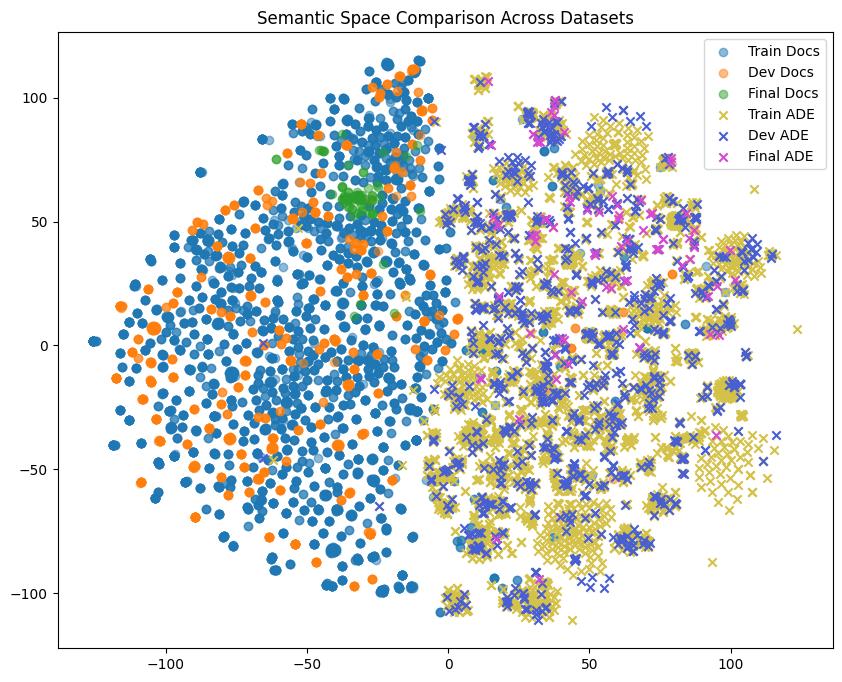

In [ ]:
from sentence_transformers import SentenceTransformer
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import numpy as np

# Load an embedding model
model = SentenceTransformer("sentence-transformers/all-mpnet-base-v2")


# Compute embeddings
train_doc_emb = model.encode(train_docs)
train_ade_emb = model.encode(train_ade)

dev_doc_emb = model.encode(dev_docs)
dev_ade_emb = model.encode(dev_ade)

final_doc_emb = model.encode(final_docs)
final_ade_emb = model.encode(final_ade)

# Combine all for visualization
all_emb = np.vstack([
    train_doc_emb, dev_doc_emb, final_doc_emb,
    train_ade_emb, dev_ade_emb, final_ade_emb
])

# 2D projection for visualization
tsne = TSNE(n_components=2, perplexity=30)
coords = tsne.fit_transform(all_emb)

# Split coords
n1, n2, n3 = len(train_docs), len(dev_docs), len(final_docs)
n4, n5, n6 = len(train_ade), len(dev_ade), len(final_ade)

train_doc_c = coords[:n1]
dev_doc_c = coords[n1:n1+n2]
final_doc_c = coords[n1+n2:n1+n2+n3]

train_ade_c = coords[n1+n2+n3:n1+n2+n3+n4]
dev_ade_c = coords[n1+n2+n3+n4:n1+n2+n3+n4+n5]
final_ade_c = coords[n1+n2+n3+n4+n5:]

# Plot
plt.figure(figsize=(10, 8))
plt.scatter(train_doc_c[:,0], train_doc_c[:,1], label="Train Docs", alpha=0.5)
plt.scatter(dev_doc_c[:,0], dev_doc_c[:,1], label="Dev Docs", alpha=0.5)
plt.scatter(final_doc_c[:,0], final_doc_c[:,1], label="Final Docs", alpha=0.5)

plt.scatter(train_ade_c[:,0], train_ade_c[:,1], label="Train ADE", c='#d4c148', marker='x')
plt.scatter(dev_ade_c[:,0], dev_ade_c[:,1], label="Dev ADE", c='#485fd4', marker='x')
plt.scatter(final_ade_c[:,0], final_ade_c[:,1], label="Final ADE", c='#d448d4', marker='x')

plt.legend()
plt.title("Semantic Space Comparison Across Datasets")



plt.savefig("Semantic_Space_Comparison_Across_Datasets.png", dpi=300, bbox_inches='tight')
plt.show()
plt.close()

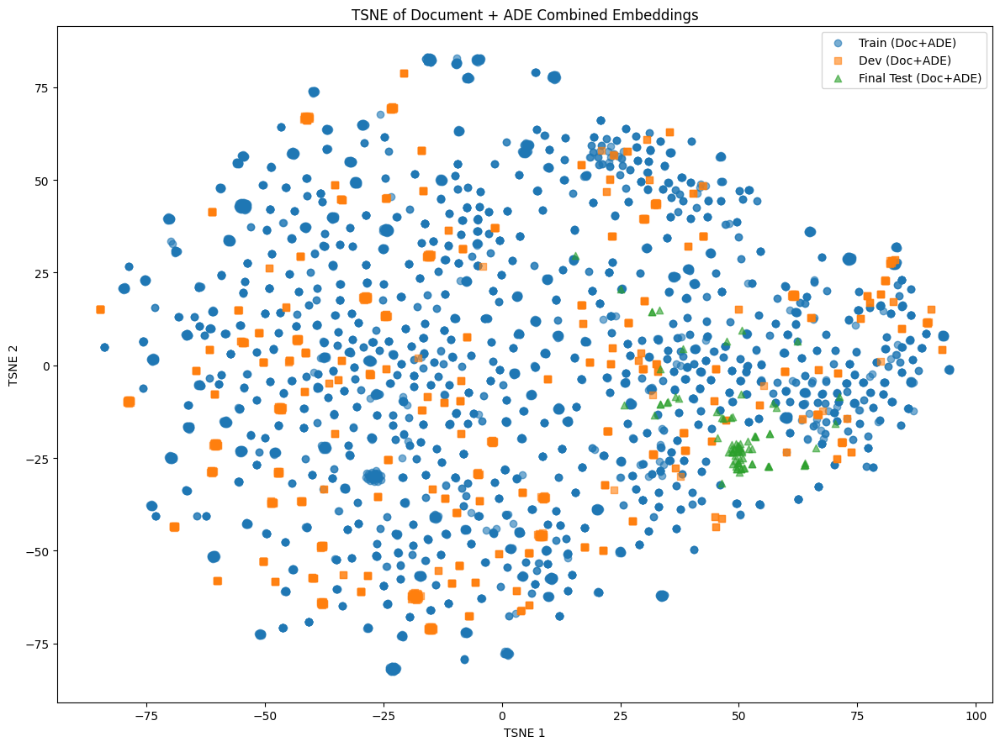

In [ ]:
from sentence_transformers import SentenceTransformer
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import numpy as np

# Load embedding model
model = SentenceTransformer("sentence-transformers/all-mpnet-base-v2")

# ---------------------------------------------------
# 1️⃣ Combine document + ADE phrase for each sample
# ---------------------------------------------------
train_combined = [doc + " " + ade for doc, ade in zip(train_docs, train_ade)]
dev_combined   = [doc + " " + ade for doc, ade in zip(dev_docs, dev_ade)]
final_combined = [doc + " " + ade for doc, ade in zip(final_docs, final_ade)]

# ---------------------------------------------------
# 2️⃣ Compute embeddings
# ---------------------------------------------------
train_emb = model.encode(train_combined)
dev_emb   = model.encode(dev_combined)
final_emb = model.encode(final_combined)

# ---------------------------------------------------
# 3️⃣ TSNE projection
# ---------------------------------------------------
all_emb = np.vstack([train_emb, dev_emb, final_emb])
tsne = TSNE(n_components=2, perplexity=30, random_state=42)
coords = tsne.fit_transform(all_emb)

n_train = len(train_combined)
n_dev   = len(dev_combined)
n_final = len(final_combined)

train_c = coords[:n_train]
dev_c   = coords[n_train:n_train+n_dev]
final_c = coords[n_train+n_dev:]

# ---------------------------------------------------
# 4️⃣ Plot
# ---------------------------------------------------
plt.figure(figsize=(12, 9))

plt.scatter(train_c[:,0], train_c[:,1], label="Train (Doc+ADE)", c="#1f77b4", alpha=0.6, marker='o')
plt.scatter(dev_c[:,0], dev_c[:,1], label="Dev (Doc+ADE)", c="#ff7f0e", alpha=0.6, marker='s')
plt.scatter(final_c[:,0], final_c[:,1], label="Final Test (Doc+ADE)", c="#2ca02c", alpha=0.6, marker='^')

plt.legend()
plt.title("TSNE of Document + ADE Combined Embeddings")
plt.xlabel("TSNE 1")
plt.ylabel("TSNE 2")
plt.tight_layout()
plt.savefig("TSNE_Doc_ADE_Combined.png", dpi=300, bbox_inches='tight')
plt.show()
plt.close()


## Compare ADE–Document Relationship Using Semantic Similarity

/tmp/ipython-input-3674036633.py:13: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([train_sims, dev_sims, final_sims], labels=["Train", "Dev", "Final"])


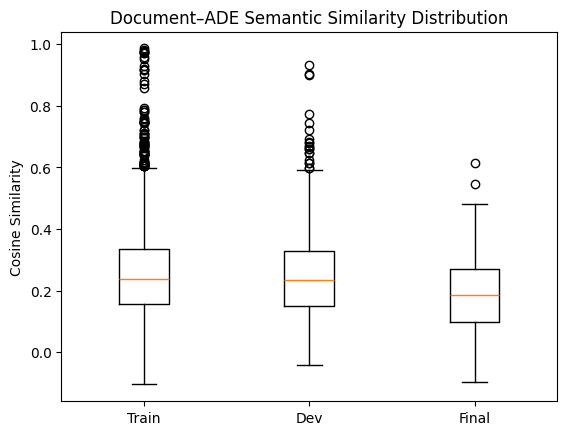

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity

def compute_pairs(doc_emb, ade_emb):
    sims = []
    for d, a in zip(doc_emb, ade_emb):
        sims.append(cosine_similarity([d], [a])[0][0])
    return sims

train_sims = compute_pairs(train_doc_emb, train_ade_emb)
dev_sims = compute_pairs(dev_doc_emb, dev_ade_emb)
final_sims = compute_pairs(final_doc_emb, final_ade_emb)

plt.boxplot([train_sims, dev_sims, final_sims], labels=["Train", "Dev", "Final"])
plt.title("Document–ADE Semantic Similarity Distribution")
plt.ylabel("Cosine Similarity")

plt.savefig("Document–ADE_Semantic_Similarity_Distribution.png", dpi=300, bbox_inches='tight')
plt.show()
plt.close()

## Vocabulary Drift / Token Distribution Shift

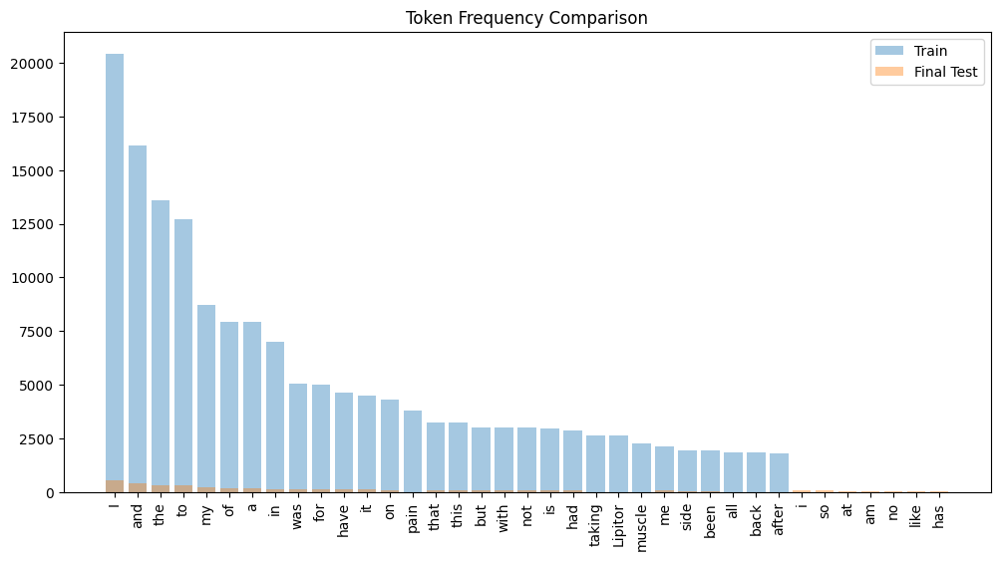

In [ ]:
from collections import Counter
import matplotlib.pyplot as plt

def top_tokens(texts, topn=30):
    c = Counter(" ".join(texts).split())
    return c.most_common(topn)

train_tok = dict(top_tokens(train_docs))
dev_tok = dict(top_tokens(dev_docs))
final_tok = dict(top_tokens(final_docs))

plt.figure(figsize=(12,6))
plt.bar(train_tok.keys(), train_tok.values(), alpha=0.4, label="Train")
plt.bar(final_tok.keys(), final_tok.values(), alpha=0.4, label="Final Test")
plt.xticks(rotation=90)
plt.title("Token Frequency Comparison")
plt.legend()



plt.savefig("Token_Frequency_Comparison.png", dpi=300, bbox_inches='tight')
plt.show()
plt.close()

## extra code

In [ ]:
import nltk
nltk.download('all')

[nltk_data] Downloading collection 'all'
[nltk_data]    | 
[nltk_data]    | Downloading package abc to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/abc.zip.
[nltk_data]    | Downloading package alpino to /root/nltk_data...
[nltk_data]    |   Unzipping corpora/alpino.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger_eng to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping
[nltk_data]    |       taggers/averaged_perceptron_tagger_eng.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger_ru to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |   Unzipping
[nltk_data]    |       taggers/averaged_perceptron_tagger_ru.zip.
[nltk_data]    | Downloading package averaged_perceptron_tagger_rus to
[nltk_data]    |     /root/nltk_data...
[nltk_data]    |  

True

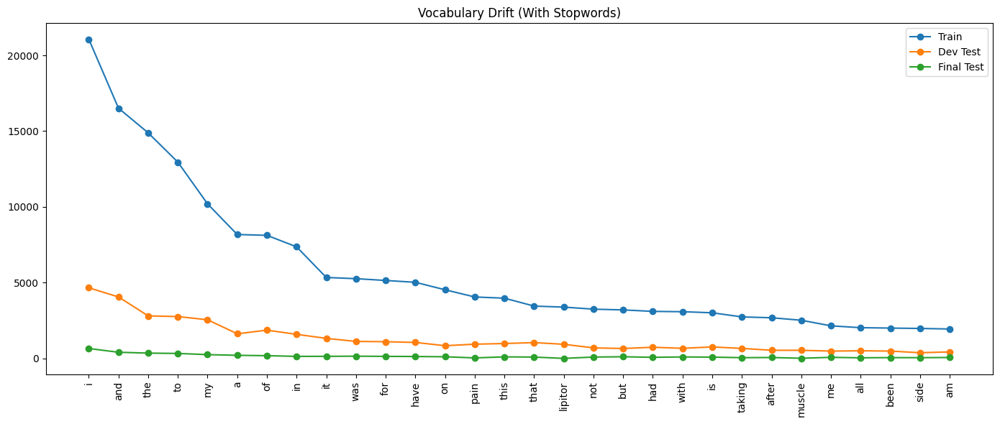

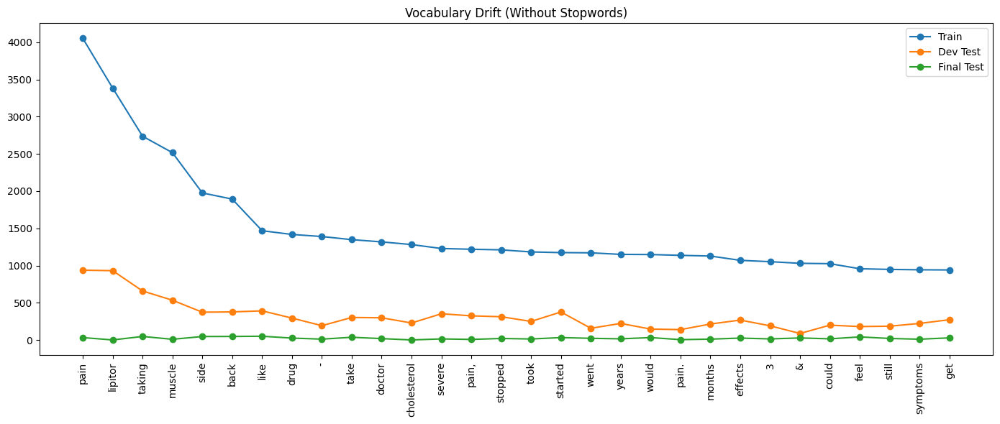

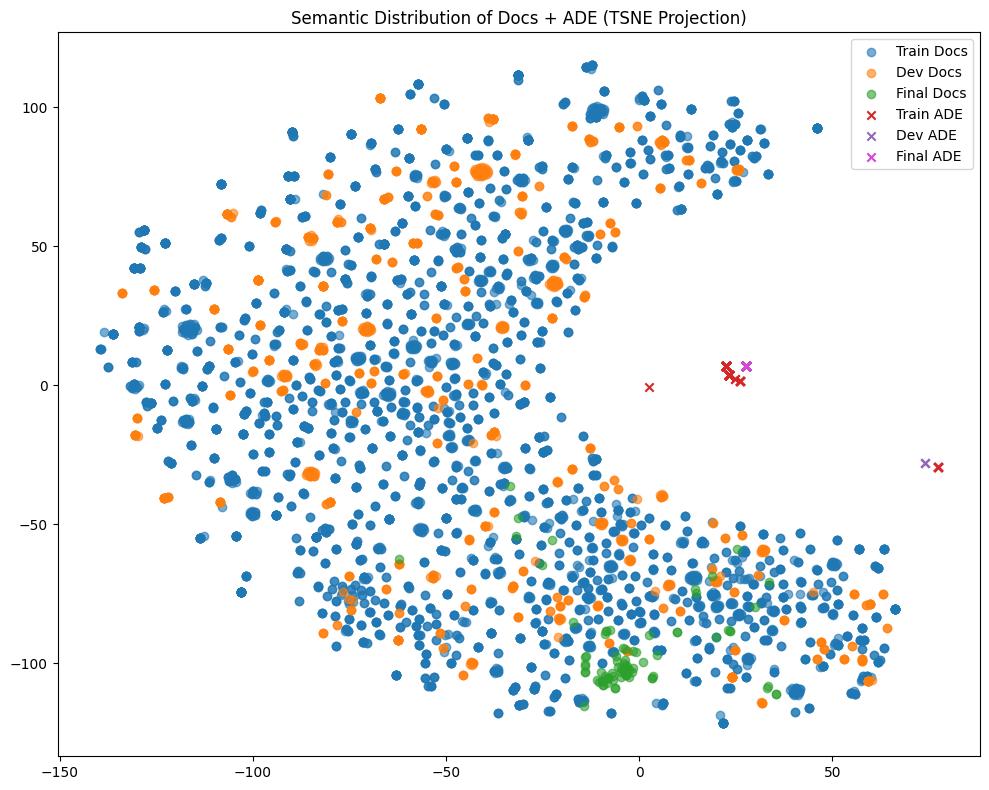

In [ ]:
import json
import matplotlib.pyplot as plt
from collections import Counter
from nltk.corpus import stopwords
import numpy as np
from sentence_transformers import SentenceTransformer
from sklearn.manifold import TSNE

# ----------------------------------------------------------
# Loading JSONL
# ----------------------------------------------------------
def load_jsonl(path):
    docs, ades = [], []
    with open(path, "r", encoding="utf-8") as f:
        for line in f:
            if line.strip():
                item = json.loads(line)
                docs.append(item.get("document", ""))
                ades.append(item.get("ade", ""))
    return docs, ades

train_docs, train_ade = load_jsonl("output_train.json")
dev_docs, dev_ade     = load_jsonl("output_test_1.json")
final_docs, final_ade = load_jsonl("output_test_2.json")

# ----------------------------------------------------------
# 1. VOCABULARY DRIFT
# ----------------------------------------------------------
stop_words = set(stopwords.words("english"))

def get_token_counts(texts, remove_stopwords=False):
    tokens = []
    for text in texts:
        t = text.lower().split()
        if remove_stopwords:
            t = [w for w in t if w not in stop_words]
        tokens.extend(t)
    return Counter(tokens)

# -------- A: Without removing stopwords --------
train_tok = get_token_counts(train_docs, remove_stopwords=False)
dev_tok   = get_token_counts(dev_docs, remove_stopwords=False)
final_tok = get_token_counts(final_docs, remove_stopwords=False)

# Select common top tokens from TRAIN
top_tokens = [w for w, _ in train_tok.most_common(30)]

def extract_counts(counter, vocab):
    return [counter.get(w, 0) for w in vocab]

train_freq = extract_counts(train_tok, top_tokens)
dev_freq   = extract_counts(dev_tok, top_tokens)
final_freq = extract_counts(final_tok, top_tokens)

# PLOT A
plt.figure(figsize=(14, 6))
plt.plot(top_tokens, train_freq, label="Train", marker='o')
plt.plot(top_tokens, dev_freq, label="Dev Test", marker='o')
plt.plot(top_tokens, final_freq, label="Final Test", marker='o')
plt.xticks(rotation=90)
plt.title("Vocabulary Drift (With Stopwords)")
plt.legend()
plt.tight_layout()
plt.savefig("vocab_drift_with_stopwords.png", dpi=300)
plt.show()
plt.close()


# -------- B: Removing stopwords --------
train_tok_ns = get_token_counts(train_docs, remove_stopwords=True)
dev_tok_ns   = get_token_counts(dev_docs, remove_stopwords=True)
final_tok_ns = get_token_counts(final_docs, remove_stopwords=True)

top_tokens_ns = [w for w, _ in train_tok_ns.most_common(30)]

train_freq_ns = extract_counts(train_tok_ns, top_tokens_ns)
dev_freq_ns   = extract_counts(dev_tok_ns, top_tokens_ns)
final_freq_ns = extract_counts(final_tok_ns, top_tokens_ns)

plt.figure(figsize=(14, 6))
plt.plot(top_tokens_ns, train_freq_ns, label="Train", marker='o')
plt.plot(top_tokens_ns, dev_freq_ns, label="Dev Test", marker='o')
plt.plot(top_tokens_ns, final_freq_ns, label="Final Test", marker='o')
plt.xticks(rotation=90)
plt.title("Vocabulary Drift (Without Stopwords)")
plt.legend()
plt.tight_layout()
plt.savefig("vocab_drift_no_stopwords.png", dpi=300)
plt.show()
plt.close()



# ----------------------------------------------------------
# 2. SCATTER PLOT — EMBEDDING SEMANTIC SPACE
# ----------------------------------------------------------
model = SentenceTransformer("sentence-transformers/all-mpnet-base-v2")

train_doc_emb  = model.encode(train_docs)
dev_doc_emb    = model.encode(dev_docs)
final_doc_emb  = model.encode(final_docs)

train_ade_emb  = model.encode(train_ade)
dev_ade_emb    = model.encode(dev_ade)
final_ade_emb  = model.encode(final_ade)

all_emb = np.vstack([
    train_doc_emb, dev_doc_emb, final_doc_emb,
    train_ade_emb, dev_ade_emb, final_ade_emb
])

tsne = TSNE(n_components=2, perplexity=30)
coords = tsne.fit_transform(all_emb)

# Split coordinates
n1, n2, n3 = len(train_docs), len(dev_docs), len(final_docs)
n4, n5, n6 = len(train_ade), len(dev_ade), len(final_ade)

train_doc_c = coords[:n1]
dev_doc_c   = coords[n1:n1+n2]
final_doc_c = coords[n1+n2:n1+n2+n3]

train_ade_c = coords[n1+n2+n3:n1+n2+n3+n4]
dev_ade_c   = coords[n1+n2+n3+n4:n1+n2+n3+n4+n5]
final_ade_c = coords[n1+n2+n3+n4+n5:]

plt.figure(figsize=(10, 8))

# Distinguishable colors
plt.scatter(train_doc_c[:,0], train_doc_c[:,1], label="Train Docs", c="#1f77b4", alpha=0.6)
plt.scatter(dev_doc_c[:,0], dev_doc_c[:,1], label="Dev Docs", c="#ff7f0e", alpha=0.6)
plt.scatter(final_doc_c[:,0], final_doc_c[:,1], label="Final Docs", c="#2ca02c", alpha=0.6)

plt.scatter(train_ade_c[:,0], train_ade_c[:,1], label="Train ADE", c="#d62728", marker='x')
plt.scatter(dev_ade_c[:,0], dev_ade_c[:,1], label="Dev ADE", c="#9467bd", marker='x')
plt.scatter(final_ade_c[:,0], final_ade_c[:,1], label="Final ADE", c="#d448d4", marker='x')

plt.title("Semantic Distribution of Docs + ADE (TSNE Projection)")
plt.legend()
plt.tight_layout()
plt.savefig("semantic_scatter_plot.png", dpi=300)
plt.show()
plt.close()


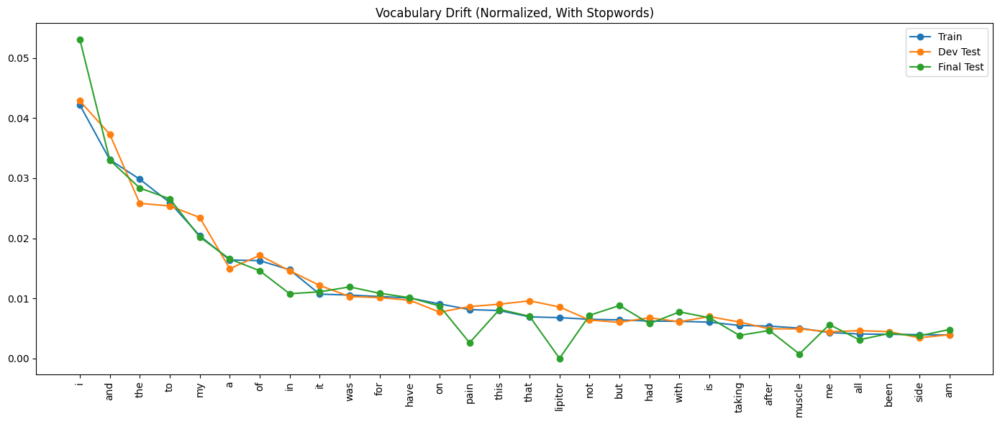

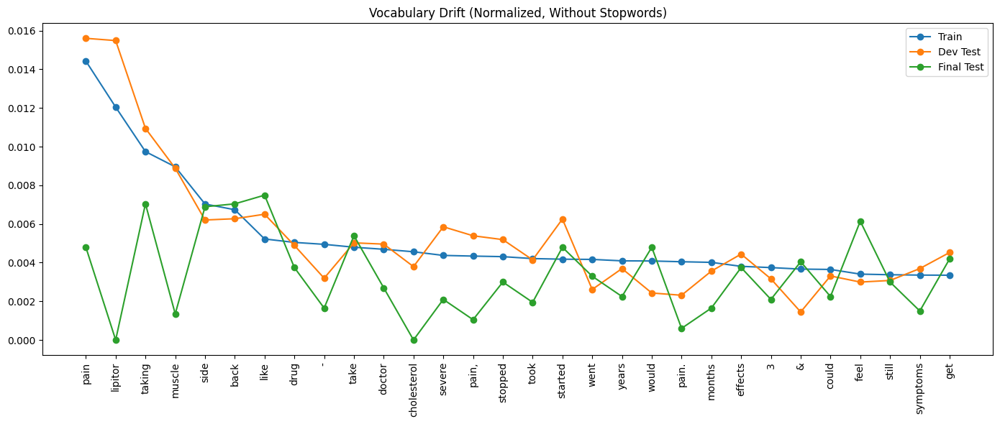

In [ ]:
def normalize(counter, vocab):
    total = sum(counter.values())
    if total == 0:
        return [0 for _ in vocab]
    return [counter.get(w, 0) / total for w in vocab]



# ----------- A: With stopwords -----------
train_tok = get_token_counts(train_docs, remove_stopwords=False)
dev_tok   = get_token_counts(dev_docs, remove_stopwords=False)
final_tok = get_token_counts(final_docs, remove_stopwords=False)

top_tokens = [w for w, _ in train_tok.most_common(30)]

# normalization function
def normalize(counter, vocab):
    total = sum(counter.values())
    if total == 0:
        return [0 for _ in vocab]
    return [counter.get(w, 0) / total for w in vocab]

train_freq = normalize(train_tok, top_tokens)
dev_freq   = normalize(dev_tok, top_tokens)
final_freq = normalize(final_tok, top_tokens)

plt.figure(figsize=(14, 6))
plt.plot(top_tokens, train_freq, label="Train", marker='o')
plt.plot(top_tokens, dev_freq, label="Dev Test", marker='o')
plt.plot(top_tokens, final_freq, label="Final Test", marker='o')
plt.xticks(rotation=90)
plt.title("Vocabulary Drift (Normalized, With Stopwords)")
plt.legend()
plt.tight_layout()
plt.savefig("vocab_drift_with_stopwords_normalized.png", dpi=300)
plt.show()
plt.close()



# ----------- B: Without stopwords -----------
train_tok_ns = get_token_counts(train_docs, remove_stopwords=True)
dev_tok_ns   = get_token_counts(dev_docs, remove_stopwords=True)
final_tok_ns = get_token_counts(final_docs, remove_stopwords=True)

top_tokens_ns = [w for w, _ in train_tok_ns.most_common(30)]

train_freq_ns = normalize(train_tok_ns, top_tokens_ns)
dev_freq_ns   = normalize(dev_tok_ns, top_tokens_ns)
final_freq_ns = normalize(final_tok_ns, top_tokens_ns)

plt.figure(figsize=(14, 6))
plt.plot(top_tokens_ns, train_freq_ns, label="Train", marker='o')
plt.plot(top_tokens_ns, dev_freq_ns, label="Dev Test", marker='o')
plt.plot(top_tokens_ns, final_freq_ns, label="Final Test", marker='o')
plt.xticks(rotation=90)
plt.title("Vocabulary Drift (Normalized, Without Stopwords)")
plt.legend()
plt.tight_layout()
plt.savefig("vocab_drift_no_stopwords_normalized.png", dpi=300)
plt.show()
plt.close()


## extra

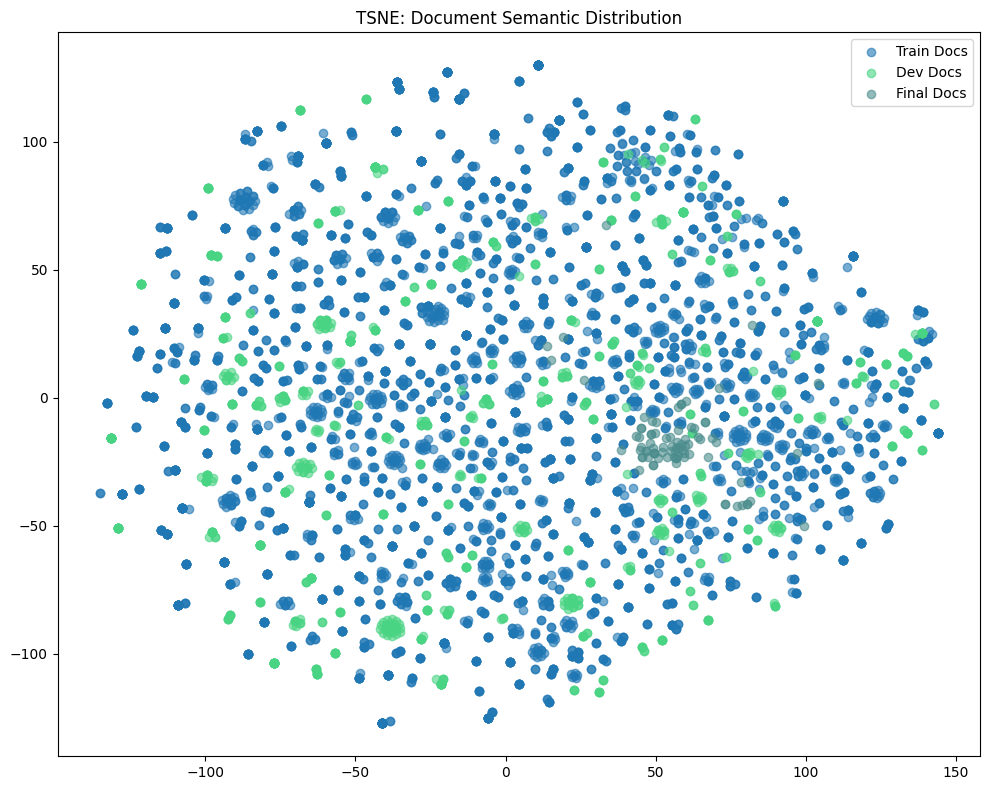

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sentence_transformers import SentenceTransformer

# ----------------------------------------------------------
# Compute embeddings
# ----------------------------------------------------------
model = SentenceTransformer("sentence-transformers/all-mpnet-base-v2")

train_doc_emb  = model.encode(train_docs)
dev_doc_emb    = model.encode(dev_docs)
final_doc_emb  = model.encode(final_docs)

train_ade_emb  = model.encode(train_ade)
dev_ade_emb    = model.encode(dev_ade)
final_ade_emb  = model.encode(final_ade)


# ----------------------------------------------------------
# 1️⃣ TSNE for DOCUMENTS ONLY
# ----------------------------------------------------------
all_docs = np.vstack([train_doc_emb, dev_doc_emb, final_doc_emb])

tsne_docs = TSNE(n_components=2, perplexity=30)
coords_docs = tsne_docs.fit_transform(all_docs)

n1, n2, n3 = len(train_doc_emb), len(dev_doc_emb), len(final_doc_emb)

train_doc_c  = coords_docs[:n1]
dev_doc_c    = coords_docs[n1:n1+n2]
final_doc_c  = coords_docs[n1+n2:]

plt.figure(figsize=(10, 8))

plt.scatter(train_doc_c[:,0], train_doc_c[:,1],
            label="Train Docs", c="#1f77b4", alpha=0.6)
plt.scatter(dev_doc_c[:,0], dev_doc_c[:,1],
            label="Dev Docs", c="#48d482", alpha=0.6)
plt.scatter(final_doc_c[:,0], final_doc_c[:,1],
            label="Final Docs", c="#4b8c8c", alpha=0.6)

plt.legend()
plt.title("TSNE: Document Semantic Distribution")
plt.tight_layout()
plt.savefig("tsne_docs.png", dpi=300)
plt.show()
plt.close()




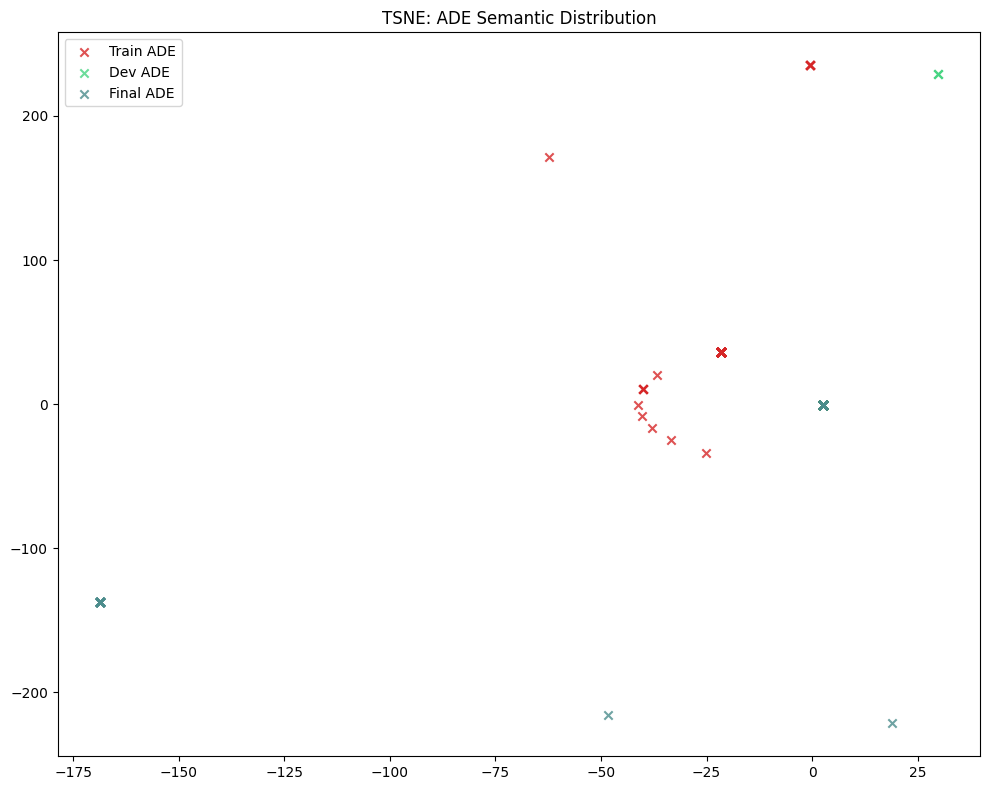

In [ ]:

# ----------------------------------------------------------
# 2️⃣ TSNE for ADE PHRASES ONLY
# ----------------------------------------------------------
all_ade = np.vstack([train_ade_emb, dev_ade_emb, final_ade_emb])

tsne_ade = TSNE(n_components=2, perplexity=30)
coords_ade = tsne_ade.fit_transform(all_ade)

nA1, nA2, nA3 = len(train_ade_emb), len(dev_ade_emb), len(final_ade_emb)

train_ade_c  = coords_ade[:nA1]
dev_ade_c    = coords_ade[nA1:nA1+nA2]
final_ade_c  = coords_ade[nA1+nA2:]

plt.figure(figsize=(10, 8))

plt.scatter(train_ade_c[:,0], train_ade_c[:,1],
            label="Train ADE", c="#d62728", alpha=0.8, marker='x')
plt.scatter(dev_ade_c[:,0], dev_ade_c[:,1],
            label="Dev ADE", c="#48d482", alpha=0.8, marker='x')
plt.scatter(final_ade_c[:,0], final_ade_c[:,1],
            label="Final ADE", c="#4b8c8c", alpha=0.8, marker='x')

plt.legend()
plt.title("TSNE: ADE Semantic Distribution")
plt.tight_layout()
plt.savefig("tsne_ade.png", dpi=300)
plt.show()
plt.close()

=== ADE STRING UNIQUENESS ===
Train: total = 4200  unique = 1
Dev: total = 931  unique = 1
Final: total = 83  unique = 1


modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md: 0.00B [00:00, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

Batches:   0%|          | 0/132 [00:00<?, ?it/s]

Batches:   0%|          | 0/30 [00:00<?, ?it/s]

Batches:   0%|          | 0/3 [00:00<?, ?it/s]


=== UNIQUE EMBEDDING VECTORS ===
Train: 1
Dev: 1
Final: 1


/usr/local/lib/python3.12/dist-packages/sklearn/base.py:1389: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  return fit_method(estimator, *args, **kwargs)


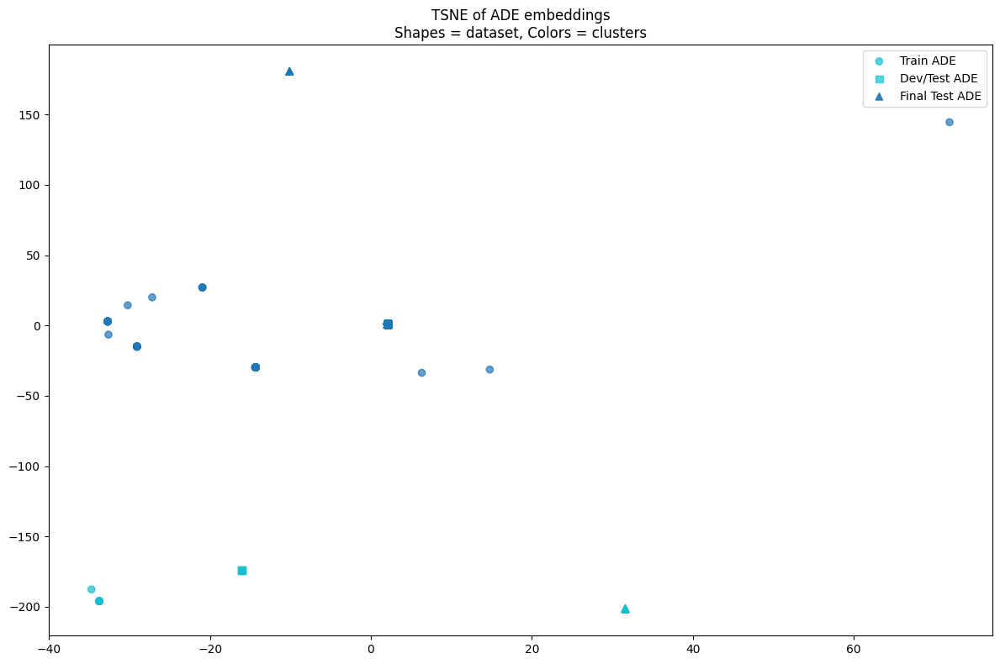

In [ ]:
import json
import numpy as np
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from sentence_transformers import SentenceTransformer
from collections import Counter

# ---------------------------
# 1. Load JSON lines
# ---------------------------

def load_jsonl(path):
    docs, ades = [], []
    with open(path, "r", encoding="utf-8") as f:
        for line in f:
            obj = json.loads(line)
            docs.append(obj.get("document", ""))
            ades.append(obj.get("ade", ""))
    return docs, ades

train_docs, train_ade = load_jsonl("output_train.json")
dev_docs, dev_ade = load_jsonl("output_test_1.json")
final_docs, final_ade = load_jsonl("output_test_2.json")

# ---------------------------
# 2. ADE uniqueness checks
# ---------------------------

print("=== ADE STRING UNIQUENESS ===")
print("Train: total =", len(train_ade), " unique =", len(set(train_ade)))
print("Dev: total =", len(dev_ade), " unique =", len(set(dev_ade)))
print("Final: total =", len(final_ade), " unique =", len(set(final_ade)))

# ---------------------------
# 3. Compute embeddings
# ---------------------------

model = SentenceTransformer("all-MiniLM-L6-v2")

train_emb = model.encode(train_ade, show_progress_bar=True)
dev_emb = model.encode(dev_ade, show_progress_bar=True)
final_emb = model.encode(final_ade, show_progress_bar=True)

# ---------------------------
# 4. Check unique embedding vectors
# ---------------------------

def count_unique_vecs(x):
    rounded = np.round(x, 3)
    unique = np.unique(rounded, axis=0)
    return unique.shape[0]

print("\n=== UNIQUE EMBEDDING VECTORS ===")
print("Train:", count_unique_vecs(train_emb))
print("Dev:", count_unique_vecs(dev_emb))
print("Final:", count_unique_vecs(final_emb))

# ---------------------------
# 5. Combine all ADE vectors for clustering
# ---------------------------

all_emb = np.vstack([train_emb, dev_emb, final_emb])
all_ade = train_ade + dev_ade + final_ade

# Choose number of clusters (you may tune)
K = 10
kmeans = KMeans(n_clusters=K, random_state=42)
cluster_ids = kmeans.fit_predict(all_emb)

# Split cluster labels back into sets
train_cluster = cluster_ids[:len(train_emb)]
dev_cluster = cluster_ids[len(train_emb):len(train_emb)+len(dev_emb)]
final_cluster = cluster_ids[len(train_emb)+len(dev_emb):]

# ---------------------------
# 6. TSNE for visualization
# ---------------------------

tsne = TSNE(n_components=2, perplexity=30, random_state=42, init="pca")
all_tsne = tsne.fit_transform(all_emb)

train_tsne = all_tsne[:len(train_emb)]
dev_tsne = all_tsne[len(train_emb):len(train_emb)+len(dev_emb)]
final_tsne = all_tsne[len(train_emb)+len(dev_emb):]

# ---------------------------
# 7. Plot
# ---------------------------

plt.figure(figsize=(12, 8))

# Marker shapes
markers = {
    "train": "o",  # circle
    "dev": "s",    # square
    "final": "^"   # triangle
}

# --- Train
plt.scatter(
    train_tsne[:, 0],
    train_tsne[:, 1],
    c=train_cluster,
    cmap="tab10",
    marker=markers["train"],
    alpha=0.7,
    label="Train ADE"
)

# --- Dev
plt.scatter(
    dev_tsne[:, 0],
    dev_tsne[:, 1],
    c=dev_cluster,
    cmap="tab10",
    marker=markers["dev"],
    alpha=0.7,
    label="Dev/Test ADE"
)

# --- Final
plt.scatter(
    final_tsne[:, 0],
    final_tsne[:, 1],
    c=final_cluster,
    cmap="tab10",
    marker=markers["final"],
    alpha=0.9,
    label="Final Test ADE"
)

plt.legend()
plt.title("TSNE of ADE embeddings\nShapes = dataset, Colors = clusters")
plt.tight_layout()
plt.savefig("ade_tsne_clusters.png", dpi=300)
plt.show()


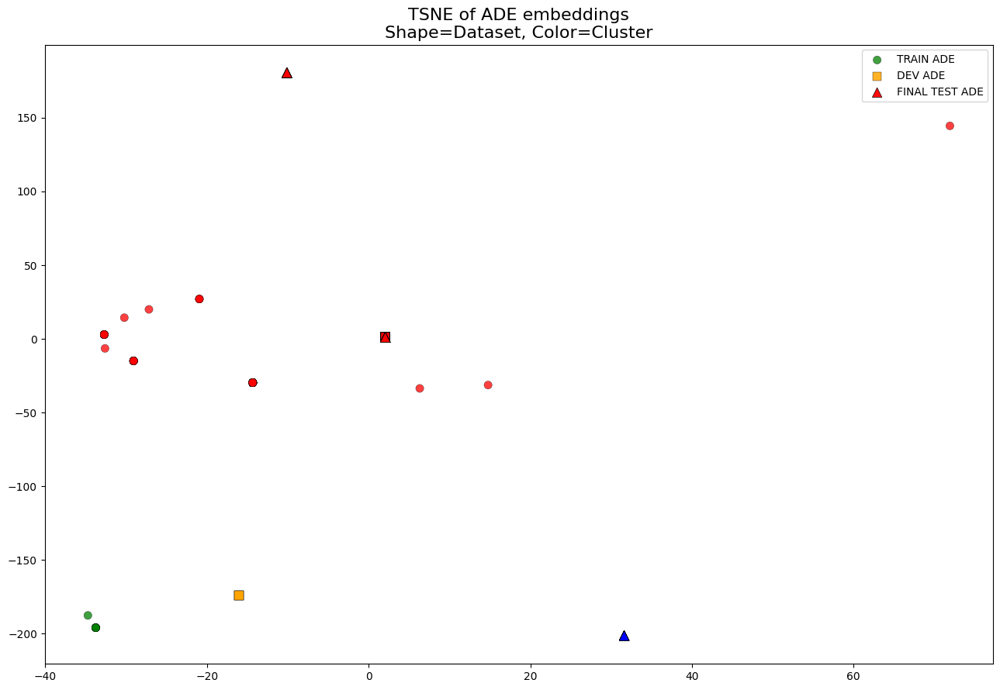

In [ ]:
from matplotlib.colors import to_rgb
import random

# ---------------------------------------------------
#  Create a large, very distinguishable color palette
# ---------------------------------------------------
base_colors = [
    "red", "blue", "green", "orange", "purple", "brown",
    "pink", "gray", "olive", "cyan", "magenta", "gold",
    "navy", "lime", "coral", "teal", "maroon", "violet",
    "turquoise", "darkgreen"
]

# If clusters > colors, expand automatically:
while len(base_colors) < K:
    # generate random but bright colors
    base_colors.append(
        (random.random()*0.7+0.3, random.random()*0.7+0.3, random.random()*0.7+0.3)
    )

cluster_colors = [base_colors[c % len(base_colors)] for c in range(K)]

# Marker shapes
markers = {
    "train": "o",       # circle
    "dev": "s",         # square
    "final": "^"        # triangle
}

plt.figure(figsize=(13, 9))

# ------------------------------
# PLOT TRAIN
# ------------------------------
plt.scatter(
    train_tsne[:, 0],
    train_tsne[:, 1],
    c=[cluster_colors[c] for c in train_cluster],
    marker=markers["train"],
    edgecolor="black",
    linewidth=0.3,
    s=55,
    alpha=0.75,
    label="TRAIN ADE"
)

# ------------------------------
# PLOT DEV
# ------------------------------
plt.scatter(
    dev_tsne[:, 0],
    dev_tsne[:, 1],
    c=[cluster_colors[c] for c in dev_cluster],
    marker=markers["dev"],
    edgecolor="black",
    linewidth=0.3,
    s=65,
    alpha=0.85,
    label="DEV ADE"
)

# ------------------------------
# PLOT FINAL TEST
# ------------------------------
plt.scatter(
    final_tsne[:, 0],
    final_tsne[:, 1],
    c=[cluster_colors[c] for c in final_cluster],
    marker=markers["final"],
    edgecolor="black",
    linewidth=0.5,
    s=80,
    alpha=0.95,
    label="FINAL TEST ADE"
)

plt.title("TSNE of ADE embeddings\nShape=Dataset, Color=Cluster", fontsize=16)
plt.legend()
plt.tight_layout()
plt.savefig("ade_tsne_clusters_distinct_colors.png", dpi=350)
plt.show()
plt.close()

In [ ]:
from openpyxl import Workbook

# ------------------------------
# Create Excel workbook
# ------------------------------
wb = Workbook()
ws = wb.active
ws.title = "ADE_Clusters"

# Header row
headers = ["ade_text", "dataset", "cluster_id", "tsne_x", "tsne_y", "color"]
ws.append(headers)

# Helper function to add rows
def add_ade_rows(ade_list, tsne_coords, cluster_list, color_list, dataset_name):
    for ade, coord, cluster_id, color in zip(ade_list, tsne_coords, cluster_list, color_list):
        ws.append([ade, dataset_name, cluster_id, float(coord[0]), float(coord[1]), str(color)])

# ------------------------------
# Add data for each dataset
# ------------------------------
add_ade_rows(train_ade, train_tsne, train_cluster, [cluster_colors[c] for c in train_cluster], "train")
add_ade_rows(dev_ade, dev_tsne, dev_cluster, [cluster_colors[c] for c in dev_cluster], "dev")
add_ade_rows(final_ade, final_tsne, final_cluster, [cluster_colors[c] for c in final_cluster], "final")

# ------------------------------
# Save Excel file
# ------------------------------
xlsx_path = "ade_tsne_clusters.xlsx"
wb.save(xlsx_path)
print(f"Excel file saved at: {xlsx_path}")


Excel file saved at: ade_tsne_clusters.xlsx


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md: 0.00B [00:00, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/571 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/438M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/363 [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/239 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

Batches:   0%|          | 0/132 [00:00<?, ?it/s]

Batches:   0%|          | 0/30 [00:00<?, ?it/s]

Batches:   0%|          | 0/3 [00:00<?, ?it/s]

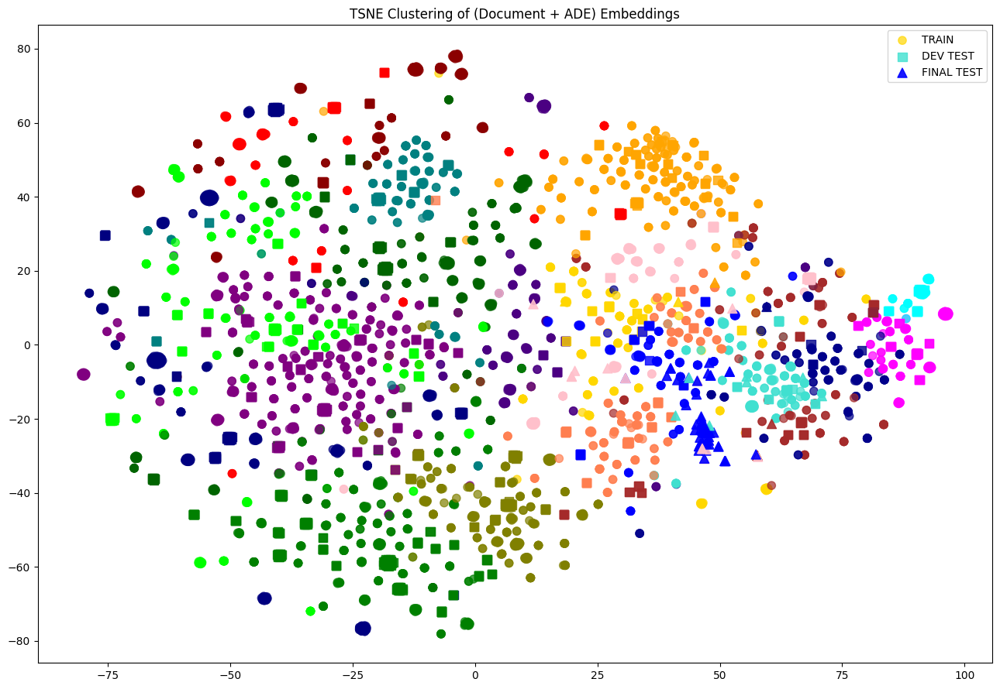

Excel file saved as: Doc_ADE_Cluster_Map.xlsx


In [ ]:
import numpy as np
from sentence_transformers import SentenceTransformer
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from openpyxl import Workbook
import matplotlib.pyplot as plt
import random

# ============================================================
# 1️⃣ Combine DOCUMENT + ADE for all sets
# ============================================================

train_combined = [d + " [ADE] " + a for d, a in zip(train_docs, train_ade)]
dev_combined   = [d + " [ADE] " + a for d, a in zip(dev_docs, dev_ade)]
final_combined = [d + " [ADE] " + a for d, a in zip(final_docs, final_ade)]

# ============================================================
# 2️⃣ Embeddings
# ============================================================

model = SentenceTransformer("sentence-transformers/all-mpnet-base-v2")

train_emb = model.encode(train_combined, show_progress_bar=True)
dev_emb   = model.encode(dev_combined,   show_progress_bar=True)
final_emb = model.encode(final_combined, show_progress_bar=True)

# Combine embeddings
all_emb = np.vstack([train_emb, dev_emb, final_emb])

# ============================================================
# 3️⃣ K-Means clustering
# ============================================================

K = 20   # you can tune this
kmeans = KMeans(n_clusters=K, random_state=42)
cluster_ids = kmeans.fit_predict(all_emb)

n_train = len(train_emb)
n_dev = len(dev_emb)
n_final = len(final_emb)

train_cluster = cluster_ids[:n_train]
dev_cluster = cluster_ids[n_train:n_train+n_dev]
final_cluster = cluster_ids[n_train+n_dev:]

# ============================================================
# 4️⃣ Generate DISTINCT colors for clusters
# ============================================================

base_colors = [
    "red","blue","green","orange","purple","cyan","magenta","lime",
    "navy","brown","pink","teal","olive","coral","gold","darkgreen",
    "darkred","darkblue","indigo","turquoise"
]

while len(base_colors) < K:
    base_colors.append(
        (random.random()*0.6+0.3, random.random()*0.6+0.3, random.random()*0.6+0.3)
    )

cluster_colors = [base_colors[c % len(base_colors)] for c in range(K)]

# ============================================================
# 5️⃣ TSNE Projection
# ============================================================

tsne = TSNE(n_components=2, perplexity=35, random_state=42)
coords = tsne.fit_transform(all_emb)

train_tsne = coords[:n_train]
dev_tsne = coords[n_train:n_train+n_dev]
final_tsne = coords[n_train+n_dev:]

# ============================================================
# 6️⃣ Plot TSNE
# ============================================================

plt.figure(figsize=(13, 9))

# Train
plt.scatter(
    train_tsne[:,0], train_tsne[:,1],
    c=[cluster_colors[c] for c in train_cluster],
    marker="o", alpha=0.7, s=55, label="TRAIN"
)

# Dev (Validation test)
plt.scatter(
    dev_tsne[:,0], dev_tsne[:,1],
    c=[cluster_colors[c] for c in dev_cluster],
    marker="s", alpha=0.8, s=65, label="DEV TEST"
)

# Final Test
plt.scatter(
    final_tsne[:,0], final_tsne[:,1],
    c=[cluster_colors[c] for c in final_cluster],
    marker="^", alpha=0.9, s=75, label="FINAL TEST"
)

plt.legend()
plt.title("TSNE Clustering of (Document + ADE) Embeddings")
plt.tight_layout()
plt.savefig("TSNE_Doc_ADE_Clusters.png", dpi=300)
plt.show()
plt.close()

# ============================================================
# 7️⃣ Excel Output
# ============================================================

wb = Workbook()
ws = wb.active
ws.title = "Doc_ADE_Clusters"

ws.append(["doc+ade", "dataset", "cluster_id", "tsne_x", "tsne_y", "color"])

def add_rows(texts, tsne_coords, clusters, dataset_name):
    for t, coord, cid in zip(texts, tsne_coords, clusters):
        ws.append([t, dataset_name, cid, float(coord[0]), float(coord[1]), str(cluster_colors[cid])])

add_rows(train_combined, train_tsne, train_cluster, "train")
add_rows(dev_combined, dev_tsne, dev_cluster, "dev")
add_rows(final_combined, final_tsne, final_cluster, "final")

wb.save("Doc_ADE_Cluster_Map.xlsx")
print("Excel file saved as: Doc_ADE_Cluster_Map.xlsx")
